In [1]:
import numpy as np
import h5py

#f = h5py.File("/oak/stanford/groups/akundaje/avsec/basepair/data/"
#              +"processed/comparison/output/nexus,peaks,OSNK,0,10"
#              +",1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE"
#              +",FALSE,1/deeplift.imp_score.h5", "r")
f = h5py.File("deeplift.imp_score.h5","r")
nanog_mask = np.array(f['metadata']['interval_from_task'][:]=='Nanog')
nanog_profile_wn_hypimp = np.array(f["hyp_imp/Nanog/profile/wn"][:])[nanog_mask]
onehot_seq = np.array(f["inputs/seq"][:])[nanog_mask]
nanog_profile_wn_contribs = nanog_profile_wn_hypimp*onehot_seq

In [2]:
import modisco
#track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
#    task_names=["Nanog_profile_wn"],
#    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
#    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
#    one_hot=onehot_seq)
#grp = h5py.File("/oak/stanford/groups/akundaje/avsec/basepair/data/processed/comparison/output/nexus"
#                +",peaks,OSNK,0,10,1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE,FALSE,1/deeplift"
#                +"/Nanog/out/profile/wn/modisco.h5","r")
#grp = h5py.File("modisco.h5","r")
#loaded_tfmodisco_results =\
#    modisco.tfmodisco_workflow.workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
#grp.close()
#patterns = (loaded_tfmodisco_results
#            .metacluster_idx_to_submetacluster_results["metacluster_0"]
#            .seqlets_to_patterns_result.patterns)

In [3]:
#Saving the seqlets

"""extracted_contrib_scores = []
extracted_hypothetical_scores = []
extracted_onehot_seqs = []
seqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets

window_around = 50

#extract +/- 50bp around each seqlet
for seqlet in seqlets_list:
    example_idx = seqlet.coor.example_idx
    start = seqlet.coor.start
    end = seqlet.coor.end
    if ((start>=window_around) and (end<=1000-window_around)):
        extracted_contrib_scores.append(
            nanog_profile_wn_contribs[example_idx,start-window_around:end+window_around])
        extracted_hypothetical_scores.append(
            nanog_profile_wn_hypimp[example_idx,start-window_around:end+window_around])
        extracted_onehot_seqs.append(
            onehot_seq[example_idx,start-window_around:end+window_around])

np.save("extracted_contrib_scores.npy", np.array(extracted_contrib_scores))
np.save("extracted_hypothetical_scores.npy", np.array(extracted_hypothetical_scores))
np.save("extracted_onehot.npy", np.array(extracted_onehot_seqs))"""

'extracted_contrib_scores = []\nextracted_hypothetical_scores = []\nextracted_onehot_seqs = []\nseqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets\n\nwindow_around = 50\n\n#extract +/- 50bp around each seqlet\nfor seqlet in seqlets_list:\n    example_idx = seqlet.coor.example_idx\n    start = seqlet.coor.start\n    end = seqlet.coor.end\n    if ((start>=window_around) and (end<=1000-window_around)):\n        extracted_contrib_scores.append(\n            nanog_profile_wn_contribs[example_idx,start-window_around:end+window_around])\n        extracted_hypothetical_scores.append(\n            nanog_profile_wn_hypimp[example_idx,start-window_around:end+window_around])\n        extracted_onehot_seqs.append(\n            onehot_seq[example_idx,start-window_around:end+window_around])\n\nnp.save("extracted_contrib_scores.npy", np.array(extracted_contrib_scores))\nnp.save("extracted_hypothetical_scores.npy", np.array(extracted_hypothetical_scores))\nnp.save("

In [4]:
#for i in range(10):
#    seqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets
#    modisco.visualization.viz_sequence.plot_weights(seqlets_list[i]["Nanog_profile_wn_contrib_scores"].fwd)

In [5]:
#visualize the saved patterns:
"""%matplotlib inline
from modisco.visualization import viz_sequence
for idx,pattern in enumerate(patterns):
    print("pattern idx",idx)
    print(len(pattern.seqlets))
    viz_sequence.plot_weights(
        pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(pattern["sequence"].fwd)"""

'%matplotlib inline\nfrom modisco.visualization import viz_sequence\nfor idx,pattern in enumerate(patterns):\n    print("pattern idx",idx)\n    print(len(pattern.seqlets))\n    viz_sequence.plot_weights(\n        pattern["Nanog_profile_wn_contrib_scores"].fwd)\n    viz_sequence.plot_weights(pattern["sequence"].fwd)'

/mnt/lab_data2/avanti/tfmodisco
commit 9a3a603f5234823c4f944da9ce2c3b5f77e1f420 (HEAD -> dev, origin/dev)
Author: Av Shrikumar <avanti.shrikumar@gmail.com>
Date:   Thu Feb 25 11:08:04 2021 -0800

    aggregate by min rather than avg of cross contam
/mnt/lab_data2/avanti/tfmodisco_bio_experiments/bpnet/trial1
MEMORY 14.454112256
On task Nanog_profile_wn
Computing windowed sums on original
Generating null dist
peak(mu)= 0.00754788601747714
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.37577224214168486 occurring at 0.0 implying a frac_neg of 0.6019793855866568
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.48571764379950555 occurring at -1.4484976418316364e-07 implying a frac_neg of 0.9444571409915278
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -0.026598883792757988  and  0.25093573331832886 with frac passing 0.047041
Passing windows frac was 0.047041 , which 

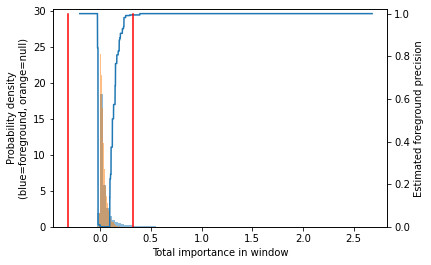

Got 97968 coords
After resolving overlaps, got 97968 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9700270905407408
MEMORY 16.094806016
97968 identified in total
1 activity patterns with support >= 2000 out of 2 possible patterns
Metacluster sizes:  [97965]
Idx to activities:  {0: '1'}
MEMORY 16.094806016
On metacluster 0
Metacluster size 97965 limited to 50000
Relevant tasks:  ('Nanog_profile_wn',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 50000
(Round 1) Computing coarse affmat
MEMORY 16.094806016
Beginning embedding computation
MEMORY 16.094806016


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.6s
[Parallel(n_jobs=10)]: Done 280 tasks      | elapsed:    7.3s
[Parallel(n_jobs=10)]: Done 780 tasks      | elapsed:   12.3s
[Parallel(n_jobs=10)]: Done 1480 tasks      | elapsed:   19.0s
[Parallel(n_jobs=10)]: Done 2380 tasks      | elapsed:   27.6s
[Parallel(n_jobs=10)]: Done 3480 tasks      | elapsed:   38.2s
[Parallel(n_jobs=10)]: Done 4780 tasks      | elapsed:   50.4s
[Parallel(n_jobs=10)]: Done 6280 tasks      | elapsed:  1.1min
[Parallel(n_jobs=10)]: Done 7980 tasks      | elapsed:  1.3min
[Parallel(n_jobs=10)]: Done 9880 tasks      | elapsed:  1.6min
[Parallel(n_jobs=10)]: Done 11980 tasks      | elapsed:  1.9min
[Parallel(n_jobs=10)]: Done 14280 tasks      | elapsed:  2.3min
[Parallel(n_jobs=10)]: Done 16780 tasks      | elapsed:  2.6min
[Parallel(n_jobs=10)]: Done 19480 tasks      | elapsed:  3.0min
[Parallel(n_jobs=10)]: Done 22380 tasks 

Constructing csr matrix...
csr matrix made in 15.401591539382935 s


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 50000 out of 50000 | elapsed:  3.1min finished


Constructing csr matrix...
csr matrix made in 14.126566171646118 s
Finished embedding computation in 1457.43 s
MEMORY 20.048818176
Starting affinity matrix computations
MEMORY 20.048556032
Batching in slices of size 1342


100%|██████████| 38/38 [15:22<00:00, 24.27s/it]

Finished affinity matrix computations in 922.92 s
MEMORY 20.048293888


(Round 1) Computed coarse affmat
MEMORY 19.545694208
(Round 1) Computing affinity matrix on nearest neighbors
MEMORY 19.545694208
Launching nearest neighbors affmat calculation job
MEMORY 19.545694208
Parallel runs completed
MEMORY 19.608797184
Job completed in: 392.86 s
MEMORY 19.608797184
Launching nearest neighbors affmat calculation job
MEMORY 19.608797184
Parallel runs completed
MEMORY 19.767099392
Job completed in: 385.43 s
MEMORY 19.767099392
(Round 1) Computed affinity matrix on nearest neighbors in 796.09 s
MEMORY 19.667152896
Filtered down to 41997 of 50000
(Round 1) Retained 41997 rows out of 50000 after filtering
MEMORY 19.667152896
(Round 1) Computing density adapted affmat
MEMORY 19.667152896
[t-SNE] Computed conditional probabilities for sample 1000 / 41997
[t-SNE] Computed conditional probabilities for sample 2000 / 41997
[t-SNE] Computed conditional probabilities for sample 3000 / 41997
[t-SNE] Computed conditional probabilities for sample 4000 / 41997
[t-SNE] Computed

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  5.6min


Quality: 0.7561596221748645
Quality: 0.756257737241806
Quality: 0.7563831136214795
Quality: 0.7564157093885451
Quality: 0.7566731316389486


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  8.6min finished


Got 36 clusters after round 1
Counts:
{17: 919, 7: 2063, 10: 1803, 12: 1581, 3: 2693, 8: 1961, 4: 2527, 11: 1774, 13: 1546, 5: 2225, 16: 1084, 14: 1380, 9: 1944, 1: 3419, 0: 4668, 20: 657, 2: 3028, 15: 1165, 18: 766, 6: 2137, 19: 683, 21: 592, 31: 20, 30: 40, 23: 344, 35: 10, 28: 58, 27: 64, 24: 133, 32: 20, 25: 93, 29: 44, 22: 446, 26: 83, 34: 12, 33: 15}
MEMORY 19.665895424
(Round 1) Aggregating seqlets in each cluster
MEMORY 19.665895424
Aggregating for cluster 0 with 4668 seqlets
MEMORY 19.665895424
Trimming eliminated 0 seqlets out of 4668
Skipped 1 seqlets
Removed 12 duplicate seqlets
Aggregating for cluster 1 with 3419 seqlets
MEMORY 19.665371136
Trimming eliminated 0 seqlets out of 3419
Skipped 1 seqlets
Removed 7 duplicate seqlets
Aggregating for cluster 2 with 3028 seqlets
MEMORY 19.665371136
Trimming eliminated 0 seqlets out of 3028
Removed 14 duplicate seqlets
Aggregating for cluster 3 with 2693 seqlets
MEMORY 19.665371136
Trimming eliminated 0 seqlets out of 2693
Removed 2

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  31 tasks      | elapsed:    4.0s
[Parallel(n_jobs=10)]: Done 324 tasks      | elapsed:    6.9s
[Parallel(n_jobs=10)]: Done 1324 tasks      | elapsed:   14.7s
[Parallel(n_jobs=10)]: Done 2724 tasks      | elapsed:   25.4s
[Parallel(n_jobs=10)]: Done 4524 tasks      | elapsed:   39.4s
[Parallel(n_jobs=10)]: Done 6724 tasks      | elapsed:   56.7s
[Parallel(n_jobs=10)]: Done 9324 tasks      | elapsed:  1.3min
[Parallel(n_jobs=10)]: Done 12324 tasks      | elapsed:  1.6min
[Parallel(n_jobs=10)]: Done 15724 tasks      | elapsed:  2.0min
[Parallel(n_jobs=10)]: Done 19524 tasks      | elapsed:  2.4min
[Parallel(n_jobs=10)]: Done 23724 tasks      | elapsed:  2.9min
[Parallel(n_jobs=10)]: Done 28324 tasks      | elapsed:  3.4min
[Parallel(n_jobs=10)]: Done 33324 tasks      | elapsed:  3.9min
[Parallel(n_jobs=10)]: Done 38724 tasks      | elapsed:  4.5min
[Parallel(n_jobs=10)]: Done 41729 ou

Constructing csr matrix...
csr matrix made in 12.72675633430481 s


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 41729 out of 41729 | elapsed:  2.6min finished


Constructing csr matrix...
csr matrix made in 11.81390643119812 s
Finished embedding computation in 995.98 s
MEMORY 20.330725376
Starting affinity matrix computations
MEMORY 20.330725376
Batching in slices of size 1608


100%|██████████| 26/26 [08:51<00:00, 20.44s/it]

Finished affinity matrix computations in 531.91 s
MEMORY 20.330725376


(Round 2) Computed coarse affmat
MEMORY 19.833102336
(Round 2) Computing affinity matrix on nearest neighbors
MEMORY 19.833102336
Launching nearest neighbors affmat calculation job
MEMORY 20.073418752
Parallel runs completed
MEMORY 20.109746176
Job completed in: 463.31 s
MEMORY 20.108959744
Launching nearest neighbors affmat calculation job
MEMORY 20.108693504
Parallel runs completed
MEMORY 20.19528704
Job completed in: 463.95 s
MEMORY 20.195024896
(Round 2) Computed affinity matrix on nearest neighbors in 944.66 s
MEMORY 19.831451648
Not applying filtering for rounds above first round
MEMORY 19.831451648
(Round 2) Computing density adapted affmat
MEMORY 19.831451648
[t-SNE] Computed conditional probabilities for sample 1000 / 41729
[t-SNE] Computed conditional probabilities for sample 2000 / 41729
[t-SNE] Computed conditional probabilities for sample 3000 / 41729
[t-SNE] Computed conditional probabilities for sample 4000 / 41729
[t-SNE] Computed conditional probabilities for sample 50

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  5.5min


Quality: 0.7322010420713774
Quality: 0.7340107999623549
Quality: 0.7342343444473574
Quality: 0.7342852098214336
Quality: 0.7348613971762101
Quality: 0.735031852765332
Quality: 0.7350370206481343


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  8.3min finished


Got 39 clusters after round 2
Counts:
{0: 4751, 3: 2771, 13: 1420, 1: 3509, 7: 2057, 11: 1767, 5: 2354, 12: 1686, 34: 20, 24: 256, 20: 524, 4: 2508, 14: 1185, 17: 820, 21: 496, 10: 1802, 8: 1994, 25: 177, 19: 542, 2: 3118, 6: 2065, 16: 874, 9: 1885, 30: 72, 36: 11, 15: 1028, 23: 263, 18: 758, 37: 10, 31: 46, 32: 44, 29: 76, 22: 438, 27: 119, 38: 10, 28: 81, 35: 16, 26: 156, 33: 20}
MEMORY 19.829633024
(Round 2) Aggregating seqlets in each cluster
MEMORY 19.829633024
Aggregating for cluster 0 with 4751 seqlets
MEMORY 19.829633024
Trimming eliminated 0 seqlets out of 4751
Removed 216 duplicate seqlets
Aggregating for cluster 1 with 3509 seqlets
MEMORY 19.828846592
Trimming eliminated 0 seqlets out of 3509
Skipped 1 seqlets
Removed 96 duplicate seqlets
Aggregating for cluster 2 with 3118 seqlets
MEMORY 19.828846592
Trimming eliminated 0 seqlets out of 3118
Removed 74 duplicate seqlets
Aggregating for cluster 3 with 2771 seqlets
MEMORY 19.828846592
Trimming eliminated 0 seqlets out of 2771

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  31 tasks      | elapsed:    5.5s
[Parallel(n_jobs=10)]: Done 474 tasks      | elapsed:    7.9s
[Parallel(n_jobs=10)]: Done 1474 tasks      | elapsed:   13.0s
[Parallel(n_jobs=10)]: Done 2874 tasks      | elapsed:   20.1s
[Parallel(n_jobs=10)]: Done 4516 out of 4535 | elapsed:   28.2s remaining:    0.1s
[Parallel(n_jobs=10)]: Done 4535 out of 4535 | elapsed:   28.2s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 4535
[t-SNE] Computed conditional probabilities for sample 2000 / 4535
[t-SNE] Computed conditional probabilities for sample 3000 / 4535
[t-SNE] Computed conditional probabilities for sample 4000 / 4535
[t-SNE] Computed conditional probabilities for sample 4535 / 4535
[t-SNE] Mean sigma: 0.244525
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  1.1min


Quality: 0.46914570673346295
Quality: 0.4692242947441329
Quality: 0.4692770316306558


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  1.9min finished


Got subclusters: Counter({0: 691, 1: 678, 2: 437, 3: 415, 4: 341, 5: 333, 6: 304, 7: 255, 8: 234, 9: 233, 10: 198, 11: 152, 12: 101, 13: 93, 14: 61, 15: 5, 16: 4})
On merging iteration 1
Numbers for each pattern pre-subsample: [691, 678, 437, 415, 341, 333, 304, 255, 234, 233, 198, 152, 101, 93, 61, 5, 4]
Numbers after subsampling: [300, 300, 300, 300, 300, 300, 300, 255, 234, 233, 198, 152, 101, 93, 61, 5, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 17.299661874771118 s
Computing sims for pattern 1
Computed sims for pattern 1 in 9.286919832229614 s
Computing sims for pattern 2
Computed sims for pattern 2 in 9.241504907608032 s
Computing sims for pattern 3
Computed sims for pattern 3 in 9.40750527381897 s
Computing sims for pattern 4
Computed sims for pattern 4 in 9.124509334564209 s
Computing sims for pattern 5
Computed sims for pattern 5 in 9.20526909828186 s
Computing sims for pattern 6
Computed sims for pattern 6 in 9.096908807754517 s
Computing sims for pattern 

Trimming eliminated 0 seqlets out of 2300
Removed 1 duplicate seqlets
Trimming eliminated 0 seqlets out of 2990
Trimming eliminated 0 seqlets out of 3083
Trimming eliminated 0 seqlets out of 3416
Removed 1 duplicate seqlets
Trimming eliminated 0 seqlets out of 3670
Trimming eliminated 0 seqlets out of 3771
Trimming eliminated 0 seqlets out of 3969
Removed 1 duplicate seqlets
Trimming eliminated 0 seqlets out of 4120
Unmerged patterns remapping: OrderedDict([(4, 1), (14, 2), (15, 3), (16, 4)])
Time spent on merging iteration: 37.90556859970093
On merging iteration 2
Numbers for each pattern pre-subsample: [4120, 341, 61, 5, 4]
Numbers after subsampling: [300, 300, 61, 5, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.346491813659668 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.7585043907165527 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.302600622177124 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.189601182937622

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=10)]: Done 620 tasks      | elapsed:    2.8s
[Parallel(n_jobs=10)]: Done 1620 tasks      | elapsed:    6.6s
[Parallel(n_jobs=10)]: Done 3020 tasks      | elapsed:   11.6s
[Parallel(n_jobs=10)]: Done 3393 out of 3412 | elapsed:   13.0s remaining:    0.1s
[Parallel(n_jobs=10)]: Done 3412 out of 3412 | elapsed:   13.1s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 3412
[t-SNE] Computed conditional probabilities for sample 2000 / 3412
[t-SNE] Computed conditional probabilities for sample 3000 / 3412
[t-SNE] Computed conditional probabilities for sample 3412 / 3412
[t-SNE] Mean sigma: 0.249099
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   43.4s


Quality: 0.4845590831038146
Quality: 0.48494074524427316
Quality: 0.48504124476097876
Quality: 0.48520418180781544
Quality: 0.48543068581800936
Quality: 0.48566797747506885
Quality: 0.4863848219354605


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  1.2min finished


Got subclusters: Counter({0: 634, 1: 517, 2: 514, 3: 483, 4: 291, 5: 237, 6: 236, 7: 149, 8: 138, 9: 92, 10: 82, 11: 25, 12: 14})
On merging iteration 1
Numbers for each pattern pre-subsample: [634, 517, 514, 483, 291, 237, 236, 149, 138, 92, 82, 25, 14]
Numbers after subsampling: [300, 300, 300, 300, 291, 237, 236, 149, 138, 92, 82, 25, 14]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.815947532653809 s
Computing sims for pattern 1
Computed sims for pattern 1 in 6.608923435211182 s
Computing sims for pattern 2
Computed sims for pattern 2 in 6.745129108428955 s
Computing sims for pattern 3
Computed sims for pattern 3 in 6.697052717208862 s
Computing sims for pattern 4
Computed sims for pattern 4 in 7.7222511768341064 s
Computing sims for pattern 5
Computed sims for pattern 5 in 5.7536187171936035 s
Computing sims for pattern 6
Computed sims for pattern 6 in 5.831435441970825 s
Computing sims for pattern 7
Computed sims for pattern 7 in 4.333608388900757 s
Computing sims

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    3.5s
[Parallel(n_jobs=10)]: Done 3025 out of 3044 | elapsed:    8.9s remaining:    0.1s
[Parallel(n_jobs=10)]: Done 3044 out of 3044 | elapsed:    8.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 3044
[t-SNE] Computed conditional probabilities for sample 2000 / 3044
[t-SNE] Computed conditional probabilities for sample 3000 / 3044
[t-SNE] Computed conditional probabilities for sample 3044 / 3044
[t-SNE] Mean sigma: 0.276694
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   32.4s


Quality: 0.5606104148442398
Quality: 0.5606757177452601
Quality: 0.5607668624938703
Quality: 0.5609324823854115
Quality: 0.560946501658051
Quality: 0.5610282956712525
Quality: 0.5611233649438673


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   50.4s finished


Got subclusters: Counter({1: 460, 0: 460, 2: 384, 3: 306, 4: 269, 5: 223, 6: 193, 7: 185, 8: 159, 9: 129, 10: 125, 11: 94, 12: 35, 13: 22})
On merging iteration 1
Numbers for each pattern pre-subsample: [460, 460, 384, 306, 269, 223, 193, 185, 159, 129, 125, 94, 35, 22]
Numbers after subsampling: [300, 300, 300, 300, 269, 223, 193, 185, 159, 129, 125, 94, 35, 22]
Computing sims for pattern 0
Computed sims for pattern 0 in 7.218732118606567 s
Computing sims for pattern 1
Computed sims for pattern 1 in 7.204108715057373 s
Computing sims for pattern 2
Computed sims for pattern 2 in 7.380877494812012 s
Computing sims for pattern 3
Computed sims for pattern 3 in 7.26627516746521 s
Computing sims for pattern 4
Computed sims for pattern 4 in 7.468090057373047 s
Computing sims for pattern 5
Computed sims for pattern 5 in 5.872839450836182 s
Computing sims for pattern 6
Computed sims for pattern 6 in 6.394777059555054 s
Computing sims for pattern 7
Computed sims for pattern 7 in 5.9777173995971

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    3.2s
[Parallel(n_jobs=10)]: Done 2545 out of 2545 | elapsed:    7.1s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2545
[t-SNE] Computed conditional probabilities for sample 2000 / 2545
[t-SNE] Computed conditional probabilities for sample 2545 / 2545
[t-SNE] Mean sigma: 0.278054
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   25.7s


Quality: 0.5068384464446867
Quality: 0.5094554058033691
Quality: 0.5102882926258059
Quality: 0.5103351154018156


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   42.3s finished


Got subclusters: Counter({0: 688, 1: 548, 2: 504, 3: 433, 4: 160, 5: 125, 6: 87})
On merging iteration 1
Numbers for each pattern pre-subsample: [688, 548, 504, 433, 160, 125, 87]
Numbers after subsampling: [300, 300, 300, 300, 160, 125, 87]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.5124876499176025 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.489311456680298 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.421908378601074 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.4514894485473633 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.418172836303711 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.3025970458984375 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.952216386795044 s
Cluster sizes
[688 548 504 433 160 125  87]
Cross-contamination matrix:
[[1.   0.41 0.36 0.33 0.35 0.28 0.28]
 [0.52 1.   0.58 0.6  0.52 0.58 0.51]
 [0.52 0.62 1.   0.56 0.55 0.48 0.44]
 [0.64 0.

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.9s
[Parallel(n_jobs=10)]: Done 2318 out of 2337 | elapsed:    5.9s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 2337 out of 2337 | elapsed:    5.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2337
[t-SNE] Computed conditional probabilities for sample 2000 / 2337
[t-SNE] Computed conditional probabilities for sample 2337 / 2337
[t-SNE] Mean sigma: 0.277905
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   24.2s


Quality: 0.46896752617154763
Quality: 0.46899060412126736
Quality: 0.4691201615198462
Quality: 0.4691734882206864
Quality: 0.46923070316641485


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   40.3s finished


Got subclusters: Counter({0: 550, 1: 476, 2: 407, 3: 264, 4: 183, 5: 101, 6: 98, 7: 79, 9: 62, 8: 62, 10: 51, 11: 4})
On merging iteration 1
Numbers for each pattern pre-subsample: [550, 476, 407, 264, 183, 101, 98, 79, 62, 62, 51, 4]
Numbers after subsampling: [300, 300, 300, 264, 183, 101, 98, 79, 62, 62, 51, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.948344945907593 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.698433876037598 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.879046678543091 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.954996109008789 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.816519260406494 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.1855640411376953 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.5266683101654053 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.158421754837036 s
Computing sims for pattern 8
Computed sims

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done 2144 out of 2144 | elapsed:    4.4s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2144
[t-SNE] Computed conditional probabilities for sample 2000 / 2144
[t-SNE] Computed conditional probabilities for sample 2144 / 2144
[t-SNE] Mean sigma: 0.277348
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   23.2s


Quality: 0.4967527349576766
Quality: 0.49901083512684663
Quality: 0.4991071313341371
Quality: 0.49913895148264736
Quality: 0.49959837583381045


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   35.7s finished


Got subclusters: Counter({0: 554, 1: 434, 2: 315, 3: 266, 4: 265, 5: 176, 6: 101, 7: 30, 8: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [554, 434, 315, 266, 265, 176, 101, 30, 3]
Numbers after subsampling: [300, 300, 300, 266, 265, 176, 101, 30, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.460591077804565 s
Computing sims for pattern 1
Computed sims for pattern 1 in 11.614064931869507 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.52734899520874 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.6146464347839355 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.612166166305542 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.638373613357544 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.4282448291778564 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.7966666221618652 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.2436444759368896 s
Clus

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1795 tasks      | elapsed:    3.2s
[Parallel(n_jobs=10)]: Done 1962 out of 1981 | elapsed:    3.4s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1981 out of 1981 | elapsed:    3.4s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1981
[t-SNE] Computed conditional probabilities for sample 1981 / 1981
[t-SNE] Mean sigma: 0.289127
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   18.8s


Quality: 0.4944088335476964
Quality: 0.49501034671441096
Quality: 0.4951288492647094
Quality: 0.4952155293358086
Quality: 0.49535904613709675
Quality: 0.4955095338228511


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   29.8s finished


Got subclusters: Counter({0: 405, 1: 386, 2: 332, 3: 235, 4: 163, 5: 119, 6: 109, 7: 106, 8: 67, 9: 48, 10: 11})
On merging iteration 1
Numbers for each pattern pre-subsample: [405, 386, 332, 235, 163, 119, 109, 106, 67, 48, 11]
Numbers after subsampling: [300, 300, 300, 235, 163, 119, 109, 106, 67, 48, 11]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.551023006439209 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.5714380741119385 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.47023606300354 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.698880195617676 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.008727312088013 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.345041513442993 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.0578653812408447 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.969942808151245 s
Computing sims for pattern 8
Computed sims for pat

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.3s
[Parallel(n_jobs=10)]: Done 1912 out of 1912 | elapsed:    3.8s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1912
[t-SNE] Computed conditional probabilities for sample 1912 / 1912
[t-SNE] Mean sigma: 0.264560
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   20.5s


Quality: 0.4394418348040304
Quality: 0.43963776574081415


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   32.2s finished


Got subclusters: Counter({0: 397, 1: 376, 2: 260, 3: 224, 4: 178, 5: 157, 6: 109, 7: 93, 8: 56, 9: 33, 10: 29})
On merging iteration 1
Numbers for each pattern pre-subsample: [397, 376, 260, 224, 178, 157, 109, 93, 56, 33, 29]
Numbers after subsampling: [300, 300, 260, 224, 178, 157, 109, 93, 56, 33, 29]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.8218934535980225 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.58605432510376 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.334733486175537 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.649715900421143 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.4413135051727295 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.9022598266601562 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.254225254058838 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.3466739654541016 s
Computing sims for pattern 8
Computed sims for patt

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1675 tasks      | elapsed:    3.2s
[Parallel(n_jobs=10)]: Done 1862 out of 1862 | elapsed:    3.5s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1862
[t-SNE] Computed conditional probabilities for sample 1862 / 1862
[t-SNE] Mean sigma: 0.273655
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   16.1s


Quality: 0.48752769689492415
Quality: 0.49044701660066564
Quality: 0.49057344347510085
Quality: 0.49113874035853744


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   27.1s finished


Got subclusters: Counter({0: 453, 1: 333, 2: 260, 3: 242, 4: 150, 5: 116, 6: 108, 7: 95, 8: 60, 9: 25, 10: 10, 11: 7, 12: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [453, 333, 260, 242, 150, 116, 108, 95, 60, 25, 10, 7, 3]
Numbers after subsampling: [300, 300, 260, 242, 150, 116, 108, 95, 60, 25, 10, 7, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.6860058307647705 s
Computing sims for pattern 1
Computed sims for pattern 1 in 6.550617933273315 s
Computing sims for pattern 2
Computed sims for pattern 2 in 6.465137481689453 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.839426040649414 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.234227180480957 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.9431517124176025 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.6910765171051025 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.6991968154907227 s
Computing sims for patte

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1690 tasks      | elapsed:    3.2s
[Parallel(n_jobs=10)]: Done 1793 out of 1812 | elapsed:    3.3s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1812 out of 1812 | elapsed:    3.3s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1812
[t-SNE] Computed conditional probabilities for sample 1812 / 1812
[t-SNE] Mean sigma: 0.273684
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   17.3s


Quality: 0.47562845129603365
Quality: 0.47594741017370856
Quality: 0.4770303321802008
Quality: 0.4783191282095445


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   28.0s finished


Got subclusters: Counter({0: 471, 1: 361, 2: 301, 3: 253, 4: 182, 5: 146, 6: 51, 7: 42, 8: 5})
On merging iteration 1
Numbers for each pattern pre-subsample: [471, 361, 301, 253, 182, 146, 51, 42, 5]
Numbers after subsampling: [300, 300, 300, 253, 182, 146, 51, 42, 5]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.475936412811279 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.480225324630737 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.5981833934783936 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.277259111404419 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.6799938678741455 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.8585526943206787 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.9669010639190674 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.8296010494232178 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.29783034324646 s
Cluster

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1510 tasks      | elapsed:    2.7s
[Parallel(n_jobs=10)]: Done 1713 out of 1713 | elapsed:    2.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1713
[t-SNE] Computed conditional probabilities for sample 1713 / 1713
[t-SNE] Mean sigma: 0.279238
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   18.2s


Quality: 0.4183331412186579
Quality: 0.4185319994331477
Quality: 0.4191773781924237
Quality: 0.41918003659549613
Quality: 0.4193385500699644


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   28.1s finished


Got subclusters: Counter({0: 291, 1: 263, 2: 177, 3: 155, 4: 136, 5: 135, 6: 134, 7: 122, 8: 105, 9: 98, 10: 97})
On merging iteration 1
Numbers for each pattern pre-subsample: [291, 263, 177, 155, 136, 135, 134, 122, 105, 98, 97]
Numbers after subsampling: [291, 263, 177, 155, 136, 135, 134, 122, 105, 98, 97]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.452538728713989 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.635991334915161 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.245362043380737 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.7245047092437744 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.7994384765625 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.8079450130462646 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.6677465438842773 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.3371670246124268 s
Computing sims for pattern 8
Computed sims for

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1570 tasks      | elapsed:    2.7s
[Parallel(n_jobs=10)]: Done 1661 out of 1661 | elapsed:    2.8s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1661
[t-SNE] Computed conditional probabilities for sample 1661 / 1661
[t-SNE] Mean sigma: 0.282194
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   16.7s


Quality: 0.47745114718763837
Quality: 0.4781970820638508
Quality: 0.47836401501263764
Quality: 0.4791460640647806


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   26.3s finished


Got subclusters: Counter({0: 297, 1: 253, 2: 242, 3: 198, 4: 165, 5: 146, 6: 119, 7: 94, 8: 89, 9: 58})
On merging iteration 1
Numbers for each pattern pre-subsample: [297, 253, 242, 198, 165, 146, 119, 94, 89, 58]
Numbers after subsampling: [297, 253, 242, 198, 165, 146, 119, 94, 89, 58]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.044574975967407 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.720770359039307 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.520925760269165 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.404887676239014 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.7718822956085205 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.4691550731658936 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.072054147720337 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.956935405731201 s
Computing sims for pattern 8
Computed sims for pattern 8 in 2.936740

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1300 tasks      | elapsed:    1.7s
[Parallel(n_jobs=10)]: Done 1398 out of 1398 | elapsed:    1.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1398
[t-SNE] Computed conditional probabilities for sample 1398 / 1398
[t-SNE] Mean sigma: 0.268881
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   12.0s


Quality: 0.4995873163857182
Quality: 0.5001445538745612
Quality: 0.5004635533046846
Quality: 0.5008674157198165
Quality: 0.5008973441953785


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   20.0s finished


Got subclusters: Counter({0: 399, 1: 250, 2: 215, 3: 208, 4: 204, 5: 78, 6: 42, 7: 2})
On merging iteration 1
Numbers for each pattern pre-subsample: [399, 250, 215, 208, 204, 78, 42, 2]
Numbers after subsampling: [300, 250, 215, 208, 204, 78, 42, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.88352108001709 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.65297532081604 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.781947135925293 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.72895884513855 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.568938732147217 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.9619135856628418 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.5857725143432617 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.0042533874511719 s
Cluster sizes
[399 250 215 208 204  78  42   2]
Cross-contamination matrix:
[[1.   1.   1.   0.83 0.4  0.69 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1300 tasks      | elapsed:    1.8s
[Parallel(n_jobs=10)]: Done 1328 out of 1328 | elapsed:    1.8s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1328
[t-SNE] Computed conditional probabilities for sample 1328 / 1328
[t-SNE] Mean sigma: 0.283017
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.3s


Quality: 0.46893846184747984
Quality: 0.4695382946299388
Quality: 0.46975783121213727
Quality: 0.4698576127275464


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   18.8s finished


Got subclusters: Counter({0: 307, 1: 204, 2: 202, 3: 150, 4: 149, 5: 143, 6: 129, 7: 41, 8: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [307, 204, 202, 150, 149, 143, 129, 41, 3]
Numbers after subsampling: [300, 204, 202, 150, 149, 143, 129, 41, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.292811632156372 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.03295111656189 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.950958728790283 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.8225104808807373 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.7514355182647705 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.663820505142212 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.823676586151123 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.6813116073608398 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.164552927017212 s
Cluste

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1000 tasks      | elapsed:    1.0s
[Parallel(n_jobs=10)]: Done 1092 out of 1092 | elapsed:    1.1s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1092
[t-SNE] Computed conditional probabilities for sample 1092 / 1092
[t-SNE] Mean sigma: 0.295032
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    8.5s


Quality: 0.4494117587951017
Quality: 0.44985949484286836
Quality: 0.4511974485601759
Quality: 0.45163397211950373


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   14.3s finished


Got subclusters: Counter({0: 286, 1: 279, 2: 246, 3: 98, 4: 93, 5: 58, 6: 17, 7: 15})
On merging iteration 1
Numbers for each pattern pre-subsample: [286, 279, 246, 98, 93, 58, 17, 15]
Numbers after subsampling: [286, 279, 246, 98, 93, 58, 17, 15]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.27398419380188 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.03437352180481 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.364865303039551 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.2624671459198 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.27221941947937 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.7380383014678955 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.2112233638763428 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.19669771194458 s
Cluster sizes
[286 279 246  98  93  58  17  15]
Cross-contamination matrix:
[[1.   0.57 0.45 0.56 0.71 0.56 0.51 0.4

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 977 out of 977 | elapsed:    0.9s finished


[t-SNE] Computed conditional probabilities for sample 977 / 977
[t-SNE] Mean sigma: 0.297427
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    8.4s


Quality: 0.49849827062414787
Quality: 0.4990072663303956
Quality: 0.4990379245429071
Quality: 0.4990860074227374
Quality: 0.49923602217344576
Quality: 0.4992697264230099


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   13.3s finished


Got subclusters: Counter({0: 195, 1: 190, 2: 148, 3: 118, 4: 86, 5: 70, 6: 52, 7: 38, 8: 37, 9: 26, 10: 15, 11: 2})
On merging iteration 1
Numbers for each pattern pre-subsample: [195, 190, 148, 118, 86, 70, 52, 38, 37, 26, 15, 2]
Numbers after subsampling: [195, 190, 148, 118, 86, 70, 52, 38, 37, 26, 15, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.865341901779175 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.791292905807495 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.5524208545684814 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.2921383380889893 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.1436636447906494 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.690251350402832 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.379617214202881 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.342597007751465 s
Computing sims for pattern 8
Computed sims for 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 780 tasks      | elapsed:    0.6s
[Parallel(n_jobs=10)]: Done 802 out of 821 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 821 out of 821 | elapsed:    0.6s finished


[t-SNE] Computed conditional probabilities for sample 821 / 821
[t-SNE] Mean sigma: 0.322123
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    6.3s


Quality: 0.4892406182798099
Quality: 0.4896500788884312


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   10.5s finished


Got subclusters: Counter({0: 188, 1: 159, 2: 135, 3: 94, 4: 91, 5: 59, 6: 50, 7: 36, 8: 6, 9: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [188, 159, 135, 94, 91, 59, 50, 36, 6, 3]
Numbers after subsampling: [188, 159, 135, 94, 91, 59, 50, 36, 6, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.8491618633270264 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.1425628662109375 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.0665149688720703 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.646313190460205 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.59702205657959 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.1791815757751465 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.9521825313568115 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.7923657894134521 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.2561843395233154 s
Co

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 700 tasks      | elapsed:    0.5s
[Parallel(n_jobs=10)]: Done 782 out of 782 | elapsed:    0.6s finished


[t-SNE] Computed conditional probabilities for sample 782 / 782
[t-SNE] Mean sigma: 0.312468
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.4s


Quality: 0.5219351594815936
Quality: 0.5219390276502217
Quality: 0.5219528347250174
Quality: 0.5220776841056994
Quality: 0.5221659072046299
Quality: 0.5222397953993313


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    9.0s finished


Got subclusters: Counter({0: 198, 1: 168, 2: 152, 3: 109, 4: 65, 5: 58, 6: 32})
On merging iteration 1
Numbers for each pattern pre-subsample: [198, 168, 152, 109, 65, 58, 32]
Numbers after subsampling: [198, 168, 152, 109, 65, 58, 32]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.759800910949707 s
Computing sims for pattern 1
Computed sims for pattern 1 in 2.3362410068511963 s
Computing sims for pattern 2
Computed sims for pattern 2 in 2.0799448490142822 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.7068657875061035 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.4255976676940918 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.468806266784668 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.2357118129730225 s
Cluster sizes
[198 168 152 109  65  58  32]
Cross-contamination matrix:
[[1.   0.69 0.62 0.72 0.68 0.81 0.41]
 [0.31 1.   0.27 0.42 0.42 0.67 0.27]
 [0.79 0.8  1.   0.72 0.67 0.87 0.47]
 [0.65 0.72 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 667 out of 667 | elapsed:    0.5s finished


[t-SNE] Computed conditional probabilities for sample 667 / 667
[t-SNE] Mean sigma: 0.285947
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.5s


Quality: 0.5107978425190879
Quality: 0.5144378451600929
Quality: 0.5144538269674347
Quality: 0.5144995985632533
Quality: 0.5145497544149379


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.7s finished


Got subclusters: Counter({0: 156, 1: 152, 2: 144, 3: 103, 4: 78, 5: 32, 6: 2})
On merging iteration 1
Numbers for each pattern pre-subsample: [156, 152, 144, 103, 78, 32, 2]
Numbers after subsampling: [156, 152, 144, 103, 78, 32, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.100687026977539 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.9367289543151855 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.8060190677642822 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.5882501602172852 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.6269769668579102 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.1771650314331055 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.8737637996673584 s
Cluster sizes
[156 152 144 103  78  32   2]
Cross-contamination matrix:
[[1.   0.23 0.76 0.27 0.24 0.37 0.  ]
 [0.98 1.   1.   1.   0.86 1.   0.03]
 [0.59 0.18 1.   0.14 0.14 0.25 0.  ]
 [0.56 0.52 0.4

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 508 out of 508 | elapsed:    0.4s finished


[t-SNE] Computed conditional probabilities for sample 508 / 508
[t-SNE] Mean sigma: 0.315863
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.2s


Quality: 0.40599651881181154
Quality: 0.40714393938719645
Quality: 0.4072085017301045
Quality: 0.41059625741669514
Quality: 0.4106048474758408
Quality: 0.41064190053009253


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.9s finished


Got subclusters: Counter({0: 114, 1: 103, 2: 76, 3: 54, 4: 53, 5: 51, 6: 31, 7: 26})
On merging iteration 1
Numbers for each pattern pre-subsample: [114, 103, 76, 54, 53, 51, 31, 26]
Numbers after subsampling: [114, 103, 76, 54, 53, 51, 31, 26]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.9850215911865234 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.7699213027954102 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.6961522102355957 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.5495312213897705 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.4912996292114258 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.4740097522735596 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.2748703956604004 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.2007834911346436 s
Cluster sizes
[114 103  76  54  53  51  31  26]
Cross-contamination matrix:
[[1.   0.61 0.93 0.53 0.67 0.74

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 511 out of 511 | elapsed:    0.4s finished


[t-SNE] Computed conditional probabilities for sample 511 / 511
[t-SNE] Mean sigma: 0.270810
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.8s


Quality: 0.5582722135707685
Quality: 0.5583939123549022
Quality: 0.5585856473725551
Got subclusters: Counter({0: 165, 1: 157, 2: 91, 3: 81, 5: 7, 4: 7, 6: 3})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.1s finished


Numbers for each pattern pre-subsample: [165, 157, 91, 81, 7, 7, 3]
Numbers after subsampling: [165, 157, 91, 81, 7, 7, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.2067580223083496 s
Computing sims for pattern 1
Computed sims for pattern 1 in 2.013418197631836 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.651085376739502 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.6633989810943604 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.8330240249633789 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.8611359596252441 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.8458774089813232 s
Cluster sizes
[165 157  91  81   7   7   3]
Cross-contamination matrix:
[[1.   0.69 0.42 0.47 0.42 0.17 0.16]
 [0.91 1.   0.66 0.56 0.62 0.34 0.22]
 [0.84 0.85 1.   0.93 0.75 0.27 0.23]
 [0.69 0.57 0.74 1.   0.48 0.17 0.15]
 [0.47 0.44 0.29 0.19 1.   0.   0.01]
 [0.06 0.07 0.01 0.02 0.   1.   0.  ]
 [0.   0.   

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 472 out of 472 | elapsed:    0.3s finished


[t-SNE] Computed conditional probabilities for sample 472 / 472
[t-SNE] Mean sigma: 0.337073
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.1s


Quality: 0.47479696540797306
Quality: 0.47491521485873767
Quality: 0.47615894175456486
Got subclusters: Counter({0: 115, 1: 113, 2: 95, 3: 75, 4: 30, 5: 27, 6: 14, 7: 3})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.0s finished


Numbers for each pattern pre-subsample: [115, 113, 95, 75, 30, 27, 14, 3]
Numbers after subsampling: [115, 113, 95, 75, 30, 27, 14, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.024651527404785 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.9540882110595703 s
Computing sims for pattern 2
Computed sims for pattern 2 in 2.116706609725952 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.866980791091919 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.2775382995605469 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.2207729816436768 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.1087181568145752 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.8909568786621094 s
Cluster sizes
[115 113  95  75  30  27  14   3]
Cross-contamination matrix:
[[1.   0.68 0.5  0.54 0.61 0.36 0.51 0.09]
 [0.61 1.   0.44 0.56 0.61 0.42 0.55 0.09]
 [0.72 0.75 1.   0.67 0.65 0.54 0.71 0.14]
 [0.26 0.31 0.2

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 400 tasks      | elapsed:    0.3s
[Parallel(n_jobs=10)]: Done 435 out of 435 | elapsed:    0.4s finished


[t-SNE] Computed conditional probabilities for sample 435 / 435
[t-SNE] Mean sigma: 0.397439
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.6s


Quality: 0.5989604637201386
Got subclusters: Counter({0: 137, 1: 114, 2: 110, 3: 74})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.6s finished


Numbers for each pattern pre-subsample: [137, 114, 110, 74]
Numbers after subsampling: [137, 114, 110, 74]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.065697431564331 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.9252903461456299 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.8617873191833496 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.7616622447967529 s
Cluster sizes
[137 114 110  74]
Cross-contamination matrix:
[[1.   0.09 0.61 0.09]
 [0.54 1.   0.59 0.88]
 [0.63 0.19 1.   0.5 ]
 [0.23 0.39 0.5  1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.54 0.8  0.46]
 [0.54 1.   0.51 0.71]
 [0.8  0.51 1.   0.59]
 [0.46 0.71 0.6  1.  ]]
Inspecting pattern 23 for spurious merging


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 248 out of 248 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 248 / 248
[t-SNE] Mean sigma: 0.351806
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.4073276401189349
Quality: 0.4074727575677145
Quality: 0.40791730795688713
Quality: 0.4084607209700581
Got subclusters: Counter({0: 68, 1: 65, 2: 60, 3: 51, 5: 2, 4: 2})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.1s finished


Numbers for each pattern pre-subsample: [68, 65, 60, 51, 2, 2]
Numbers after subsampling: [68, 65, 60, 51, 2, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.153651475906372 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.129878282546997 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.031606912612915 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.051311731338501 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.6227519512176514 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.6312806606292725 s
Cluster sizes
[68 65 60 51  2  2]
Cross-contamination matrix:
[[1.   0.47 0.49 0.43 0.26 0.23]
 [0.42 1.   0.77 0.68 0.11 0.3 ]
 [0.37 0.65 1.   0.5  0.04 0.27]
 [0.41 0.75 0.68 1.   0.12 0.31]
 [0.   0.   0.   0.   1.   0.  ]
 [0.   0.   0.   0.   0.5  1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.63 0.61 0.59 0.39 0.29]
 [0.63 1.   0.88 0.86 0.4  0.51]
 [0.61 0.88 1.   0.84 0.28 0.46]
 [0.59 0.86 0.

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 251 out of 251 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 251 / 251
[t-SNE] Mean sigma: 0.370340
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.4s


Quality: 0.43187806971696174
Quality: 0.4322863501895905
Got subclusters: Counter({0: 68, 1: 58, 2: 53, 3: 40, 4: 32})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.3s finished


Numbers for each pattern pre-subsample: [68, 58, 53, 40, 32]
Numbers after subsampling: [68, 58, 53, 40, 32]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.9440901279449463 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.8920760154724121 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.8616361618041992 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.7342095375061035 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.7421276569366455 s
Cluster sizes
[68 58 53 40 32]
Cross-contamination matrix:
[[1.   0.28 0.28 0.26 0.52]
 [0.62 1.   0.72 0.85 0.89]
 [0.67 0.77 1.   0.95 0.85]
 [0.2  0.3  0.32 1.   0.34]
 [0.75 0.63 0.57 0.65 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.68 0.72 0.59 0.81]
 [0.68 1.   0.83 0.74 0.85]
 [0.72 0.83 1.   0.76 0.81]
 [0.59 0.74 0.76 1.   0.71]
 [0.81 0.85 0.81 0.71 1.  ]]
Inspecting pattern 25 for spurious merging


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 170 out of 170 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 170 / 170
[t-SNE] Mean sigma: 0.400753
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.35742658623995055
Quality: 0.35937990312373747
Quality: 0.35972289505594446
Got subclusters: Counter({0: 48, 1: 37, 2: 35, 3: 28, 4: 10, 5: 6, 6: 6})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished


Numbers for each pattern pre-subsample: [48, 37, 35, 28, 10, 6, 6]
Numbers after subsampling: [48, 37, 35, 28, 10, 6, 6]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.1675660610198975 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.0835685729980469 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.1348321437835693 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.018890619277954 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.8442966938018799 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.7625904083251953 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.80399489402771 s
Cluster sizes
[48 37 35 28 10  6  6]
Cross-contamination matrix:
[[1.   0.63 0.82 0.92 0.48 0.48 0.78]
 [0.49 1.   0.33 0.42 0.22 0.19 0.43]
 [0.21 0.11 1.   0.36 0.11 0.08 0.16]
 [0.51 0.2  0.77 1.   0.15 0.09 0.4 ]
 [0.03 0.02 0.03 0.03 1.   0.12 0.01]
 [0.3  0.17 0.18 0.2  0.28 1.   0.25]
 [0.44 0.27 0.4  0.51 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 118 out of 118 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 118 / 118
[t-SNE] Mean sigma: 0.458120
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.2938837765535791
Got subclusters: Counter({0: 43, 1: 38, 2: 29, 3: 8})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished


Numbers for each pattern pre-subsample: [43, 38, 29, 8]
Numbers after subsampling: [43, 38, 29, 8]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.5306191444396973 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.5674834251403809 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.5366992950439453 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.39903783798217773 s
Cluster sizes
[43 38 29  8]
Cross-contamination matrix:
[[1.   0.68 1.   0.47]
 [0.57 1.   0.83 0.21]
 [0.56 0.49 1.   0.1 ]
 [0.22 0.15 0.23 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.68 0.87 0.63]
 [0.68 1.   0.82 0.48]
 [0.87 0.82 1.   0.61]
 [0.63 0.48 0.61 1.  ]]
Collapsing 0 & 2 with crosscontam 0.5620223375578199 and sim 0.8689929377893804
Trimming eliminated 0 seqlets out of 72
Unmerged patterns remapping: OrderedDict([(1, 1), (3, 2)])
Time spent on merging iteration: 0.5343499183654785
On merging iteration 2
Numbers for each pattern pre-subsample: [72, 38, 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  99 out of 118 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 118 out of 118 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 118 / 118
[t-SNE] Mean sigma: 0.434416
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.3112989543980275
Got subclusters: Counter({0: 52, 1: 31, 2: 14, 3: 11, 4: 10})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished


Numbers for each pattern pre-subsample: [52, 31, 14, 11, 10]
Numbers after subsampling: [52, 31, 14, 11, 10]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.7962212562561035 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.7063288688659668 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.5892796516418457 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.5390896797180176 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.5528228282928467 s
Cluster sizes
[52 31 14 11 10]
Cross-contamination matrix:
[[1.   0.7  0.25 0.18 0.6 ]
 [0.5  1.   0.08 0.06 0.45]
 [0.4  0.24 1.   0.14 0.29]
 [0.8  0.7  0.65 1.   0.91]
 [0.78 0.79 0.27 0.17 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.84 0.71 0.72 0.87]
 [0.84 1.   0.58 0.6  0.78]
 [0.71 0.58 1.   0.56 0.71]
 [0.73 0.62 0.56 1.   0.69]
 [0.87 0.78 0.71 0.66 1.  ]]
Collapsing 0 & 4 with crosscontam 0.6032828857532999 and sim 0.8681775503104321
Trimming eliminated 0 seqlets out 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  80 out of  80 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.3134707767146161
Got subclusters: Counter({0: 42, 1: 24, 2: 14})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished


Numbers for each pattern pre-subsample: [42, 24, 14]
Numbers after subsampling: [42, 24, 14]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.3711264133453369 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.32224488258361816 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.30814409255981445 s
Cluster sizes
[42 24 14]
Cross-contamination matrix:
[[1.   0.24 0.2 ]
 [0.11 1.   0.17]
 [0.51 0.57 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.43 0.51]
 [0.42 1.   0.55]
 [0.51 0.56 1.  ]]
Inspecting pattern 29 for spurious merging
[t-SNE] Computed conditional probabilities for sample 76 / 76
[t-SNE] Mean sigma: 0.498421
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  76 out of  76 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.23411917107489694
Got subclusters: Counter({0: 33, 1: 32, 2: 11})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    3.9s finished


Numbers for each pattern pre-subsample: [33, 32, 11]
Numbers after subsampling: [33, 32, 11]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.3462333679199219 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.3416409492492676 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.27628421783447266 s
Cluster sizes
[33 32 11]
Cross-contamination matrix:
[[1.   0.12 0.34]
 [0.85 1.   0.65]
 [0.91 0.65 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.91 0.92]
 [0.91 1.   0.87]
 [0.92 0.87 1.  ]]
Collapsing 0 & 2 with crosscontam 0.3449976853432901 and sim 0.9179260684580774
Collapsing 1 & 2 with crosscontam 0.6456298828125 and sim 0.8739931535983424
Trimming eliminated 0 seqlets out of 44
Trimming eliminated 0 seqlets out of 76
Unmerged patterns remapping: OrderedDict()
Time spent on merging iteration: 0.461653470993042
On merging iteration 2
Numbers for each pattern pre-subsample: [76]
Numbers after subsampling: [76]
Computing sims for pattern 0
Computed 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  52 out of  71 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  71 out of  71 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.3s


Quality: 0.22852212337252292
Got subclusters: Counter({0: 45, 1: 21, 2: 3, 3: 2})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    3.9s finished


Numbers for each pattern pre-subsample: [45, 21, 3, 2]
Numbers after subsampling: [45, 21, 3, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.5826058387756348 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.46729564666748047 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.37283754348754883 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.3987605571746826 s
Cluster sizes
[45 21  3  2]
Cross-contamination matrix:
[[1.   0.17 0.4  0.3 ]
 [0.17 1.   0.05 0.03]
 [0.43 0.   1.   0.  ]
 [0.   0.   0.   1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.47 0.59 0.47]
 [0.45 1.   0.4  0.37]
 [0.6  0.41 1.   0.39]
 [0.47 0.37 0.38 1.  ]]
Inspecting pattern 31 for spurious merging
Inspecting pattern 32 for spurious merging
Inspecting pattern 33 for spurious merging
Inspecting pattern 34 for spurious merging
Inspecting pattern 35 for spurious merging
Inspecting pattern 36 for spurious merging
Inspecting pattern 37 for spurious merging
Ins

Computed sims for pattern 71 in 43.90907144546509 s
Computing sims for pattern 72
Computed sims for pattern 72 in 42.35127663612366 s
Computing sims for pattern 73
Computed sims for pattern 73 in 34.69875717163086 s
Computing sims for pattern 74
Computed sims for pattern 74 in 32.05144381523132 s
Computing sims for pattern 75
Computed sims for pattern 75 in 29.782116413116455 s
Computing sims for pattern 76
Computed sims for pattern 76 in 20.65654969215393 s
Computing sims for pattern 77
Computed sims for pattern 77 in 20.167194843292236 s
Computing sims for pattern 78
Computed sims for pattern 78 in 74.5072660446167 s
Computing sims for pattern 79
Computed sims for pattern 79 in 60.83406734466553 s
Computing sims for pattern 80
Computed sims for pattern 80 in 34.7303261756897 s
Computing sims for pattern 81
Computed sims for pattern 81 in 28.446282863616943 s
Computing sims for pattern 82
Computed sims for pattern 82 in 74.03146743774414 s
Computing sims for pattern 83
Computed sims f

Collapsing 5 & 82 with crosscontam 0.6955024419753086 and sim 0.8822345538467109
Aborting collapse as 33 & 89 have cross-contam 0.3447842443378304 and sim 0.6542030880473905
Aborting collapse as 81 & 110 have cross-contam 0.12420736413936717 and sim 0.40298883473369407
Collapsing 43 & 46 with crosscontam 0.5926442992592593 and sim 0.8697372204687325
Collapsing 18 & 43 with crosscontam 0.5647073081481482 and sim 0.868442045246925
Collapsing 43 & 85 with crosscontam 0.6312045274074072 and sim 0.8662663176061852
Collapsing 89 & 111 with crosscontam 0.6333771874999998 and sim 0.8601067905565938
Collapsing 15 & 101 with crosscontam 0.6158284457439898 and sim 0.8596146304214809
Collapsing 43 & 58 with crosscontam 0.539517887654321 and sim 0.8584480672322137
Collapsing 0 & 110 with crosscontam 0.7658480490606341 and sim 0.854466719518409
Aborting collapse as 1 & 111 have cross-contam 0.3951550527777776 and sim 0.7008595283362304
Collapsing 18 & 101 with crosscontam 0.5171151721897336 and sim 

Computed sims for pattern 41 in 2.2393558025360107 s
Computing sims for pattern 42
Computed sims for pattern 42 in 2.231048107147217 s
Computing sims for pattern 43
Computed sims for pattern 43 in 2.1408238410949707 s
Computing sims for pattern 44
Computed sims for pattern 44 in 2.0591468811035156 s
Computing sims for pattern 45
Computed sims for pattern 45 in 1.9707815647125244 s
Computing sims for pattern 46
Computed sims for pattern 46 in 34.33073306083679 s
Computing sims for pattern 47
Computed sims for pattern 47 in 1.9836788177490234 s
Computing sims for pattern 48
Computed sims for pattern 48 in 1.993530035018921 s
Computing sims for pattern 49
Computed sims for pattern 49 in 1.986304759979248 s
Computing sims for pattern 50
Computed sims for pattern 50 in 1.81770658493042 s
Computing sims for pattern 51
Computed sims for pattern 51 in 1.7790944576263428 s
Computing sims for pattern 52
Computed sims for pattern 52 in 1.7388417720794678 s
Computing sims for pattern 53
Computed s

Collapsing 1 & 11 with crosscontam 0.6923410869135802 and sim 0.883663774874167
Collapsing 0 & 7 with crosscontam 0.5705498079012346 and sim 0.8610777498103817
Trimming eliminated 1 seqlets out of 1084
Removed 7 duplicate seqlets
Trimming eliminated 0 seqlets out of 6657
Skipped 1 seqlets
Removed 13 duplicate seqlets
Removed 3 duplicate seqlets
Trimming eliminated 0 seqlets out of 9456
Skipped 2 seqlets
Removed 24 duplicate seqlets
Removed 1 duplicate seqlets
Unmerged patterns remapping: OrderedDict([(2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (8, 7), (9, 8), (10, 9), (13, 10), (14, 11), (15, 12), (16, 13), (17, 14), (18, 15), (19, 16), (20, 17), (21, 18), (22, 19), (23, 20), (24, 21), (25, 22), (26, 23), (27, 24), (28, 25), (29, 26), (30, 27), (31, 28), (32, 29), (33, 30), (34, 31), (35, 32), (36, 33), (37, 34), (38, 35), (39, 36), (40, 37), (41, 38), (42, 39), (43, 40), (44, 41), (45, 42), (46, 43), (47, 44), (48, 45), (49, 46), (50, 47), (51, 48), (52, 49), (53, 50), (54, 51), (55, 52),

Computed sims for pattern 64 in 0.5252084732055664 s
Computing sims for pattern 65
Computed sims for pattern 65 in 0.5092670917510986 s
Computing sims for pattern 66
Computed sims for pattern 66 in 0.531158447265625 s
Computing sims for pattern 67
Computed sims for pattern 67 in 0.5497825145721436 s
Computing sims for pattern 68
Computed sims for pattern 68 in 0.5220258235931396 s
Computing sims for pattern 69
Computed sims for pattern 69 in 0.5229790210723877 s
Computing sims for pattern 70
Computed sims for pattern 70 in 0.515223503112793 s
Computing sims for pattern 71
Computed sims for pattern 71 in 0.5454530715942383 s
Computing sims for pattern 72
Computed sims for pattern 72 in 0.5362083911895752 s
Computing sims for pattern 73
Computed sims for pattern 73 in 0.5114562511444092 s
Computing sims for pattern 74
Computed sims for pattern 74 in 0.48758530616760254 s
Computing sims for pattern 75
Computed sims for pattern 75 in 0.49787425994873047 s
Computing sims for pattern 76
Comp

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.7s
[Parallel(n_jobs=10)]: Done 340 tasks      | elapsed:    4.8s
[Parallel(n_jobs=10)]: Done 840 tasks      | elapsed:   11.6s
[Parallel(n_jobs=10)]: Done 1540 tasks      | elapsed:   20.6s
[Parallel(n_jobs=10)]: Done 2440 tasks      | elapsed:   32.5s
[Parallel(n_jobs=10)]: Done 3540 tasks      | elapsed:   46.9s
[Parallel(n_jobs=10)]: Done 4840 tasks      | elapsed:  1.1min
[Parallel(n_jobs=10)]: Done 6340 tasks      | elapsed:  1.4min
[Parallel(n_jobs=10)]: Done 8040 tasks      | elapsed:  1.7min
[Parallel(n_jobs=10)]: Done 9437 out of 9456 | elapsed:  2.0min remaining:    0.2s
[Parallel(n_jobs=10)]: Done 9456 out of 9456 | elapsed:  2.0min finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 9456 samples in 0.092s...
[t-SNE] Computed neighbors for 9456 samples in 0.010s...


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 1000 / 9456
[t-SNE] Computed conditional probabilities for sample 2000 / 9456
[t-SNE] Computed conditional probabilities for sample 3000 / 9456
[t-SNE] Computed conditional probabilities for sample 4000 / 9456
[t-SNE] Computed conditional probabilities for sample 5000 / 9456
[t-SNE] Computed conditional probabilities for sample 6000 / 9456
[t-SNE] Computed conditional probabilities for sample 7000 / 9456
[t-SNE] Computed conditional probabilities for sample 8000 / 9456
[t-SNE] Computed conditional probabilities for sample 9000 / 9456
[t-SNE] Computed conditional probabilities for sample 9456 / 9456
[t-SNE] Mean sigma: 0.281321
[t-SNE] Computed conditional probabilities in 1.001s
[t-SNE] Iteration 50: error = 88.7639847, gradient norm = 0.0000032 (50 iterations in 7.368s)
[t-SNE] Iteration 100: error = 88.4444962, gradient norm = 0.0043883 (50 iterations in 9.438s)
[t-SNE] Iteration 150: error = 87.0804062, gradient norm = 0.0000211 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  2.7min


Quality: 0.5868860271914074
Quality: 0.587948961116525
Quality: 0.5884271459918171
Quality: 0.5886382271758923
Quality: 0.5887610367271986
Quality: 0.5889042260951222
Quality: 0.5891353214570093


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  4.2min finished


Got subclusters: Counter({0: 1676, 1: 1327, 2: 1242, 3: 1109, 4: 1014, 5: 847, 6: 602, 7: 578, 8: 523, 9: 311, 10: 227})
On pattern 1


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.4s
[Parallel(n_jobs=10)]: Done 340 tasks      | elapsed:    3.1s
[Parallel(n_jobs=10)]: Done 840 tasks      | elapsed:    7.5s
[Parallel(n_jobs=10)]: Done 1540 tasks      | elapsed:   13.5s
[Parallel(n_jobs=10)]: Done 2440 tasks      | elapsed:   21.5s
[Parallel(n_jobs=10)]: Done 3540 tasks      | elapsed:   31.1s
[Parallel(n_jobs=10)]: Done 4840 tasks      | elapsed:   42.3s
[Parallel(n_jobs=10)]: Done 6340 tasks      | elapsed:   55.3s
[Parallel(n_jobs=10)]: Done 6664 out of 6683 | elapsed:   58.1s remaining:    0.2s
[Parallel(n_jobs=10)]: Done 6683 out of 6683 | elapsed:   58.3s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 6683 samples in 0.065s...
[t-SNE] Computed neighbors for 6683 samples in 0.007s...


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 1000 / 6683
[t-SNE] Computed conditional probabilities for sample 2000 / 6683
[t-SNE] Computed conditional probabilities for sample 3000 / 6683
[t-SNE] Computed conditional probabilities for sample 4000 / 6683
[t-SNE] Computed conditional probabilities for sample 5000 / 6683
[t-SNE] Computed conditional probabilities for sample 6000 / 6683
[t-SNE] Computed conditional probabilities for sample 6683 / 6683
[t-SNE] Mean sigma: 0.263006
[t-SNE] Computed conditional probabilities in 0.750s
[t-SNE] Iteration 50: error = 83.7246628, gradient norm = 0.0033803 (50 iterations in 8.011s)
[t-SNE] Iteration 100: error = 83.7245636, gradient norm = 0.0000860 (50 iterations in 7.165s)
[t-SNE] Iteration 150: error = 83.7245636, gradient norm = 0.0000001 (50 iterations in 4.140s)
[t-SNE] Iteration 150: gradient norm 0.000000. Finished.
[t-SNE] KL divergence after 150 iterations with early exaggeration: 83.724564
[t-SNE] Iteration 200: error = 3.8467

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  2.0min


Quality: 0.5049663251678831
Quality: 0.5051724479274343
Quality: 0.5052515299972802


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  3.1min finished


Got subclusters: Counter({0: 1110, 1: 851, 2: 825, 3: 692, 4: 605, 5: 523, 6: 420, 7: 400, 8: 389, 9: 238, 10: 221, 11: 216, 12: 183, 13: 10})
On pattern 2


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=10)]: Done 620 tasks      | elapsed:    3.5s
[Parallel(n_jobs=10)]: Done 1620 tasks      | elapsed:    8.9s
[Parallel(n_jobs=10)]: Done 3020 tasks      | elapsed:   16.4s
[Parallel(n_jobs=10)]: Done 4598 out of 4598 | elapsed:   24.6s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 4598 samples in 0.046s...
[t-SNE] Computed neighbors for 4598 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4598


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 2000 / 4598
[t-SNE] Computed conditional probabilities for sample 3000 / 4598
[t-SNE] Computed conditional probabilities for sample 4000 / 4598
[t-SNE] Computed conditional probabilities for sample 4598 / 4598
[t-SNE] Mean sigma: 0.252452
[t-SNE] Computed conditional probabilities in 0.517s
[t-SNE] Iteration 50: error = 79.1966553, gradient norm = 0.0120735 (50 iterations in 6.292s)
[t-SNE] Iteration 100: error = 79.1957779, gradient norm = 0.0031188 (50 iterations in 6.640s)
[t-SNE] Iteration 150: error = 79.1974945, gradient norm = 0.0158696 (50 iterations in 6.394s)
[t-SNE] Iteration 200: error = 79.1961746, gradient norm = 0.0088551 (50 iterations in 6.160s)
[t-SNE] Iteration 250: error = 79.1959610, gradient norm = 0.0058533 (50 iterations in 5.965s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 79.195961
[t-SNE] Iteration 300: error = 3.1526151, gradient norm = 0.0014232 (50 iterations in 4.158s)
[t-SNE] 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  1.2min


Quality: 0.45125919577685664
Quality: 0.4513284549220685
Quality: 0.45289669835919105
Quality: 0.45301093302545725
Quality: 0.4537113138679054
Quality: 0.4542031145714222
Quality: 0.4549344171169854


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  2.3min finished


Got subclusters: Counter({0: 747, 1: 707, 2: 438, 3: 373, 4: 363, 5: 337, 6: 327, 7: 290, 8: 230, 9: 224, 10: 222, 11: 175, 12: 83, 13: 82})
On pattern 3


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.3s
[Parallel(n_jobs=10)]: Done 1819 out of 1819 | elapsed:    3.6s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1819 samples in 0.017s...
[t-SNE] Computed neighbors for 1819 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1819
[t-SNE] Computed conditional probabilities for sample 1819 / 1819
[t-SNE] Mean sigma: 0.294908


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities in 0.189s
[t-SNE] Iteration 50: error = 68.5370102, gradient norm = 0.0941679 (50 iterations in 1.556s)
[t-SNE] Iteration 100: error = 68.4897919, gradient norm = 0.0620870 (50 iterations in 1.689s)
[t-SNE] Iteration 150: error = 68.4823837, gradient norm = 0.0549521 (50 iterations in 1.676s)
[t-SNE] Iteration 200: error = 68.4899673, gradient norm = 0.0676256 (50 iterations in 1.642s)
[t-SNE] Iteration 250: error = 68.5042572, gradient norm = 0.0795365 (50 iterations in 1.706s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.504257
[t-SNE] Iteration 300: error = 1.9010586, gradient norm = 0.0015299 (50 iterations in 1.011s)
[t-SNE] Iteration 350: error = 1.7593678, gradient norm = 0.0005345 (50 iterations in 0.911s)
[t-SNE] Iteration 400: error = 1.7121921, gradient norm = 0.0002630 (50 iterations in 0.900s)
[t-SNE] Iteration 450: error = 1.6960511, gradient norm = 0.0001633 (50 iterations in 0.933s)
[t-SNE] Iteration 5

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   20.2s


Quality: 0.5245743274411893
Quality: 0.5255500046065844
Quality: 0.5256238380797674


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   30.5s finished


Got subclusters: Counter({0: 358, 1: 247, 2: 227, 3: 167, 4: 152, 5: 146, 6: 131, 7: 115, 8: 102, 9: 101, 10: 33, 11: 33, 12: 7})
On pattern 4


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.3s
[Parallel(n_jobs=10)]: Done 1806 out of 1806 | elapsed:    3.6s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1806 samples in 0.016s...
[t-SNE] Computed neighbors for 1806 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1806
[t-SNE] Computed conditional probabilities for sample 1806 / 1806
[t-SNE] Mean sigma: 0.287984


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities in 0.197s
[t-SNE] Iteration 50: error = 70.6451263, gradient norm = 0.1477090 (50 iterations in 1.574s)
[t-SNE] Iteration 100: error = 70.9207687, gradient norm = 0.1635607 (50 iterations in 1.681s)
[t-SNE] Iteration 150: error = 70.8228531, gradient norm = 0.1431291 (50 iterations in 1.422s)
[t-SNE] Iteration 200: error = 70.7643204, gradient norm = 0.1537441 (50 iterations in 1.410s)
[t-SNE] Iteration 250: error = 71.0194550, gradient norm = 0.1395867 (50 iterations in 2.207s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.019455
[t-SNE] Iteration 300: error = 2.2454765, gradient norm = 0.0016984 (50 iterations in 1.202s)
[t-SNE] Iteration 350: error = 2.1796920, gradient norm = 0.0003778 (50 iterations in 0.894s)
[t-SNE] Iteration 400: error = 2.1506963, gradient norm = 0.0002309 (50 iterations in 0.890s)
[t-SNE] Iteration 450: error = 2.1383169, gradient norm = 0.0001389 (50 iterations in 0.879s)
[t-SNE] Iteration 5

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   23.3s


Quality: 0.4275620274018395
Quality: 0.4291608865979426


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   36.5s finished


Got subclusters: Counter({0: 437, 1: 397, 2: 250, 3: 224, 4: 171, 5: 163, 6: 71, 7: 49, 8: 44})
On pattern 5


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    1.9s
[Parallel(n_jobs=10)]: Done 1510 out of 1529 | elapsed:    2.5s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1529 out of 1529 | elapsed:    2.5s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1529 samples in 0.014s...
[t-SNE] Computed neighbors for 1529 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1529
[t-SNE] Computed conditional probabilities for sample 1529 / 1529
[t-SNE] Mean sigma: 0.273559
[t-SNE] Computed conditional probabilities in 0.158s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 69.2581406, gradient norm = 0.1690294 (50 iterations in 1.406s)
[t-SNE] Iteration 100: error = 69.9922104, gradient norm = 0.1594074 (50 iterations in 1.256s)
[t-SNE] Iteration 150: error = 69.9541245, gradient norm = 0.1695259 (50 iterations in 1.335s)
[t-SNE] Iteration 200: error = 70.4871216, gradient norm = 0.1641214 (50 iterations in 1.219s)
[t-SNE] Iteration 250: error = 69.7973785, gradient norm = 0.1782546 (50 iterations in 1.287s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.797379
[t-SNE] Iteration 300: error = 2.1039109, gradient norm = 0.0024422 (50 iterations in 0.978s)
[t-SNE] Iteration 350: error = 2.0329175, gradient norm = 0.0005418 (50 iterations in 0.753s)
[t-SNE] Iteration 400: error = 2.0041232, gradient norm = 0.0002691 (50 iterations in 0.756s)
[t-SNE] Iteration 450: error = 1.9898963, gradient norm = 0.0002204 (50 iterations in 0.757s)
[t-SNE] Iteration 500: error = 1.9808714, gradient norm = 0.0001449 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   16.1s


Quality: 0.412946242538547
Quality: 0.41351062094055635
Quality: 0.4142703923050962
Quality: 0.4145921318317654
Quality: 0.4145997052498331
Quality: 0.41470544492564065
Quality: 0.41645677427408034


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   25.5s finished


Got subclusters: Counter({0: 344, 1: 328, 2: 283, 3: 249, 4: 123, 5: 115, 6: 43, 7: 40, 8: 4})
On pattern 6


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1390 tasks      | elapsed:    2.4s
[Parallel(n_jobs=10)]: Done 1506 out of 1506 | elapsed:    2.5s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1506 samples in 0.014s...
[t-SNE] Computed neighbors for 1506 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1506
[t-SNE] Computed conditional probabilities for sample 1506 / 1506
[t-SNE] Mean sigma: 0.289292
[t-SNE] Computed conditional probabilities in 0.156s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 68.3698273, gradient norm = 0.1696660 (50 iterations in 1.201s)
[t-SNE] Iteration 100: error = 68.6859436, gradient norm = 0.1937759 (50 iterations in 1.250s)
[t-SNE] Iteration 150: error = 69.0723648, gradient norm = 0.1870162 (50 iterations in 1.326s)
[t-SNE] Iteration 200: error = 68.4036407, gradient norm = 0.1978586 (50 iterations in 1.486s)
[t-SNE] Iteration 250: error = 68.4893570, gradient norm = 0.1939307 (50 iterations in 1.641s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.489357
[t-SNE] Iteration 300: error = 2.1684692, gradient norm = 0.0015001 (50 iterations in 0.953s)
[t-SNE] Iteration 350: error = 2.0907879, gradient norm = 0.0003796 (50 iterations in 0.747s)
[t-SNE] Iteration 400: error = 2.0624201, gradient norm = 0.0002080 (50 iterations in 0.748s)
[t-SNE] Iteration 450: error = 2.0506184, gradient norm = 0.0001348 (50 iterations in 0.742s)
[t-SNE] Iteration 500: error = 2.0446630, gradient norm = 0.0001350 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   15.5s


Quality: 0.4469899167760914
Quality: 0.4481518839220336
Quality: 0.44816879636640894
Quality: 0.44823926328134506


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   24.5s finished


Got subclusters: Counter({0: 276, 1: 254, 2: 249, 3: 172, 4: 104, 5: 101, 6: 101, 7: 98, 8: 92, 9: 59})
On pattern 7


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1266 out of 1266 | elapsed:    1.7s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1266 samples in 0.012s...
[t-SNE] Computed neighbors for 1266 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1266
[t-SNE] Computed conditional probabilities for sample 1266 / 1266
[t-SNE] Mean sigma: 0.272835
[t-SNE] Computed conditional probabilities in 0.136s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 65.5114365, gradient norm = 0.2294998 (50 iterations in 0.931s)
[t-SNE] Iteration 100: error = 65.4174118, gradient norm = 0.2390912 (50 iterations in 1.117s)
[t-SNE] Iteration 150: error = 66.0602722, gradient norm = 0.2375556 (50 iterations in 1.065s)
[t-SNE] Iteration 200: error = 65.9841156, gradient norm = 0.2311353 (50 iterations in 1.021s)
[t-SNE] Iteration 250: error = 65.5655212, gradient norm = 0.2315435 (50 iterations in 0.999s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.565521
[t-SNE] Iteration 300: error = 1.5031707, gradient norm = 0.0012430 (50 iterations in 0.641s)
[t-SNE] Iteration 350: error = 1.4256530, gradient norm = 0.0004433 (50 iterations in 0.631s)
[t-SNE] Iteration 400: error = 1.4044485, gradient norm = 0.0002078 (50 iterations in 0.608s)
[t-SNE] Iteration 450: error = 1.3952873, gradient norm = 0.0001725 (50 iterations in 0.621s)
[t-SNE] Iteration 500: error = 1.3906105, gradient norm = 0.0001187 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   10.2s


Quality: 0.5517412505203676
Quality: 0.5519084508032933
Quality: 0.552104010987149
Quality: 0.5527668638929514
Quality: 0.5528403227621261
Quality: 0.5529320013379873
Quality: 0.5529488555332388
Quality: 0.5529523132261361


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   16.4s finished


Got subclusters: Counter({0: 232, 1: 207, 2: 191, 3: 185, 4: 179, 5: 165, 6: 91, 7: 16})
On pattern 8


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1001 out of 1001 | elapsed:    1.1s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1001 samples in 0.010s...
[t-SNE] Computed neighbors for 1001 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1001
[t-SNE] Computed conditional probabilities for sample 1001 / 1001
[t-SNE] Mean sigma: 0.290390
[t-SNE] Computed conditional probabilities in 0.105s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 69.2286682, gradient norm = 0.3260441 (50 iterations in 0.703s)
[t-SNE] Iteration 100: error = 71.0140533, gradient norm = 0.3037105 (50 iterations in 0.720s)
[t-SNE] Iteration 150: error = 71.1374741, gradient norm = 0.2903906 (50 iterations in 0.731s)
[t-SNE] Iteration 200: error = 72.0635071, gradient norm = 0.2775734 (50 iterations in 0.695s)
[t-SNE] Iteration 250: error = 71.7680817, gradient norm = 0.2653483 (50 iterations in 0.742s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.768082
[t-SNE] Iteration 300: error = 1.9760125, gradient norm = 0.0040829 (50 iterations in 0.687s)
[t-SNE] Iteration 350: error = 1.8921939, gradient norm = 0.0009594 (50 iterations in 0.535s)
[t-SNE] Iteration 400: error = 1.8710929, gradient norm = 0.0004286 (50 iterations in 0.464s)
[t-SNE] Iteration 450: error = 1.8576827, gradient norm = 0.0003827 (50 iterations in 0.471s)
[t-SNE] Iteration 500: error = 1.8494893, gradient norm = 0.0001965 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   10.4s


Quality: 0.3966955597465929
Quality: 0.39688196305850554
Quality: 0.39778747241203805
Quality: 0.3978745424305494
Quality: 0.39810009933301593


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   16.3s finished


Got subclusters: Counter({0: 193, 1: 186, 2: 133, 3: 113, 4: 106, 5: 97, 6: 90, 7: 44, 8: 36, 9: 3})
On pattern 9


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 700 tasks      | elapsed:    0.6s
[Parallel(n_jobs=10)]: Done 744 out of 744 | elapsed:    0.6s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 744 samples in 0.007s...
[t-SNE] Computed neighbors for 744 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 744 / 744
[t-SNE] Mean sigma: 0.287891
[t-SNE] Computed conditional probabilities in 0.079s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 69.4414825, gradient norm = 0.3605219 (50 iterations in 0.480s)
[t-SNE] Iteration 100: error = 72.5797043, gradient norm = 0.3635244 (50 iterations in 0.474s)
[t-SNE] Iteration 150: error = 71.5888443, gradient norm = 0.3420683 (50 iterations in 0.467s)
[t-SNE] Iteration 200: error = 73.2489395, gradient norm = 0.3564546 (50 iterations in 0.483s)
[t-SNE] Iteration 250: error = 72.5019302, gradient norm = 0.3588682 (50 iterations in 0.504s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.501930
[t-SNE] Iteration 300: error = 1.6627376, gradient norm = 0.0038283 (50 iterations in 0.365s)
[t-SNE] Iteration 350: error = 1.6092467, gradient norm = 0.0009296 (50 iterations in 0.344s)
[t-SNE] Iteration 400: error = 1.5775557, gradient norm = 0.0007755 (50 iterations in 0.347s)
[t-SNE] Iteration 450: error = 1.5581830, gradient norm = 0.0006437 (50 iterations in 0.348s)
[t-SNE] Iteration 500: error = 1.5485044, gradient norm = 0.0002832 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.4s


Quality: 0.3902949606285009
Quality: 0.39323341013655216
Quality: 0.3933112540713867
Quality: 0.39350432552972875
Quality: 0.39388839276608206


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   11.8s finished


Got subclusters: Counter({0: 141, 1: 110, 2: 104, 4: 87, 3: 87, 5: 64, 6: 52, 7: 50, 8: 34, 9: 15})
On pattern 10


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 485 out of 485 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 485 samples in 0.005s...
[t-SNE] Computed neighbors for 485 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 485 / 485
[t-SNE] Mean sigma: 0.296605
[t-SNE] Computed conditional probabilities in 0.050s
[t-SNE] Iteration 50: error = 65.5122986, gradient norm = 0.4805626 (50 iterations in 0.254s)
[t-SNE] Iteration 100: error = 69.5220032, gradient norm = 0.4247989 (50 iterations in 0.273s)
[t-SNE] Iteration 150: error = 70.0113449, gradient norm = 0.4510918 (50 iterations in 0.267s)
[t-SNE] Iteration 200: error = 68.6153641, gradient norm = 0.4519998 (50 iterations in 0.258s)
[t-SNE] Iteration 250: error = 69.3937225, gradient norm = 0.4596220 (50 iterations in 0.269s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.393723
[t-SNE] Iteration 300: error = 1.4780936, gradient norm = 0.0035308 (50 iterations in 0.208s)
[t-SNE] Iteration 350: error = 1.4267963, gradient norm = 0.0009726 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.6s


Quality: 0.34912574488760467
Quality: 0.3492111604566046
Quality: 0.3494251244412193
Quality: 0.34994152184828026
Quality: 0.35036859085227373
Quality: 0.35120013297193187
Quality: 0.3516165003032883


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 103, 1: 101, 2: 92, 3: 49, 4: 42, 5: 39, 6: 27, 7: 16, 8: 16})
On pattern 11


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 486 out of 486 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 486 samples in 0.005s...
[t-SNE] Computed neighbors for 486 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 486 / 486
[t-SNE] Mean sigma: 0.311497
[t-SNE] Computed conditional probabilities in 0.051s
[t-SNE] Iteration 50: error = 70.0278854, gradient norm = 0.4550251 (50 iterations in 0.253s)
[t-SNE] Iteration 100: error = 70.9658585, gradient norm = 0.4303924 (50 iterations in 0.280s)
[t-SNE] Iteration 150: error = 74.4148712, gradient norm = 0.4222828 (50 iterations in 0.266s)
[t-SNE] Iteration 200: error = 73.5866318, gradient norm = 0.4124735 (50 iterations in 0.270s)
[t-SNE] Iteration 250: error = 73.6172943, gradient norm = 0.4251649 (50 iterations in 0.265s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.617294
[t-SNE] Iteration 300: error = 1.5376323, gradient norm = 0.0034827 (50 iterations in 0.281s)
[t-SNE] Iteration 350: error = 1.4340246, gradient norm = 0.0010496 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    6.6s


Quality: 0.3730069703237318
Quality: 0.37333564290166116
Quality: 0.3735265788919558
Quality: 0.373741306052499


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    9.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 118, 2: 105, 1: 105, 3: 68, 4: 59, 5: 17, 6: 14})
On pattern 12


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 462 out of 462 | elapsed:    0.4s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 462 samples in 0.005s...
[t-SNE] Computed neighbors for 462 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 462 / 462
[t-SNE] Mean sigma: 0.309400
[t-SNE] Computed conditional probabilities in 0.048s
[t-SNE] Iteration 50: error = 67.2952652, gradient norm = 0.4910536 (50 iterations in 0.257s)
[t-SNE] Iteration 100: error = 73.3420029, gradient norm = 0.4132568 (50 iterations in 0.262s)
[t-SNE] Iteration 150: error = 76.6547318, gradient norm = 0.3923407 (50 iterations in 0.264s)
[t-SNE] Iteration 200: error = 75.3503265, gradient norm = 0.4153228 (50 iterations in 0.256s)
[t-SNE] Iteration 250: error = 74.6526260, gradient norm = 0.4107281 (50 iterations in 0.258s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.652626
[t-SNE] Iteration 300: error = 1.6072423, gradient norm = 0.0045512 (50 iterations in 0.212s)
[t-SNE] Iteration 350: error = 1.5088488, gradient norm = 0.0016784 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.7s


Quality: 0.3403745064218171
Quality: 0.3404364160803905
Quality: 0.34044579459030466
Quality: 0.34058880571134803


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.0s finished


Got subclusters: Counter({0: 93, 1: 89, 2: 69, 3: 57, 4: 51, 5: 46, 6: 44, 7: 13})
On pattern 13


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 415 out of 415 | elapsed:    0.5s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 415 samples in 0.005s...
[t-SNE] Computed neighbors for 415 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 415 / 415
[t-SNE] Mean sigma: 0.302901
[t-SNE] Computed conditional probabilities in 0.043s
[t-SNE] Iteration 50: error = 66.3249207, gradient norm = 0.4857405 (50 iterations in 0.220s)
[t-SNE] Iteration 100: error = 73.2359848, gradient norm = 0.4326814 (50 iterations in 0.228s)
[t-SNE] Iteration 150: error = 76.4990921, gradient norm = 0.4046210 (50 iterations in 0.222s)
[t-SNE] Iteration 200: error = 72.9762421, gradient norm = 0.4302484 (50 iterations in 0.219s)
[t-SNE] Iteration 250: error = 74.3949356, gradient norm = 0.4041809 (50 iterations in 0.215s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.394936
[t-SNE] Iteration 300: error = 1.5377729, gradient norm = 0.0036894 (50 iterations in 0.169s)
[t-SNE] Iteration 350: error = 1.4516108, gradient norm = 0.0016453 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.8s


Quality: 0.2960711268181235
Quality: 0.29770279182036097
Quality: 0.2992016123656707


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 94, 1: 60, 2: 56, 3: 55, 4: 53, 5: 42, 6: 25, 7: 15, 8: 8, 9: 7})
On pattern 14


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 390 out of 390 | elapsed:    0.4s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 390 samples in 0.004s...
[t-SNE] Computed neighbors for 390 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 390 / 390
[t-SNE] Mean sigma: 0.312232
[t-SNE] Computed conditional probabilities in 0.043s
[t-SNE] Iteration 50: error = 66.7946625, gradient norm = 0.4625164 (50 iterations in 0.201s)
[t-SNE] Iteration 100: error = 68.6541061, gradient norm = 0.4602509 (50 iterations in 0.203s)
[t-SNE] Iteration 150: error = 68.5549011, gradient norm = 0.4614229 (50 iterations in 0.216s)
[t-SNE] Iteration 200: error = 70.3884506, gradient norm = 0.4348430 (50 iterations in 0.217s)
[t-SNE] Iteration 250: error = 70.7737045, gradient norm = 0.4308887 (50 iterations in 0.226s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.773705
[t-SNE] Iteration 300: error = 1.1262809, gradient norm = 0.0041834 (50 iterations in 0.167s)
[t-SNE] Iteration 350: error = 1.0601821, gradient norm = 0.0013571 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.7s


Quality: 0.3690121494703878
Quality: 0.3690512735226865
Quality: 0.3690747670289493
Quality: 0.36907729940477296
Quality: 0.3691598239177791


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.9s finished


Got subclusters: Counter({0: 87, 1: 86, 2: 80, 3: 65, 4: 35, 5: 14, 6: 12, 7: 11})
On pattern 15


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 325 out of 325 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 325 samples in 0.004s...
[t-SNE] Computed neighbors for 325 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 325 / 325
[t-SNE] Mean sigma: 0.298740
[t-SNE] Computed conditional probabilities in 0.034s
[t-SNE] Iteration 50: error = 66.4648972, gradient norm = 0.4711874 (50 iterations in 0.156s)
[t-SNE] Iteration 100: error = 71.1252136, gradient norm = 0.4225426 (50 iterations in 0.160s)
[t-SNE] Iteration 150: error = 71.3002243, gradient norm = 0.4506294 (50 iterations in 0.171s)
[t-SNE] Iteration 200: error = 73.5321503, gradient norm = 0.4352551 (50 iterations in 0.174s)
[t-SNE] Iteration 250: error = 71.1506958, gradient norm = 0.4329576 (50 iterations in 0.159s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.150696
[t-SNE] Iteration 300: error = 1.3230551, gradient norm = 0.0060251 (50 iterations in 0.149s)
[t-SNE] Iteration 350: error = 1.1852628, gradient norm = 0.0030524 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.0s


Quality: 0.2722812923056462
Quality: 0.274037902001062


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 61, 1: 56, 2: 54, 3: 46, 4: 43, 5: 36, 6: 14, 7: 13, 8: 2})
On pattern 16


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 308 out of 308 | elapsed:    0.2s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 308 samples in 0.003s...
[t-SNE] Computed neighbors for 308 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 308 / 308
[t-SNE] Mean sigma: 0.324078
[t-SNE] Computed conditional probabilities in 0.032s
[t-SNE] Iteration 50: error = 64.0908279, gradient norm = 0.5025507 (50 iterations in 0.141s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 66.1652908, gradient norm = 0.4596894 (50 iterations in 0.153s)
[t-SNE] Iteration 150: error = 66.2652817, gradient norm = 0.4619770 (50 iterations in 0.144s)
[t-SNE] Iteration 200: error = 67.3777161, gradient norm = 0.4653863 (50 iterations in 0.142s)
[t-SNE] Iteration 250: error = 68.5833359, gradient norm = 0.4442159 (50 iterations in 0.163s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.583336
[t-SNE] Iteration 300: error = 1.3697513, gradient norm = 0.0043874 (50 iterations in 0.147s)
[t-SNE] Iteration 350: error = 1.1289148, gradient norm = 0.0035313 (50 iterations in 0.126s)
[t-SNE] Iteration 400: error = 1.0283492, gradient norm = 0.0026765 (50 iterations in 0.124s)
[t-SNE] Iteration 450: error = 0.9876643, gradient norm = 0.0010372 (50 iterations in 0.117s)
[t-SNE] Iteration 500: error = 0.9842693, gradient norm = 0.0003436 (50 iterations in 0.118s)
[t-SNE] Iteration 550: error = 0.9815609, gradient norm = 0.0010845 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.2s


Quality: 0.36875911376880793
Quality: 0.36938659968082405
Quality: 0.3693947562793028
Quality: 0.36953760448864387


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 82, 1: 65, 2: 42, 3: 35, 4: 34, 5: 33, 6: 17})
On pattern 17


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 342 out of 342 | elapsed:    0.3s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 342 samples in 0.004s...
[t-SNE] Computed neighbors for 342 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 342 / 342
[t-SNE] Mean sigma: 0.319255
[t-SNE] Computed conditional probabilities in 0.036s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 63.7541122, gradient norm = 0.5151093 (50 iterations in 0.164s)
[t-SNE] Iteration 100: error = 68.7936783, gradient norm = 0.4874863 (50 iterations in 0.175s)
[t-SNE] Iteration 150: error = 68.7124176, gradient norm = 0.4664443 (50 iterations in 0.167s)
[t-SNE] Iteration 200: error = 67.4742432, gradient norm = 0.4763900 (50 iterations in 0.180s)
[t-SNE] Iteration 250: error = 71.2582550, gradient norm = 0.4382229 (50 iterations in 0.167s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.258255
[t-SNE] Iteration 300: error = 1.3533864, gradient norm = 0.0047501 (50 iterations in 0.138s)
[t-SNE] Iteration 350: error = 1.2444949, gradient norm = 0.0035774 (50 iterations in 0.130s)
[t-SNE] Iteration 400: error = 1.1839225, gradient norm = 0.0021061 (50 iterations in 0.129s)
[t-SNE] Iteration 450: error = 1.1609938, gradient norm = 0.0007014 (50 iterations in 0.131s)
[t-SNE] Iteration 500: error = 1.1521415, gradient norm = 0.0009987 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.1s


Quality: 0.31087730148433407
Quality: 0.3110069351532659


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 70, 1: 61, 2: 45, 3: 40, 4: 36, 5: 30, 6: 22, 7: 21, 8: 17})
On pattern 18


[Parallel(n_jobs=10)]: Done 276 out of 276 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 276 samples in 0.003s...
[t-SNE] Computed neighbors for 276 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 276 / 276
[t-SNE] Mean sigma: 0.296545
[t-SNE] Computed conditional probabilities in 0.029s
[t-SNE] Iteration 50: error = 62.8944130, gradient norm = 0.5167516 (50 iterations in 0.125s)
[t-SNE] Iteration 100: error = 66.1796112, gradient norm = 0.5152025 (50 iterations in 0.139s)
[t-SNE] Iteration 150: error = 66.2130280, gradient norm = 0.4728704 (50 iterations in 0.128s)
[t-SNE] Iteration 200: error = 65.0726852, gradient norm = 0.4595685 (50 iterations in 0.133s)
[t-SNE] Iteration 250: error = 66.7240906, gradient norm = 0.4632951 (50 iterations in 0.124s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.724091
[t-SNE] Iteration 300: error = 1.0146260, gradient norm = 0.0042818 (50 iterations in 0.124s)
[t-SNE] Iteration 350: error = 0.8766686, gradient norm = 0.0042117 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.1s


Quality: 0.3292004401898107
Quality: 0.32953365620955577
Quality: 0.330059817192248


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.8s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 57, 1: 50, 2: 49, 3: 36, 4: 33, 5: 23, 6: 22, 7: 6})
On pattern 19


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 258 out of 258 | elapsed:    0.2s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 258 samples in 0.003s...
[t-SNE] Computed neighbors for 258 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 258 / 258
[t-SNE] Mean sigma: 0.329515
[t-SNE] Computed conditional probabilities in 0.027s
[t-SNE] Iteration 50: error = 60.9783936, gradient norm = 0.5670624 (50 iterations in 0.112s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 64.8576736, gradient norm = 0.4967198 (50 iterations in 0.115s)
[t-SNE] Iteration 150: error = 67.6273346, gradient norm = 0.4590686 (50 iterations in 0.116s)
[t-SNE] Iteration 200: error = 65.4949188, gradient norm = 0.4795783 (50 iterations in 0.117s)
[t-SNE] Iteration 250: error = 61.7236862, gradient norm = 0.5187706 (50 iterations in 0.116s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.723686
[t-SNE] Iteration 300: error = 0.9787327, gradient norm = 0.0056743 (50 iterations in 0.105s)
[t-SNE] Iteration 350: error = 0.8867964, gradient norm = 0.0020608 (50 iterations in 0.097s)
[t-SNE] Iteration 400: error = 0.8706360, gradient norm = 0.0009363 (50 iterations in 0.100s)
[t-SNE] Iteration 450: error = 0.8615596, gradient norm = 0.0007190 (50 iterations in 0.099s)
[t-SNE] Iteration 500: error = 0.8582302, gradient norm = 0.0003514 (50 iterations in 0.099s)
[t-SNE] Iteration 550: error = 0.8581370, gradient norm = 0.0000606 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.3299951223842324
Quality: 0.3309788049403809
Quality: 0.3326592744921341
Quality: 0.33315248267586745
Quality: 0.33316172381944165


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 85, 1: 79, 2: 41, 3: 25, 4: 19, 5: 6, 6: 3})
On pattern 20


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 231 out of 231 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 231 samples in 0.003s...
[t-SNE] Computed neighbors for 231 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 231 / 231
[t-SNE] Mean sigma: 0.360405
[t-SNE] Computed conditional probabilities in 0.023s
[t-SNE] Iteration 50: error = 61.3882523, gradient norm = 0.4506521 (50 iterations in 0.097s)
[t-SNE] Iteration 100: error = 60.4499969, gradient norm = 0.4463302 (50 iterations in 0.096s)
[t-SNE] Iteration 150: error = 59.1139488, gradient norm = 0.5441224 (50 iterations in 0.098s)
[t-SNE] Iteration 200: error = 63.9203110, gradient norm = 0.4668067 (50 iterations in 0.100s)
[t-SNE] Iteration 250: error = 62.8198013, gradient norm = 0.5238110 (50 iterations in 0.097s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.819801
[t-SNE] Iteration 300: error = 0.7713271, gradient norm = 0.0088512 (50 iterations in 0.091s)
[t-SNE] Iteration 350: error = 0.5353861, gradient norm = 0.0031898 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.5s


Quality: 0.41501677573655815
Quality: 0.4156126561720559


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 55, 1: 48, 2: 41, 3: 39, 4: 17, 5: 16, 6: 15})
On pattern 21


[Parallel(n_jobs=10)]: Done 237 out of 237 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 237 samples in 0.003s...
[t-SNE] Computed neighbors for 237 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 237 / 237
[t-SNE] Mean sigma: 0.346563
[t-SNE] Computed conditional probabilities in 0.025s
[t-SNE] Iteration 50: error = 61.8173561, gradient norm = 0.4771707 (50 iterations in 0.098s)
[t-SNE] Iteration 100: error = 61.2351608, gradient norm = 0.5271093 (50 iterations in 0.099s)
[t-SNE] Iteration 150: error = 57.8312454, gradient norm = 0.5228366 (50 iterations in 0.111s)
[t-SNE] Iteration 200: error = 59.9601974, gradient norm = 0.5261016 (50 iterations in 0.109s)
[t-SNE] Iteration 250: error = 60.3696556, gradient norm = 0.5314391 (50 iterations in 0.109s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.369656
[t-SNE] Iteration 300: error = 0.9376473, gradient norm = 0.0061532 (50 iterations in 0.086s)
[t-SNE] Iteration 350: error = 0.8617786, gradient norm = 0.0011517 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.3548300842371083
Quality: 0.3549587238289793
Quality: 0.35677509778714356
Quality: 0.3571325290614653
Quality: 0.35762945586094197


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 61, 1: 50, 2: 46, 3: 42, 4: 29, 5: 9})
On pattern 22


[Parallel(n_jobs=10)]: Done 275 out of 275 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 275 samples in 0.003s...
[t-SNE] Computed neighbors for 275 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 275 / 275
[t-SNE] Mean sigma: 0.331397
[t-SNE] Computed conditional probabilities in 0.028s
[t-SNE] Iteration 50: error = 63.0843697, gradient norm = 0.5105103 (50 iterations in 0.131s)
[t-SNE] Iteration 100: error = 66.0354309, gradient norm = 0.4768344 (50 iterations in 0.134s)
[t-SNE] Iteration 150: error = 68.0160217, gradient norm = 0.4613197 (50 iterations in 0.129s)
[t-SNE] Iteration 200: error = 62.8537674, gradient norm = 0.4902189 (50 iterations in 0.125s)
[t-SNE] Iteration 250: error = 64.4022369, gradient norm = 0.5385892 (50 iterations in 0.117s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.402237
[t-SNE] Iteration 300: error = 1.0984526, gradient norm = 0.0068784 (50 iterations in 0.109s)
[t-SNE] Iteration 350: error = 0.9407188, gradient norm = 0.0043935 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.5s


Quality: 0.3336938950345092
Quality: 0.3342901568284633
Quality: 0.3354999356524684


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 47, 1: 42, 2: 41, 3: 34, 4: 34, 5: 28, 6: 23, 7: 22, 8: 4})
On pattern 23


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 224 out of 224 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 224 samples in 0.003s...
[t-SNE] Computed neighbors for 224 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 224 / 224
[t-SNE] Mean sigma: 0.334292
[t-SNE] Computed conditional probabilities in 0.027s
[t-SNE] Iteration 50: error = 61.8611221, gradient norm = 0.4781563 (50 iterations in 0.096s)
[t-SNE] Iteration 100: error = 62.5458107, gradient norm = 0.4859934 (50 iterations in 0.090s)
[t-SNE] Iteration 150: error = 62.6325722, gradient norm = 0.4720122 (50 iterations in 0.096s)
[t-SNE] Iteration 200: error = 63.4498978, gradient norm = 0.4788660 (50 iterations in 0.096s)
[t-SNE] Iteration 250: error = 64.5376740, gradient norm = 0.4631982 (50 iterations in 0.097s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.537674
[t-SNE] Iteration 300: error = 1.0887233, gradient norm = 0.0058815 (50 iterations in 0.087s)
[t-SNE] Iteration 350: error = 0.9251290, gradient norm = 0.0030777 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.26398756027104736
Quality: 0.2707460738743089
Quality: 0.27107796407817725
Quality: 0.27217608587027825


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 47, 1: 47, 2: 34, 3: 33, 4: 26, 5: 20, 6: 7, 7: 6, 8: 4})
On pattern 24


[Parallel(n_jobs=10)]: Done 190 out of 190 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 190 samples in 0.003s...
[t-SNE] Computed neighbors for 190 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 190 / 190
[t-SNE] Mean sigma: 0.336326
[t-SNE] Computed conditional probabilities in 0.020s
[t-SNE] Iteration 50: error = 59.7855339, gradient norm = 0.5346328 (50 iterations in 0.076s)
[t-SNE] Iteration 100: error = 63.1510696, gradient norm = 0.4890475 (50 iterations in 0.075s)
[t-SNE] Iteration 150: error = 61.4795685, gradient norm = 0.4633970 (50 iterations in 0.077s)
[t-SNE] Iteration 200: error = 61.9082565, gradient norm = 0.4909275 (50 iterations in 0.074s)
[t-SNE] Iteration 250: error = 61.3585968, gradient norm = 0.5286012 (50 iterations in 0.077s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.358597
[t-SNE] Iteration 300: error = 1.0197724, gradient norm = 0.0076971 (50 iterations in 0.072s)
[t-SNE] Iteration 350: error = 0.7713183, gradient norm = 0.0046281 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.9s


Quality: 0.2456839628328123
Quality: 0.24696286658164784


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 140 out of 159 | elapsed:    0.1s remaining:    0.0s


Got subclusters: Counter({0: 57, 1: 52, 2: 44, 3: 17, 4: 12, 5: 6, 6: 2})
On pattern 25


[Parallel(n_jobs=10)]: Done 159 out of 159 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 159 samples in 0.002s...
[t-SNE] Computed neighbors for 159 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 159 / 159
[t-SNE] Mean sigma: 0.399008
[t-SNE] Computed conditional probabilities in 0.016s
[t-SNE] Iteration 50: error = 55.3890610, gradient norm = 0.5131102 (50 iterations in 0.057s)
[t-SNE] Iteration 100: error = 57.9499207, gradient norm = 0.4912767 (50 iterations in 0.060s)
[t-SNE] Iteration 150: error = 56.6695251, gradient norm = 0.5242347 (50 iterations in 0.064s)
[t-SNE] Iteration 200: error = 56.3433304, gradient norm = 0.5010811 (50 iterations in 0.060s)
[t-SNE] Iteration 250: error = 56.9348259, gradient norm = 0.5201119 (50 iterations in 0.065s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.934826
[t-SNE] Iteration 300: error = 0.6616233, gradient norm = 0.0100290 (50 iterations in 0.054s)
[t-SNE] Iteration 350: error = 0.4244913, gradient norm = 0.0060189 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.2s


Quality: 0.3262884948251481
Quality: 0.33202327254263164


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 38, 1: 37, 3: 36, 2: 36, 4: 8, 5: 4})
On pattern 26


[Parallel(n_jobs=10)]: Done 205 out of 205 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 205 samples in 0.003s...
[t-SNE] Computed neighbors for 205 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 205 / 205
[t-SNE] Mean sigma: 0.354285
[t-SNE] Computed conditional probabilities in 0.021s
[t-SNE] Iteration 50: error = 60.0349159, gradient norm = 0.5154123 (50 iterations in 0.085s)
[t-SNE] Iteration 100: error = 60.9452438, gradient norm = 0.4964292 (50 iterations in 0.086s)
[t-SNE] Iteration 150: error = 61.2017097, gradient norm = 0.5014846 (50 iterations in 0.084s)
[t-SNE] Iteration 200: error = 61.7702789, gradient norm = 0.4787245 (50 iterations in 0.083s)
[t-SNE] Iteration 250: error = 65.8041306, gradient norm = 0.4536928 (50 iterations in 0.086s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.804131
[t-SNE] Iteration 300: error = 1.0997862, gradient norm = 0.0062593 (50 iterations in 0.078s)
[t-SNE] Iteration 350: error = 0.8642141, gradient norm = 0.0055139 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.5s


Quality: 0.28175775560943295
Quality: 0.2825106959772745
Quality: 0.28282430145329834
Quality: 0.28312858383091644


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 52, 1: 39, 2: 35, 3: 25, 4: 24, 5: 14, 6: 6, 7: 5, 8: 5})
On pattern 27


[Parallel(n_jobs=10)]: Done 140 out of 159 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 159 out of 159 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 159 samples in 0.002s...
[t-SNE] Computed neighbors for 159 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 159 / 159
[t-SNE] Mean sigma: 0.369104
[t-SNE] Computed conditional probabilities in 0.016s
[t-SNE] Iteration 50: error = 61.7292366, gradient norm = 0.4727171 (50 iterations in 0.062s)
[t-SNE] Iteration 100: error = 56.7898369, gradient norm = 0.4829927 (50 iterations in 0.059s)
[t-SNE] Iteration 150: error = 58.2924385, gradient norm = 0.4998325 (50 iterations in 0.063s)
[t-SNE] Iteration 200: error = 58.4731140, gradient norm = 0.5098006 (50 iterations in 0.065s)
[t-SNE] Iteration 250: error = 58.9040413, gradient norm = 0.4473572 (50 iterations in 0.059s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.904041
[t-SNE] Iteration 300: error = 0.8278382, gradient norm = 0.0090691 (50 iterations in 0.057s)
[t-SNE] Iteration 350: error = 0.5873634, gradient norm = 0.0036432 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.25159614777221595
Quality: 0.25200072158386394


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 39, 1: 30, 2: 23, 3: 17, 4: 17, 5: 15, 6: 10, 7: 8})
On pattern 28


[Parallel(n_jobs=10)]: Done 164 out of 164 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 164 samples in 0.003s...
[t-SNE] Computed neighbors for 164 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 164 / 164
[t-SNE] Mean sigma: 0.378259
[t-SNE] Computed conditional probabilities in 0.017s
[t-SNE] Iteration 50: error = 61.0429039, gradient norm = 0.5089296 (50 iterations in 0.062s)
[t-SNE] Iteration 100: error = 57.0981750, gradient norm = 0.4765798 (50 iterations in 0.063s)
[t-SNE] Iteration 150: error = 60.0586548, gradient norm = 0.4634214 (50 iterations in 0.060s)
[t-SNE] Iteration 200: error = 61.2347755, gradient norm = 0.5130050 (50 iterations in 0.063s)
[t-SNE] Iteration 250: error = 61.9598007, gradient norm = 0.4648053 (50 iterations in 0.063s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.959801
[t-SNE] Iteration 300: error = 0.9081029, gradient norm = 0.0086396 (50 iterations in 0.056s)
[t-SNE] Iteration 350: error = 0.5657113, gradient norm = 0.0070553 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.3357999268857284


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 75, 1: 53, 2: 32, 3: 4})
On pattern 29


[Parallel(n_jobs=10)]: Done 142 out of 142 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 141 nearest neighbors...
[t-SNE] Indexed 142 samples in 0.002s...
[t-SNE] Computed neighbors for 142 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 142 / 142
[t-SNE] Mean sigma: 0.426386
[t-SNE] Computed conditional probabilities in 0.014s
[t-SNE] Iteration 50: error = 54.0836830, gradient norm = 0.5589887 (50 iterations in 0.055s)
[t-SNE] Iteration 100: error = 53.4584770, gradient norm = 0.4706896 (50 iterations in 0.049s)
[t-SNE] Iteration 150: error = 52.2601357, gradient norm = 0.5698984 (50 iterations in 0.049s)
[t-SNE] Iteration 200: error = 54.7007980, gradient norm = 0.5597035 (50 iterations in 0.050s)
[t-SNE] Iteration 250: error = 55.4050560, gradient norm = 0.5476080 (50 iterations in 0.054s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.405056
[t-SNE] Iteration 300: error = 0.5909635, gradient norm = 0.0096875 (50 iterations in 0.046s)
[t-SNE] Iteration 350: error = 0.4274152, gradient norm = 0.0036920 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.3487725067105649


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 49, 1: 26, 2: 25, 3: 20, 4: 17, 5: 5})
On pattern 30


[Parallel(n_jobs=10)]: Done 132 out of 132 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 131 nearest neighbors...
[t-SNE] Indexed 132 samples in 0.002s...
[t-SNE] Computed neighbors for 132 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 132 / 132
[t-SNE] Mean sigma: 0.428249
[t-SNE] Computed conditional probabilities in 0.012s
[t-SNE] Iteration 50: error = 56.5000305, gradient norm = 0.5171374 (50 iterations in 0.045s)
[t-SNE] Iteration 100: error = 57.6494789, gradient norm = 0.5081184 (50 iterations in 0.046s)
[t-SNE] Iteration 150: error = 53.7232132, gradient norm = 0.5762798 (50 iterations in 0.049s)
[t-SNE] Iteration 200: error = 56.7998657, gradient norm = 0.4595670 (50 iterations in 0.045s)
[t-SNE] Iteration 250: error = 56.8577003, gradient norm = 0.4868608 (50 iterations in 0.046s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.857700
[t-SNE] Iteration 300: error = 0.7886660, gradient norm = 0.0089024 (50 iterations in 0.046s)
[t-SNE] Iteration 350: error = 0.5770147, gradient norm = 0.0045272 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.3146152992699213
Quality: 0.3149308106775493
Quality: 0.3151505892410595


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 100 out of 119 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 119 out of 119 | elapsed:    0.1s finished


Got subclusters: Counter({0: 37, 1: 36, 2: 23, 3: 18, 4: 15, 5: 3})
On pattern 31
[t-SNE] Computing 118 nearest neighbors...
[t-SNE] Indexed 119 samples in 0.002s...
[t-SNE] Computed neighbors for 119 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 119 / 119
[t-SNE] Mean sigma: 0.414417
[t-SNE] Computed conditional probabilities in 0.010s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 55.8684959, gradient norm = 0.5158221 (50 iterations in 0.040s)
[t-SNE] Iteration 100: error = 51.7225380, gradient norm = 0.5264730 (50 iterations in 0.044s)
[t-SNE] Iteration 150: error = 53.7213173, gradient norm = 0.5347802 (50 iterations in 0.040s)
[t-SNE] Iteration 200: error = 58.6004715, gradient norm = 0.4575678 (50 iterations in 0.045s)
[t-SNE] Iteration 250: error = 51.5610580, gradient norm = 0.5376403 (50 iterations in 0.041s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.561058
[t-SNE] Iteration 300: error = 0.5790700, gradient norm = 0.0182173 (50 iterations in 0.038s)
[t-SNE] Iteration 350: error = 0.4669435, gradient norm = 0.0027246 (50 iterations in 0.040s)
[t-SNE] Iteration 400: error = 0.4654150, gradient norm = 0.0004495 (50 iterations in 0.038s)
[t-SNE] Iteration 450: error = 0.4654329, gradient norm = 0.0002438 (50 iterations in 0.037s)
[t-SNE] Iteration 500: error = 0.4655125, gradient norm = 0.0003300 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.22271823495691884
Quality: 0.22274711394811747
Quality: 0.22374453466309047


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  94 out of 113 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 113 out of 113 | elapsed:    0.1s finished


Got subclusters: Counter({0: 25, 1: 25, 2: 23, 3: 22, 4: 19, 5: 3, 6: 2})
On pattern 32
[t-SNE] Computing 112 nearest neighbors...
[t-SNE] Indexed 113 samples in 0.002s...
[t-SNE] Computed neighbors for 113 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 113 / 113
[t-SNE] Mean sigma: 0.447759
[t-SNE] Computed conditional probabilities in 0.009s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 52.3246994, gradient norm = 0.4713788 (50 iterations in 0.037s)
[t-SNE] Iteration 100: error = 52.8806953, gradient norm = 0.5092257 (50 iterations in 0.037s)
[t-SNE] Iteration 150: error = 54.9693832, gradient norm = 0.4436724 (50 iterations in 0.040s)
[t-SNE] Iteration 200: error = 52.8259850, gradient norm = 0.5292781 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 53.8586235, gradient norm = 0.5328290 (50 iterations in 0.037s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.858624
[t-SNE] Iteration 300: error = 0.6425313, gradient norm = 0.0084235 (50 iterations in 0.039s)
[t-SNE] Iteration 350: error = 0.2917750, gradient norm = 0.0075899 (50 iterations in 0.035s)
[t-SNE] Iteration 400: error = 0.2876146, gradient norm = 0.0007102 (50 iterations in 0.035s)
[t-SNE] Iteration 450: error = 0.2867711, gradient norm = 0.0004172 (50 iterations in 0.038s)
[t-SNE] Iteration 500: error = 0.2867452, gradient norm = 0.0002814 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.2561571208372456


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 109 out of 109 | elapsed:    0.1s finished


Got subclusters: Counter({0: 49, 1: 31, 2: 21, 3: 8, 4: 4})
On pattern 33
[t-SNE] Computing 108 nearest neighbors...
[t-SNE] Indexed 109 samples in 0.002s...
[t-SNE] Computed neighbors for 109 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 109 / 109
[t-SNE] Mean sigma: 0.434257
[t-SNE] Computed conditional probabilities in 0.008s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 52.5993156, gradient norm = 0.5234624 (50 iterations in 0.035s)
[t-SNE] Iteration 100: error = 51.7714233, gradient norm = 0.5146248 (50 iterations in 0.036s)
[t-SNE] Iteration 150: error = 52.4881783, gradient norm = 0.5403922 (50 iterations in 0.035s)
[t-SNE] Iteration 200: error = 50.2940483, gradient norm = 0.5110331 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 50.5371590, gradient norm = 0.5409788 (50 iterations in 0.036s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.537159
[t-SNE] Iteration 300: error = 0.6331876, gradient norm = 0.0131912 (50 iterations in 0.033s)
[t-SNE] Iteration 350: error = 0.2024261, gradient norm = 0.0041729 (50 iterations in 0.033s)
[t-SNE] Iteration 400: error = 0.2009219, gradient norm = 0.0005347 (50 iterations in 0.033s)
[t-SNE] Iteration 450: error = 0.2009427, gradient norm = 0.0006294 (50 iterations in 0.032s)
[t-SNE] Iteration 500: error = 0.2009646, gradient norm = 0.0006036 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.26362279949023343


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.9s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  99 out of 118 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 118 out of 118 | elapsed:    0.1s finished


Got subclusters: Counter({0: 47, 1: 33, 2: 26, 3: 3})
On pattern 34
[t-SNE] Computing 117 nearest neighbors...
[t-SNE] Indexed 118 samples in 0.002s...
[t-SNE] Computed neighbors for 118 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 118 / 118
[t-SNE] Mean sigma: 0.444620
[t-SNE] Computed conditional probabilities in 0.010s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 53.4609375, gradient norm = 0.5505636 (50 iterations in 0.038s)
[t-SNE] Iteration 100: error = 53.9020233, gradient norm = 0.5318837 (50 iterations in 0.039s)
[t-SNE] Iteration 150: error = 53.2396011, gradient norm = 0.4646650 (50 iterations in 0.039s)
[t-SNE] Iteration 200: error = 54.8518486, gradient norm = 0.4934989 (50 iterations in 0.040s)
[t-SNE] Iteration 250: error = 53.9318085, gradient norm = 0.4748753 (50 iterations in 0.039s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.931808
[t-SNE] Iteration 300: error = 0.6126622, gradient norm = 0.0104713 (50 iterations in 0.036s)
[t-SNE] Iteration 350: error = 0.3106250, gradient norm = 0.0066520 (50 iterations in 0.036s)
[t-SNE] Iteration 400: error = 0.3056103, gradient norm = 0.0006159 (50 iterations in 0.035s)
[t-SNE] Iteration 450: error = 0.3057942, gradient norm = 0.0003164 (50 iterations in 0.035s)
[t-SNE] Iteration 500: error = 0.3055773, gradient norm = 0.0003436 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.9s


Quality: 0.3209165373406416


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 36, 1: 26, 2: 25, 3: 24, 4: 7})
On pattern 35
[t-SNE] Computing 128 nearest neighbors...


[Parallel(n_jobs=10)]: Done 129 out of 129 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Indexed 129 samples in 0.006s...
[t-SNE] Computed neighbors for 129 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 129 / 129
[t-SNE] Mean sigma: 0.439652
[t-SNE] Computed conditional probabilities in 0.011s
[t-SNE] Iteration 50: error = 57.4684868, gradient norm = 0.4728848 (50 iterations in 0.044s)
[t-SNE] Iteration 100: error = 55.6381798, gradient norm = 0.4840909 (50 iterations in 0.044s)
[t-SNE] Iteration 150: error = 54.3498917, gradient norm = 0.5937041 (50 iterations in 0.046s)
[t-SNE] Iteration 200: error = 54.4833565, gradient norm = 0.5008848 (50 iterations in 0.043s)
[t-SNE] Iteration 250: error = 55.3921661, gradient norm = 0.4554358 (50 iterations in 0.049s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.392166
[t-SNE] Iteration 300: error = 0.6446036, gradient norm = 0.0070482 (50 iterations in 0.042s)
[t-SNE] Iteration 350: error = 0.3279395, gradient norm = 0.0117839 (50 iterations in 0.040s)
[t-SNE] Iteration

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.34103720514226826
Quality: 0.34212988585785137


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  98 out of 117 | elapsed:    0.1s remaining:    0.0s


Got subclusters: Counter({0: 45, 1: 32, 2: 28, 3: 16, 4: 8})
On pattern 36
[t-SNE] Computing 116 nearest neighbors...
[t-SNE] Indexed 117 samples in 0.002s...
[t-SNE] Computed neighbors for 117 samples in 0.001s...


[Parallel(n_jobs=10)]: Done 117 out of 117 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 117 / 117
[t-SNE] Mean sigma: 0.438486
[t-SNE] Computed conditional probabilities in 0.015s
[t-SNE] Iteration 50: error = 55.1888390, gradient norm = 0.4801785 (50 iterations in 0.039s)
[t-SNE] Iteration 100: error = 55.6776619, gradient norm = 0.5432705 (50 iterations in 0.040s)
[t-SNE] Iteration 150: error = 58.3397522, gradient norm = 0.4988409 (50 iterations in 0.040s)
[t-SNE] Iteration 200: error = 58.1891022, gradient norm = 0.4847203 (50 iterations in 0.040s)
[t-SNE] Iteration 250: error = 54.5021439, gradient norm = 0.5507572 (50 iterations in 0.039s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.502144
[t-SNE] Iteration 300: error = 0.6402828, gradient norm = 0.0102327 (50 iterations in 0.041s)
[t-SNE] Iteration 350: error = 0.3516963, gradient norm = 0.0068024 (50 iterations in 0.036s)
[t-SNE] Iteration 400: error = 0.3475586, gradient norm = 0.0006086 (50 iterations in 0.036s)
[t-SNE] Iteration 45

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.2659073138920242


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 38, 1: 30, 2: 23, 3: 13, 4: 7, 5: 6})
On pattern 37
[t-SNE] Computing 122 nearest neighbors...
[t-SNE] Indexed 123 samples in 0.002s...
[t-SNE] Computed neighbors for 123 samples in 0.000s...


[Parallel(n_jobs=10)]: Done 123 out of 123 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 123 / 123
[t-SNE] Mean sigma: 0.433771
[t-SNE] Computed conditional probabilities in 0.011s
[t-SNE] Iteration 50: error = 53.7992058, gradient norm = 0.4999240 (50 iterations in 0.040s)
[t-SNE] Iteration 100: error = 58.3351555, gradient norm = 0.5087658 (50 iterations in 0.041s)
[t-SNE] Iteration 150: error = 58.1562233, gradient norm = 0.4672519 (50 iterations in 0.048s)
[t-SNE] Iteration 200: error = 56.4917908, gradient norm = 0.4638295 (50 iterations in 0.044s)
[t-SNE] Iteration 250: error = 52.3397102, gradient norm = 0.5470623 (50 iterations in 0.053s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.339710
[t-SNE] Iteration 300: error = 0.4177167, gradient norm = 0.0138302 (50 iterations in 0.038s)
[t-SNE] Iteration 350: error = 0.3377837, gradient norm = 0.0015514 (50 iterations in 0.038s)
[t-SNE] Iteration 400: error = 0.3361140, gradient norm = 0.0002109 (50 iterations in 0.041s)
[t-SNE] Iteration 45

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.32382302279061825


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  97 out of 116 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 116 out of 116 | elapsed:    0.1s finished


Got subclusters: Counter({0: 49, 1: 40, 3: 12, 2: 12, 4: 10})
On pattern 38
[t-SNE] Computing 115 nearest neighbors...
[t-SNE] Indexed 116 samples in 0.002s...
[t-SNE] Computed neighbors for 116 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 116 / 116
[t-SNE] Mean sigma: 0.460375
[t-SNE] Computed conditional probabilities in 0.009s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 58.2578011, gradient norm = 0.4954843 (50 iterations in 0.039s)
[t-SNE] Iteration 100: error = 58.9174347, gradient norm = 0.5087906 (50 iterations in 0.038s)
[t-SNE] Iteration 150: error = 58.9346352, gradient norm = 0.5209206 (50 iterations in 0.042s)
[t-SNE] Iteration 200: error = 56.0226479, gradient norm = 0.4308714 (50 iterations in 0.039s)
[t-SNE] Iteration 250: error = 54.3611908, gradient norm = 0.5798702 (50 iterations in 0.042s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.361191
[t-SNE] Iteration 300: error = 0.7017686, gradient norm = 0.0111538 (50 iterations in 0.036s)
[t-SNE] Iteration 350: error = 0.2939378, gradient norm = 0.0116903 (50 iterations in 0.036s)
[t-SNE] Iteration 400: error = 0.2803760, gradient norm = 0.0009938 (50 iterations in 0.039s)
[t-SNE] Iteration 450: error = 0.2800287, gradient norm = 0.0007177 (50 iterations in 0.035s)
[t-SNE] Iteration 500: error = 0.2802835, gradient norm = 0.0003992 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.2634712055594572


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 111 out of 111 | elapsed:    0.1s finished


Got subclusters: Counter({0: 45, 1: 38, 2: 22, 3: 9, 4: 2})
On pattern 39
[t-SNE] Computing 110 nearest neighbors...
[t-SNE] Indexed 111 samples in 0.002s...
[t-SNE] Computed neighbors for 111 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 111 / 111
[t-SNE] Mean sigma: 0.423485
[t-SNE] Computed conditional probabilities in 0.009s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 55.5204773, gradient norm = 0.5178995 (50 iterations in 0.036s)
[t-SNE] Iteration 100: error = 51.9117966, gradient norm = 0.5492197 (50 iterations in 0.040s)
[t-SNE] Iteration 150: error = 56.3665581, gradient norm = 0.5001104 (50 iterations in 0.036s)
[t-SNE] Iteration 200: error = 51.9571075, gradient norm = 0.5197258 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 52.5402451, gradient norm = 0.5312526 (50 iterations in 0.039s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.540245
[t-SNE] Iteration 300: error = 0.5918579, gradient norm = 0.0125917 (50 iterations in 0.034s)
[t-SNE] Iteration 350: error = 0.3611798, gradient norm = 0.0026962 (50 iterations in 0.034s)
[t-SNE] Iteration 400: error = 0.3586646, gradient norm = 0.0010457 (50 iterations in 0.037s)
[t-SNE] Iteration 450: error = 0.3588431, gradient norm = 0.0006724 (50 iterations in 0.033s)
[t-SNE] Iteration 500: error = 0.3587563, gradient norm = 0.0010795 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.24714948583379462
Quality: 0.25012369984423033


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 115 out of 115 | elapsed:    0.1s finished


Got subclusters: Counter({0: 38, 1: 29, 2: 16, 3: 10, 4: 7, 5: 6, 6: 5})
On pattern 40
[t-SNE] Computing 114 nearest neighbors...
[t-SNE] Indexed 115 samples in 0.002s...
[t-SNE] Computed neighbors for 115 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 115 / 115
[t-SNE] Mean sigma: 0.482205
[t-SNE] Computed conditional probabilities in 0.009s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 52.8365211, gradient norm = 0.5037448 (50 iterations in 0.037s)
[t-SNE] Iteration 100: error = 52.4669495, gradient norm = 0.4987110 (50 iterations in 0.040s)
[t-SNE] Iteration 150: error = 51.0501060, gradient norm = 0.5576169 (50 iterations in 0.038s)
[t-SNE] Iteration 200: error = 53.1940117, gradient norm = 0.4903202 (50 iterations in 0.037s)
[t-SNE] Iteration 250: error = 54.0852127, gradient norm = 0.5422823 (50 iterations in 0.040s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.085213
[t-SNE] Iteration 300: error = 0.5923485, gradient norm = 0.0106559 (50 iterations in 0.035s)
[t-SNE] Iteration 350: error = 0.3293483, gradient norm = 0.0045821 (50 iterations in 0.034s)
[t-SNE] Iteration 400: error = 0.3126648, gradient norm = 0.0007103 (50 iterations in 0.034s)
[t-SNE] Iteration 450: error = 0.3107581, gradient norm = 0.0030306 (50 iterations in 0.034s)
[t-SNE] Iteration 500: error = 0.3101756, gradient norm = 0.0004431 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.4s


Quality: 0.3313233316557935


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({1: 21, 2: 21, 0: 21, 3: 14, 4: 12, 5: 11, 6: 8, 7: 7})
On pattern 41


[Parallel(n_jobs=10)]: Done 123 out of 123 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 122 nearest neighbors...
[t-SNE] Indexed 123 samples in 0.002s...
[t-SNE] Computed neighbors for 123 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 123 / 123
[t-SNE] Mean sigma: 0.412444
[t-SNE] Computed conditional probabilities in 0.011s
[t-SNE] Iteration 50: error = 53.5440750, gradient norm = 0.5190828 (50 iterations in 0.041s)
[t-SNE] Iteration 100: error = 57.4900665, gradient norm = 0.5342843 (50 iterations in 0.041s)
[t-SNE] Iteration 150: error = 55.5086327, gradient norm = 0.5343750 (50 iterations in 0.044s)
[t-SNE] Iteration 200: error = 54.4509468, gradient norm = 0.5169098 (50 iterations in 0.042s)
[t-SNE] Iteration 250: error = 51.8187103, gradient norm = 0.5600784 (50 iterations in 0.042s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.818710
[t-SNE] Iteration 300: error = 0.6712385, gradient norm = 0.0113986 (50 iterations in 0.039s)
[t-SNE] Iteration 350: error = 0.4048998, gradient norm = 0.0041962 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.8s


Quality: 0.28412420266576477


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 122 out of 122 | elapsed:    0.1s finished


Got subclusters: Counter({0: 38, 1: 29, 2: 27, 3: 21, 4: 8})
On pattern 42
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 122 samples in 0.002s...
[t-SNE] Computed neighbors for 122 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 122 / 122
[t-SNE] Mean sigma: 0.415512
[t-SNE] Computed conditional probabilities in 0.011s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 54.0995102, gradient norm = 0.5562018 (50 iterations in 0.042s)
[t-SNE] Iteration 100: error = 53.0539474, gradient norm = 0.5827307 (50 iterations in 0.041s)
[t-SNE] Iteration 150: error = 55.1175232, gradient norm = 0.4929873 (50 iterations in 0.041s)
[t-SNE] Iteration 200: error = 52.0204697, gradient norm = 0.5108020 (50 iterations in 0.041s)
[t-SNE] Iteration 250: error = 52.0834503, gradient norm = 0.5557636 (50 iterations in 0.043s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.083450
[t-SNE] Iteration 300: error = 0.6543654, gradient norm = 0.0101260 (50 iterations in 0.039s)
[t-SNE] Iteration 350: error = 0.4698674, gradient norm = 0.0067281 (50 iterations in 0.038s)
[t-SNE] Iteration 400: error = 0.4604332, gradient norm = 0.0018295 (50 iterations in 0.040s)
[t-SNE] Iteration 450: error = 0.4608313, gradient norm = 0.0007414 (50 iterations in 0.038s)
[t-SNE] Iteration 500: error = 0.4606874, gradient norm = 0.0002795 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.24117242499057953


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 33, 1: 32, 2: 17, 3: 16, 4: 11, 5: 7, 6: 4, 7: 2})
On pattern 43
[t-SNE] Computing 98 nearest neighbors...
[t-SNE] Indexed 99 samples in 0.002s...
[t-SNE] Computed neighbors for 99 samples in 0.001s...


[Parallel(n_jobs=10)]: Done  99 out of  99 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 99 / 99
[t-SNE] Mean sigma: 0.457019
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 53.9334946, gradient norm = 0.5268380 (50 iterations in 0.031s)
[t-SNE] Iteration 100: error = 53.9504585, gradient norm = 0.4665688 (50 iterations in 0.032s)
[t-SNE] Iteration 150: error = 51.1180077, gradient norm = 0.6517754 (50 iterations in 0.032s)
[t-SNE] Iteration 200: error = 54.3981781, gradient norm = 0.4944918 (50 iterations in 0.047s)
[t-SNE] Iteration 250: error = 51.2789307, gradient norm = 0.5674035 (50 iterations in 0.032s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.278931
[t-SNE] Iteration 300: error = 0.6201689, gradient norm = 0.0084006 (50 iterations in 0.031s)
[t-SNE] Iteration 350: error = 0.2065959, gradient norm = 0.0129891 (50 iterations in 0.030s)
[t-SNE] Iteration 400: error = 0.1937080, gradient norm = 0.0014019 (50 iterations in 0.029s)
[t-SNE] Iteration 450:

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.21234087654048145


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    0.1s finished


Got subclusters: Counter({0: 39, 1: 24, 2: 21, 3: 15})
On pattern 44
[t-SNE] Computing 99 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.001s...
[t-SNE] Computed neighbors for 100 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 0.484786
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 52.0921288, gradient norm = 0.5329759 (50 iterations in 0.031s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 51.1481590, gradient norm = 0.4600021 (50 iterations in 0.032s)
[t-SNE] Iteration 150: error = 49.4885216, gradient norm = 0.5367470 (50 iterations in 0.032s)
[t-SNE] Iteration 200: error = 52.0495987, gradient norm = 0.5335551 (50 iterations in 0.032s)
[t-SNE] Iteration 250: error = 47.2144852, gradient norm = 0.5984862 (50 iterations in 0.032s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.214485
[t-SNE] Iteration 300: error = 0.4624059, gradient norm = 0.0094326 (50 iterations in 0.034s)
[t-SNE] Iteration 350: error = 0.1619875, gradient norm = 0.0060114 (50 iterations in 0.030s)
[t-SNE] Iteration 400: error = 0.1573592, gradient norm = 0.0005289 (50 iterations in 0.029s)
[t-SNE] Iteration 450: error = 0.1570544, gradient norm = 0.0005534 (50 iterations in 0.029s)
[t-SNE] Iteration 500: error = 0.1574036, gradient norm = 0.0005979 (50 iterations in 0.034s)
[t-SNE] Iteration 550: error = 0.1572346, gradient norm = 0.0005352 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.2723636360984039
Quality: 0.2729369937854412


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.9s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  83 out of  83 | elapsed:    0.1s finished


Got subclusters: Counter({0: 32, 1: 25, 2: 21, 3: 10, 4: 7, 5: 5})
On pattern 45
[t-SNE] Computing 82 nearest neighbors...
[t-SNE] Indexed 83 samples in 0.001s...
[t-SNE] Computed neighbors for 83 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 83 / 83
[t-SNE] Mean sigma: 0.523884
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 47.4724236, gradient norm = 0.5713120 (50 iterations in 0.027s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 47.9521942, gradient norm = 0.5316522 (50 iterations in 0.028s)
[t-SNE] Iteration 150: error = 46.8672371, gradient norm = 0.4990318 (50 iterations in 0.026s)
[t-SNE] Iteration 200: error = 50.1171761, gradient norm = 0.4801682 (50 iterations in 0.026s)
[t-SNE] Iteration 250: error = 48.9949112, gradient norm = 0.5960520 (50 iterations in 0.026s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.994911
[t-SNE] Iteration 300: error = 0.7150261, gradient norm = 0.0030811 (50 iterations in 0.025s)
[t-SNE] Iteration 350: error = 0.6552377, gradient norm = 0.0013968 (50 iterations in 0.030s)
[t-SNE] Iteration 400: error = 0.1992985, gradient norm = 0.0223119 (50 iterations in 0.026s)
[t-SNE] Iteration 450: error = 0.1272700, gradient norm = 0.0030466 (50 iterations in 0.025s)
[t-SNE] Iteration 500: error = 0.1269613, gradient norm = 0.0004512 (50 iterations in 0.025s)
[t-SNE] Iteration 550: error = 0.1270007, gradient norm = 0.0005194 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.16771027583466197
Quality: 0.1684885072722263


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.8s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  86 out of  86 | elapsed:    0.1s finished


Got subclusters: Counter({0: 37, 1: 34, 2: 9, 3: 3})
On pattern 46
[t-SNE] Computing 85 nearest neighbors...
[t-SNE] Indexed 86 samples in 0.001s...
[t-SNE] Computed neighbors for 86 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 86 / 86
[t-SNE] Mean sigma: 0.531954
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 55.2749214, gradient norm = 0.4844384 (50 iterations in 0.027s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 55.1744881, gradient norm = 0.4141249 (50 iterations in 0.031s)
[t-SNE] Iteration 150: error = 53.2533951, gradient norm = 0.5292165 (50 iterations in 0.027s)
[t-SNE] Iteration 200: error = 50.2895279, gradient norm = 0.5161079 (50 iterations in 0.027s)
[t-SNE] Iteration 250: error = 51.4601059, gradient norm = 0.5475455 (50 iterations in 0.027s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.460106
[t-SNE] Iteration 300: error = 0.7587458, gradient norm = 0.0035958 (50 iterations in 0.029s)
[t-SNE] Iteration 350: error = 0.6332579, gradient norm = 0.0030915 (50 iterations in 0.026s)
[t-SNE] Iteration 400: error = 0.5595495, gradient norm = 0.0032655 (50 iterations in 0.025s)
[t-SNE] Iteration 450: error = 0.5149944, gradient norm = 0.0016914 (50 iterations in 0.025s)
[t-SNE] Iteration 500: error = 0.2390240, gradient norm = 0.0214675 (50 iterations in 0.026s)
[t-SNE] Iteration 550: error = 0.1886579, gradient norm = 0.0028628 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.17368310793951824


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  87 out of  87 | elapsed:    0.1s finished


Got subclusters: Counter({0: 37, 1: 28, 2: 10, 3: 8, 4: 3})
On pattern 47
[t-SNE] Computing 86 nearest neighbors...
[t-SNE] Indexed 87 samples in 0.001s...
[t-SNE] Computed neighbors for 87 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 87 / 87
[t-SNE] Mean sigma: 0.484922
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 50.7542267, gradient norm = 0.5648140 (50 iterations in 0.027s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 52.3386841, gradient norm = 0.5549467 (50 iterations in 0.031s)
[t-SNE] Iteration 150: error = 53.0161667, gradient norm = 0.4804211 (50 iterations in 0.028s)
[t-SNE] Iteration 200: error = 52.7507133, gradient norm = 0.5091949 (50 iterations in 0.028s)
[t-SNE] Iteration 250: error = 49.4959373, gradient norm = 0.5334365 (50 iterations in 0.031s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.495937
[t-SNE] Iteration 300: error = 0.7806923, gradient norm = 0.0041729 (50 iterations in 0.027s)
[t-SNE] Iteration 350: error = 0.8818789, gradient norm = 0.0316570 (50 iterations in 0.027s)
[t-SNE] Iteration 400: error = 0.7852874, gradient norm = 0.0017038 (50 iterations in 0.028s)
[t-SNE] Iteration 450: error = 0.6920660, gradient norm = 0.0007043 (50 iterations in 0.031s)
[t-SNE] Iteration 500: error = 0.6546312, gradient norm = 0.0007011 (50 iterations in 0.026s)
[t-SNE] Iteration 550: error = 0.6267276, gradient norm = 0.0005339 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.16845653223397347


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  79 out of  79 | elapsed:    0.1s finished


Got subclusters: Counter({0: 25, 1: 25, 2: 17, 3: 13, 4: 7})
On pattern 48
[t-SNE] Computing 78 nearest neighbors...
[t-SNE] Indexed 79 samples in 0.001s...
[t-SNE] Computed neighbors for 79 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 79 / 79
[t-SNE] Mean sigma: 0.535160
[t-SNE] Computed conditional probabilities in 0.004s
[t-SNE] Iteration 50: error = 54.8314781, gradient norm = 0.4649889 (50 iterations in 0.024s)
[t-SNE] Iteration 100: error = 49.3860931, gradient norm = 0.5590198 (50 iterations in 0.025s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 150: error = 53.0745926, gradient norm = 0.4823160 (50 iterations in 0.025s)
[t-SNE] Iteration 200: error = 53.6051445, gradient norm = 0.5009527 (50 iterations in 0.029s)
[t-SNE] Iteration 250: error = 47.2090149, gradient norm = 0.6300505 (50 iterations in 0.025s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 47.209015
[t-SNE] Iteration 300: error = 0.6485649, gradient norm = 0.0024553 (50 iterations in 0.024s)
[t-SNE] Iteration 350: error = 0.5523551, gradient norm = 0.0024818 (50 iterations in 0.024s)
[t-SNE] Iteration 400: error = 0.2364438, gradient norm = 0.0289839 (50 iterations in 0.028s)
[t-SNE] Iteration 450: error = 0.1361385, gradient norm = 0.0062206 (50 iterations in 0.024s)
[t-SNE] Iteration 500: error = 0.1387925, gradient norm = 0.0102924 (50 iterations in 0.026s)
[t-SNE] Iteration 550: error = 0.1418376, gradient norm = 0.0114604 (50 iterations in 0.030s)
[t-SNE] Iteration 600: error = 0.1314218, gradient norm = 0.0035136 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.11114418405670044
Quality: 0.11192918423184488
Quality: 0.11200506905220134
Quality: 0.1121810266637988
Quality: 0.11226140189926988
Quality: 0.11235973223881593
Quality: 0.11239457583093608


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.8s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  80 out of  80 | elapsed:    0.1s finished


Got subclusters: Counter({0: 27, 1: 21, 2: 16, 3: 12, 4: 3})
On pattern 49
[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.001s...
[t-SNE] Computed neighbors for 80 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.560410
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 50.3014870, gradient norm = 0.5431153 (50 iterations in 0.027s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 53.3397446, gradient norm = 0.4566865 (50 iterations in 0.026s)
[t-SNE] Iteration 150: error = 51.4048347, gradient norm = 0.4233782 (50 iterations in 0.025s)
[t-SNE] Iteration 200: error = 50.0031967, gradient norm = 0.5241198 (50 iterations in 0.026s)
[t-SNE] Iteration 250: error = 49.1792755, gradient norm = 0.4917037 (50 iterations in 0.028s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.179276
[t-SNE] Iteration 300: error = 0.6899350, gradient norm = 0.0057400 (50 iterations in 0.024s)
[t-SNE] Iteration 350: error = 0.5003768, gradient norm = 0.0095753 (50 iterations in 0.024s)
[t-SNE] Iteration 400: error = 0.1706363, gradient norm = 0.0090995 (50 iterations in 0.025s)
[t-SNE] Iteration 450: error = 0.1666111, gradient norm = 0.0011226 (50 iterations in 0.027s)
[t-SNE] Iteration 500: error = 0.1665421, gradient norm = 0.0014771 (50 iterations in 0.024s)
[t-SNE] Iteration 550: error = 0.1665051, gradient norm = 0.0011657 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.2276710967089065
Quality: 0.2284097449571731
Quality: 0.22869696130041514


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done  72 out of  72 | elapsed:    0.1s finished


Got subclusters: Counter({0: 28, 1: 24, 2: 20, 3: 8})
On pattern 50
[t-SNE] Computing 71 nearest neighbors...
[t-SNE] Indexed 72 samples in 0.001s...
[t-SNE] Computed neighbors for 72 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 72 / 72
[t-SNE] Mean sigma: 0.554699
[t-SNE] Computed conditional probabilities in 0.004s
[t-SNE] Iteration 50: error = 52.1927986, gradient norm = 0.5126738 (50 iterations in 0.023s)
[t-SNE] Iteration 100: error = 49.0442314, gradient norm = 0.5755365 (50 iterations in 0.023s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 150: error = 53.1146584, gradient norm = 0.4613421 (50 iterations in 0.023s)
[t-SNE] Iteration 200: error = 46.0949974, gradient norm = 0.6839681 (50 iterations in 0.023s)
[t-SNE] Iteration 250: error = 52.3975105, gradient norm = 0.5115016 (50 iterations in 0.023s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.397511
[t-SNE] Iteration 300: error = 0.7715473, gradient norm = 0.0038008 (50 iterations in 0.022s)
[t-SNE] Iteration 350: error = 0.6130666, gradient norm = 0.0013776 (50 iterations in 0.022s)
[t-SNE] Iteration 400: error = 0.5719527, gradient norm = 0.0008069 (50 iterations in 0.022s)
[t-SNE] Iteration 450: error = 0.5534874, gradient norm = 0.0005680 (50 iterations in 0.022s)
[t-SNE] Iteration 500: error = 0.5448272, gradient norm = 0.0004225 (50 iterations in 0.021s)
[t-SNE] Iteration 550: error = 0.5253558, gradient norm = 0.0014290 (50 iterations in 0.023s)
[t-SNE] Iteration 600: error = 0.7715452, gradient norm = 0.0032535 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.7s


Quality: 0.10059003991631087
Quality: 0.10163250768353742
Quality: 0.1019074639479867


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  81 out of  81 | elapsed:    0.1s finished


Got subclusters: Counter({0: 28, 1: 24, 2: 11, 3: 9})
On pattern 51
[t-SNE] Computing 80 nearest neighbors...
[t-SNE] Indexed 81 samples in 0.001s...
[t-SNE] Computed neighbors for 81 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 81 / 81
[t-SNE] Mean sigma: 0.480203
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 50.2873268, gradient norm = 0.5335228 (50 iterations in 0.029s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 53.5204964, gradient norm = 0.5366721 (50 iterations in 0.026s)
[t-SNE] Iteration 150: error = 54.0853539, gradient norm = 0.4187982 (50 iterations in 0.026s)
[t-SNE] Iteration 200: error = 53.1106949, gradient norm = 0.4553844 (50 iterations in 0.025s)
[t-SNE] Iteration 250: error = 53.8520012, gradient norm = 0.5874724 (50 iterations in 0.026s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.852001
[t-SNE] Iteration 300: error = 0.8865159, gradient norm = 0.0030825 (50 iterations in 0.025s)
[t-SNE] Iteration 350: error = 0.7801185, gradient norm = 0.0015782 (50 iterations in 0.024s)
[t-SNE] Iteration 400: error = 0.6808527, gradient norm = 0.0022042 (50 iterations in 0.024s)
[t-SNE] Iteration 450: error = 0.6243362, gradient norm = 0.0014920 (50 iterations in 0.024s)
[t-SNE] Iteration 500: error = 0.5453370, gradient norm = 0.0039813 (50 iterations in 0.027s)
[t-SNE] Iteration 550: error = 0.2219889, gradient norm = 0.0212286 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.15047192514032334
Quality: 0.15194777739825446
Quality: 0.15222987119633954
Quality: 0.1523955782152038
Quality: 0.15272458696131339


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  88 out of 107 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 107 out of 107 | elapsed:    0.1s finished


Got subclusters: Counter({0: 41, 1: 24, 2: 16})
On pattern 52
[t-SNE] Computing 106 nearest neighbors...
[t-SNE] Indexed 107 samples in 0.001s...
[t-SNE] Computed neighbors for 107 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 107 / 107
[t-SNE] Mean sigma: 0.431650
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 50.8854103, gradient norm = 0.5806133 (50 iterations in 0.037s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 54.4516830, gradient norm = 0.5267178 (50 iterations in 0.035s)
[t-SNE] Iteration 150: error = 55.0158348, gradient norm = 0.4645832 (50 iterations in 0.035s)
[t-SNE] Iteration 200: error = 56.1866379, gradient norm = 0.4936082 (50 iterations in 0.038s)
[t-SNE] Iteration 250: error = 52.0187073, gradient norm = 0.5182261 (50 iterations in 0.035s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.018707
[t-SNE] Iteration 300: error = 0.7202284, gradient norm = 0.0148921 (50 iterations in 0.034s)
[t-SNE] Iteration 350: error = 0.2369388, gradient norm = 0.0140786 (50 iterations in 0.035s)
[t-SNE] Iteration 400: error = 0.2108265, gradient norm = 0.0034343 (50 iterations in 0.032s)
[t-SNE] Iteration 450: error = 0.2074550, gradient norm = 0.0016566 (50 iterations in 0.032s)
[t-SNE] Iteration 500: error = 0.2066392, gradient norm = 0.0003105 (50 iterations in 0.035s)
[t-SNE] Iteration 550: error = 0.2067771, gradient norm = 0.0003808 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.26687855031962165


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.8s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done  84 out of  84 | elapsed:    0.1s finished


Got subclusters: Counter({0: 48, 1: 29, 2: 19, 3: 11})
On pattern 53
[t-SNE] Computing 83 nearest neighbors...
[t-SNE] Indexed 84 samples in 0.001s...
[t-SNE] Computed neighbors for 84 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 84 / 84
[t-SNE] Mean sigma: 0.453746
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 51.2846870, gradient norm = 0.4555838 (50 iterations in 0.027s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 100: error = 53.7443581, gradient norm = 0.3888775 (50 iterations in 0.036s)
[t-SNE] Iteration 150: error = 52.2503242, gradient norm = 0.5623702 (50 iterations in 0.027s)
[t-SNE] Iteration 200: error = 50.6759949, gradient norm = 0.3909321 (50 iterations in 0.027s)
[t-SNE] Iteration 250: error = 48.9798203, gradient norm = 0.6199644 (50 iterations in 0.028s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.979820
[t-SNE] Iteration 300: error = 0.8196940, gradient norm = 0.0057867 (50 iterations in 0.025s)
[t-SNE] Iteration 350: error = 0.5859460, gradient norm = 0.0102462 (50 iterations in 0.026s)
[t-SNE] Iteration 400: error = 0.2121818, gradient norm = 0.0118555 (50 iterations in 0.026s)
[t-SNE] Iteration 450: error = 0.2077517, gradient norm = 0.0011756 (50 iterations in 0.026s)
[t-SNE] Iteration 500: error = 0.2076390, gradient norm = 0.0009152 (50 iterations in 0.026s)
[t-SNE] Iteration 550: error = 0.2076242, gradient norm = 0.0006516 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.16333194956106895


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  66 out of  66 | elapsed:    0.0s finished


Got subclusters: Counter({0: 26, 1: 21, 2: 15, 3: 10, 4: 8, 5: 4})
On pattern 54
[t-SNE] Computing 65 nearest neighbors...
[t-SNE] Indexed 66 samples in 0.001s...
[t-SNE] Computed neighbors for 66 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 66 / 66
[t-SNE] Mean sigma: 0.583820
[t-SNE] Computed conditional probabilities in 0.003s
[t-SNE] Iteration 50: error = 46.0711060, gradient norm = 0.6274453 (50 iterations in 0.021s)
[t-SNE] Iteration 100: error = 48.2047501, gradient norm = 0.5791875 (50 iterations in 0.021s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 150: error = 47.5112724, gradient norm = 0.5037394 (50 iterations in 0.022s)
[t-SNE] Iteration 200: error = 48.3186874, gradient norm = 0.6992362 (50 iterations in 0.028s)
[t-SNE] Iteration 250: error = 44.3297195, gradient norm = 0.6186614 (50 iterations in 0.021s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 44.329720
[t-SNE] Iteration 300: error = 0.8369328, gradient norm = 0.0017706 (50 iterations in 0.021s)
[t-SNE] Iteration 350: error = 0.6972950, gradient norm = 0.0007875 (50 iterations in 0.021s)
[t-SNE] Iteration 400: error = 0.6334599, gradient norm = 0.0004311 (50 iterations in 0.021s)
[t-SNE] Iteration 450: error = 0.6105769, gradient norm = 0.0004470 (50 iterations in 0.021s)
[t-SNE] Iteration 500: error = 0.5938541, gradient norm = 0.0003535 (50 iterations in 0.020s)
[t-SNE] Iteration 550: error = 0.5814121, gradient norm = 0.0002167 (50 iterations in 0.020s)
[t-SNE] Iteration 600: error = 0.5709657, gradient norm = 0.0003651 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.11342036230452503
Quality: 0.11377766710939598
Quality: 0.11382942160383949


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.9s finished


Got subclusters: Counter({0: 29, 1: 22, 2: 9, 3: 6})


In [19]:
#print modisco commit hash
%cd /users/avanti/tfmodisco
!git log -n 1
%cd /users/avanti/tfmodisco_bio_experiments/bpnet/trial1

from importlib import reload

%matplotlib inline
import h5py
import numpy as np
import modisco
import modisco.seqlet_embedding.advanced_gapped_kmer
reload(modisco.seqlet_embedding.advanced_gapped_kmer)
import modisco.seqlet_embedding
reload(modisco.seqlet_embedding)
import modisco
reload(modisco)
reload(modisco.util)
import modisco.cluster.phenograph.core
reload(modisco.cluster.phenograph.core)
import modisco.cluster.phenograph.cluster
reload(modisco.cluster.phenograph.cluster)
import modisco.cluster.phenograph
reload(modisco.cluster.phenograph)
import modisco.cluster.core
reload(modisco.cluster.core)
import modisco.cluster
reload(modisco.cluster)
import modisco.affinitymat.core
reload(modisco.affinitymat.core)
import modisco.affinitymat.transformers
reload(modisco.affinitymat.transformers)
import modisco.tfmodisco_workflow.seqlets_to_patterns
reload(modisco.tfmodisco_workflow.seqlets_to_patterns)
import modisco.tfmodisco_workflow.workflow
reload(modisco.tfmodisco_workflow.workflow)
import modisco.nearest_neighbors
reload(modisco.nearest_neighbors)
import modisco.affinitymat
reload(modisco.affinitymat)
import modisco.aggregator
reload(modisco.aggregator)
import modisco.value_provider
reload(modisco.value_provider)
import modisco.core
reload(modisco.core)
import modisco.coordproducers
reload(modisco.coordproducers)
import modisco.metaclusterers
reload(modisco.metaclusterers)
import modisco.clusterinit.memeinit
reload(modisco.clusterinit.memeinit)

%matplotlib inline

workflow = modisco.tfmodisco_workflow.workflow.TfModiscoWorkflow(
    sliding_window_size=21,#[5,9,13,17,21],
    flank_size=10,
    target_seqlet_fdr=0.01,
    min_passing_windows_frac=0.03,
    max_passing_windows_frac=0.03,
    min_metacluster_size=2000,
    min_metacluster_size_frac=0.02,
    max_seqlets_per_metacluster=50000,
    seqlets_to_patterns_factory=
      modisco.tfmodisco_workflow.seqlets_to_patterns.TfModiscoSeqletsToPatternsFactory(
        #initclusterer_factory=modisco.clusterinit.memeinit.MemeInitClustererFactory(    
        #                meme_command="/software/meme/5.0.1/bin/meme",
        #                base_outdir="meme_out",            
        #                num_seqlets_to_use=10000,
        #                nmotifs=20, n_jobs=4),
        use_louvain=False,
        trim_to_window_size=30,
        initial_flank_to_add=10,
        
        embedder_factory=modisco.seqlet_embedding
                         .advanced_gapped_kmer
                         .AdvancedGappedKmerEmbedderFactory(),
        #kmer_len=6,
        #num_gaps=2,
        #num_mismatches=0,        
        n_cores=10,
        final_min_cluster_size=60
    )
)

results = workflow(
    task_names=["Nanog_profile_wn"],
    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
    one_hot=onehot_seq)

In [28]:
import h5py
import modisco.util
reload(modisco.util)
import os

file_path = "v0.5.14.0_minratherthanavgmerge.hdf5"
if (os.path.exists(file_path)):
    os.remove(file_path)
grp = h5py.File(file_path, "w")
results.save_hdf5(grp)
grp.close()

metacluster_0
activity pattern: [1]
metacluster_0 pattern_0
total seqlets: 9456
Task 0 hypothetical scores:


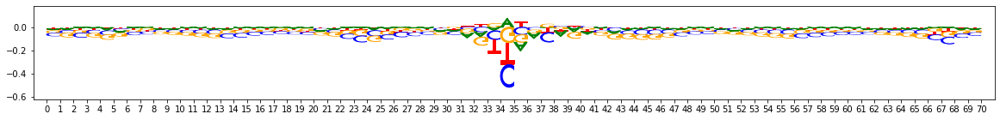

Task 0 actual importance scores:


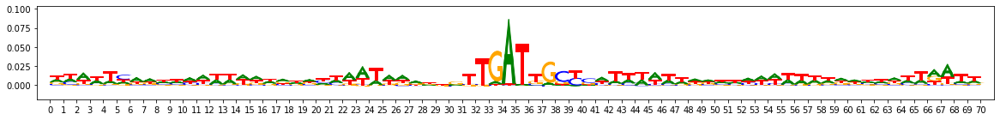

onehot, fwd and rev:


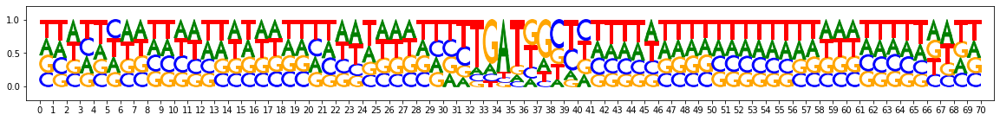

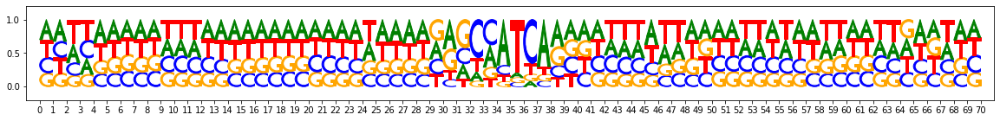

metacluster_0 pattern_1
total seqlets: 6683
Task 0 hypothetical scores:


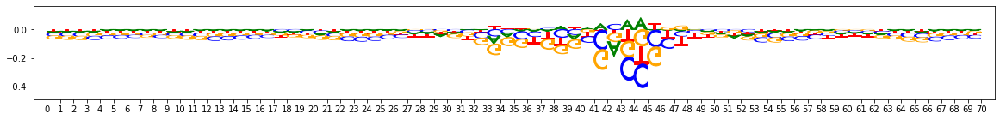

Task 0 actual importance scores:


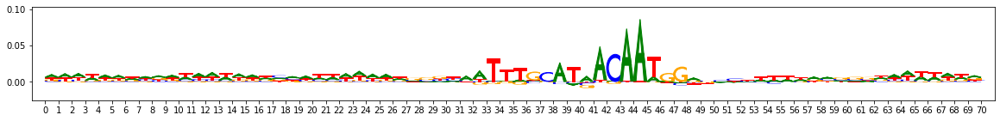

onehot, fwd and rev:


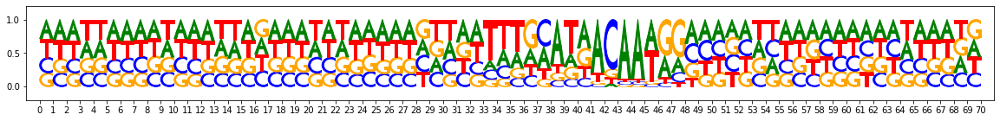

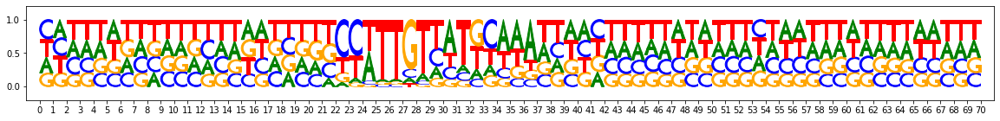

metacluster_0 pattern_2
total seqlets: 4598
Task 0 hypothetical scores:


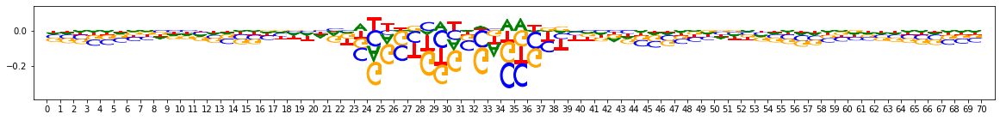

Task 0 actual importance scores:


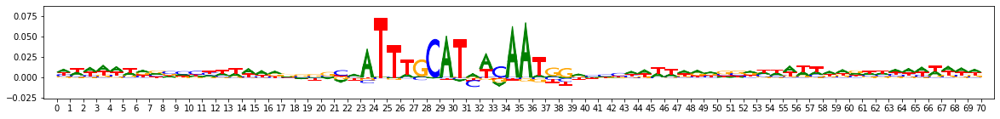

onehot, fwd and rev:


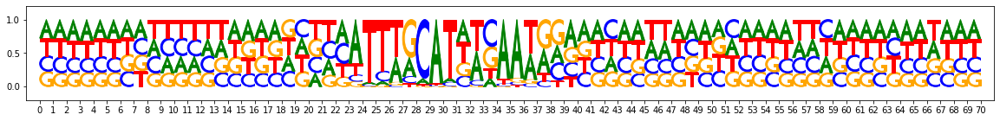

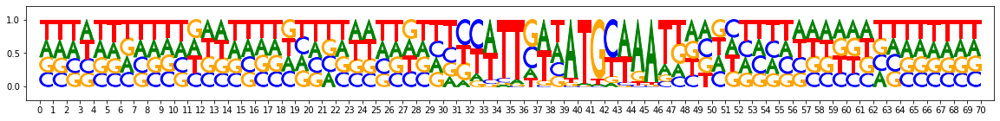

metacluster_0 pattern_3
total seqlets: 1819
Task 0 hypothetical scores:


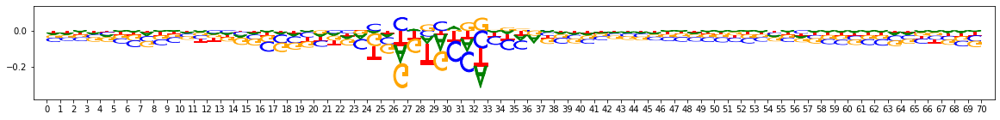

Task 0 actual importance scores:


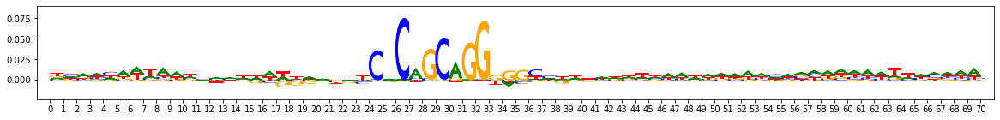

onehot, fwd and rev:


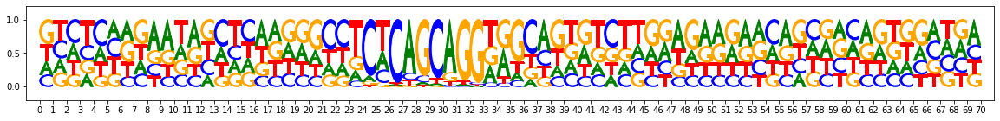

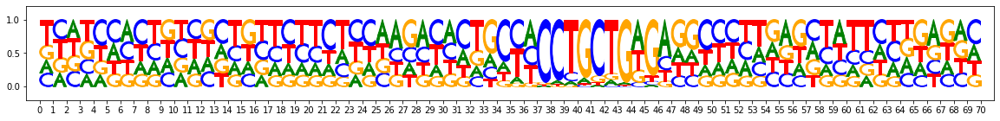

metacluster_0 pattern_4
total seqlets: 1806
Task 0 hypothetical scores:


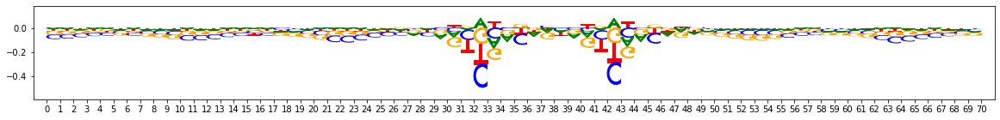

Task 0 actual importance scores:


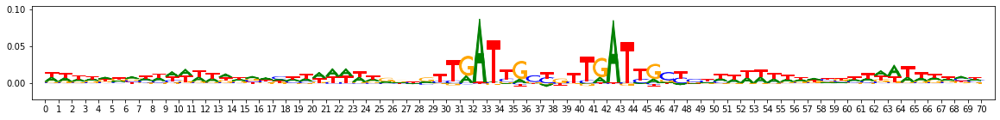

onehot, fwd and rev:


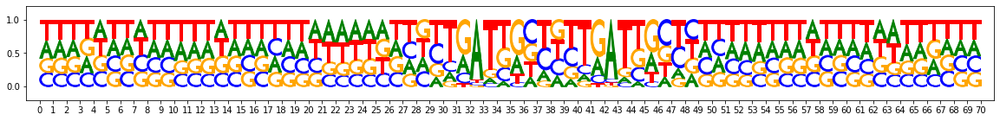

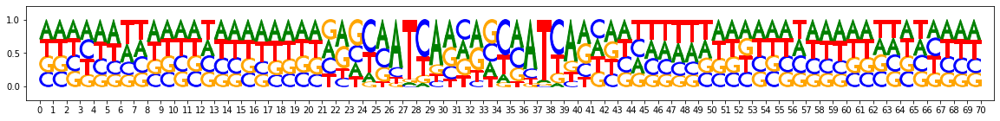

metacluster_0 pattern_5
total seqlets: 1529
Task 0 hypothetical scores:


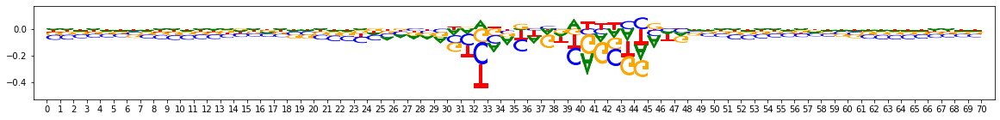

Task 0 actual importance scores:


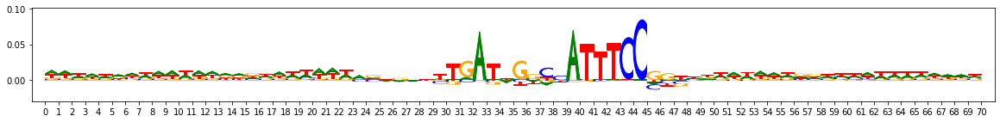

onehot, fwd and rev:


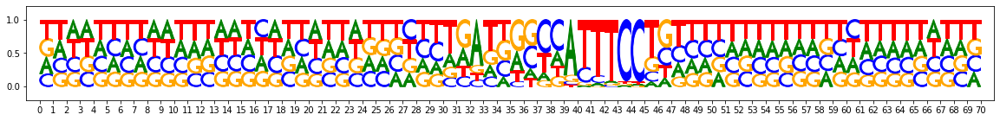

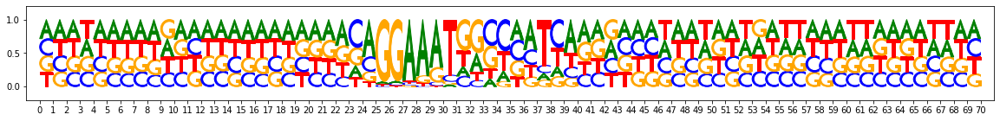

metacluster_0 pattern_6
total seqlets: 1506
Task 0 hypothetical scores:


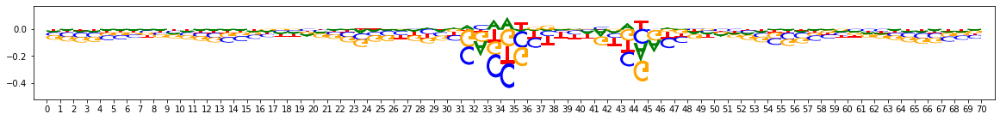

Task 0 actual importance scores:


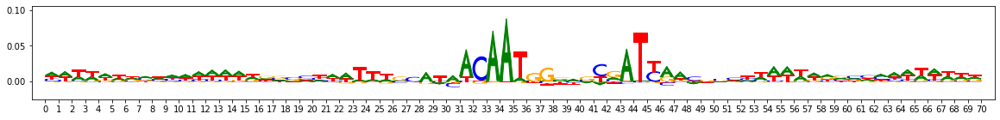

onehot, fwd and rev:


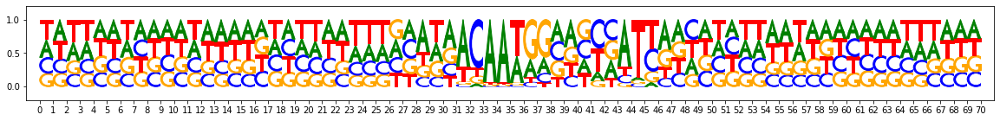

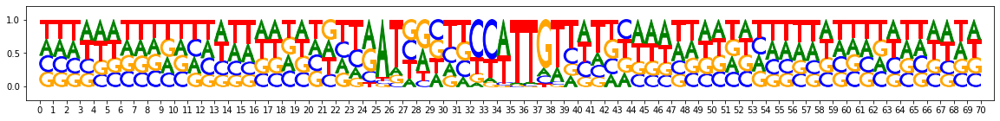

metacluster_0 pattern_7
total seqlets: 1266
Task 0 hypothetical scores:


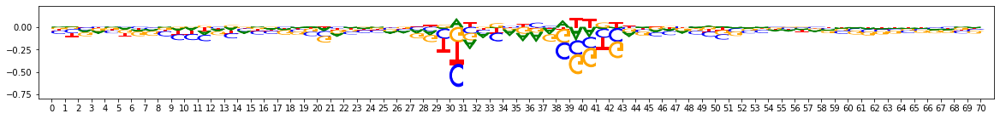

Task 0 actual importance scores:


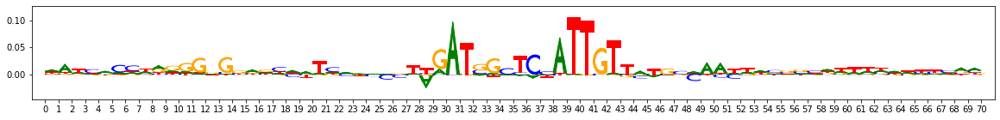

onehot, fwd and rev:


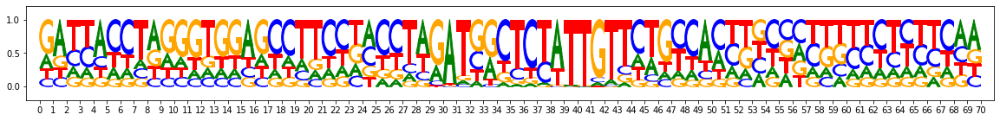

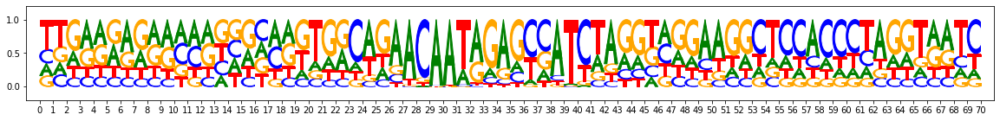

metacluster_0 pattern_8
total seqlets: 1001
Task 0 hypothetical scores:


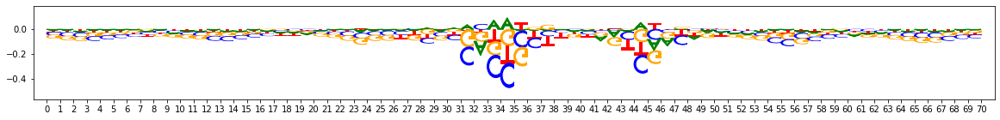

Task 0 actual importance scores:


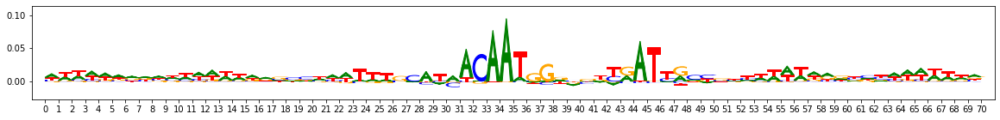

onehot, fwd and rev:


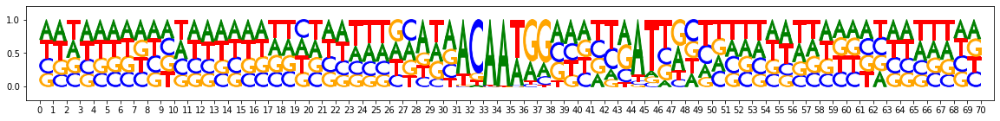

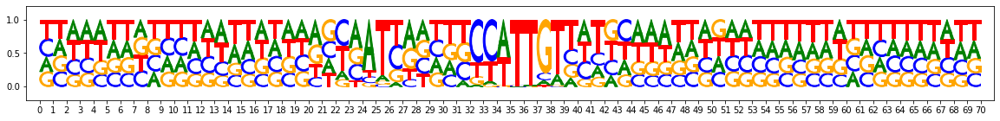

metacluster_0 pattern_9
total seqlets: 744
Task 0 hypothetical scores:


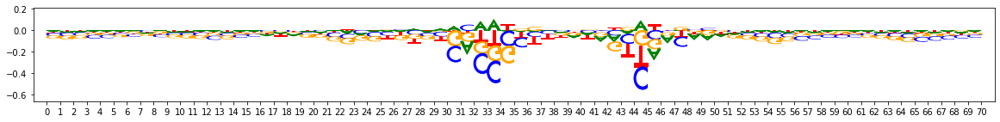

Task 0 actual importance scores:


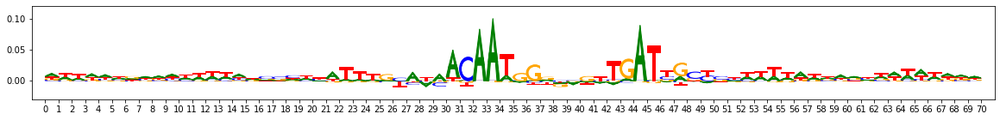

onehot, fwd and rev:


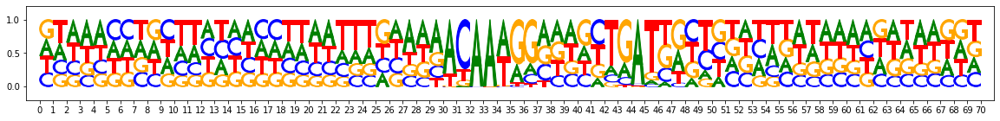

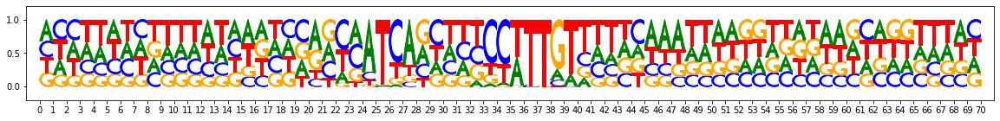

metacluster_0 pattern_10
total seqlets: 485
Task 0 hypothetical scores:


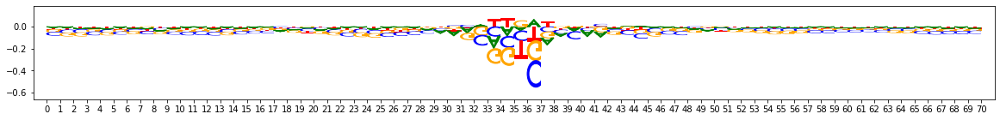

Task 0 actual importance scores:


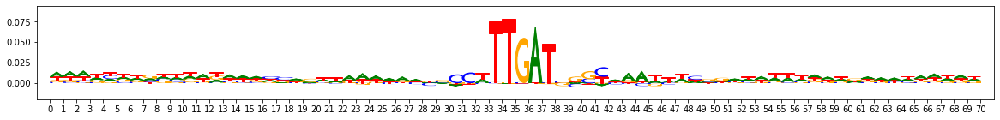

onehot, fwd and rev:


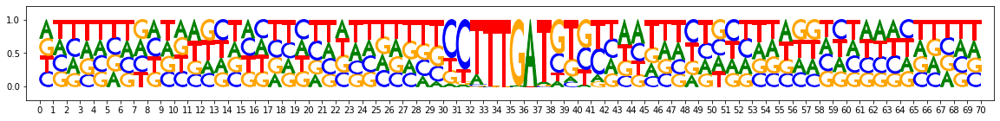

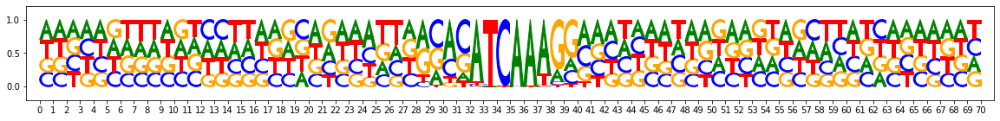

metacluster_0 pattern_11
total seqlets: 486
Task 0 hypothetical scores:


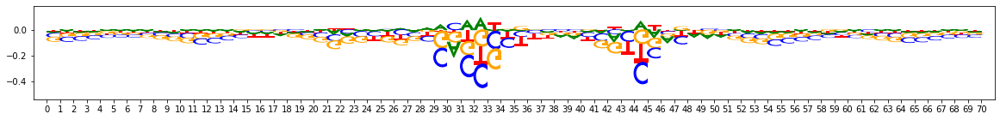

Task 0 actual importance scores:


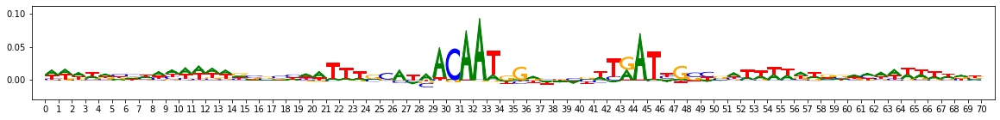

onehot, fwd and rev:


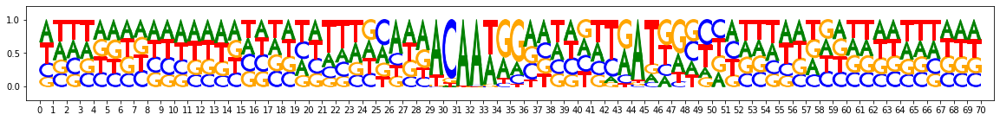

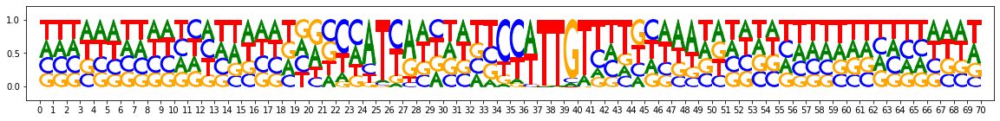

metacluster_0 pattern_12
total seqlets: 462
Task 0 hypothetical scores:


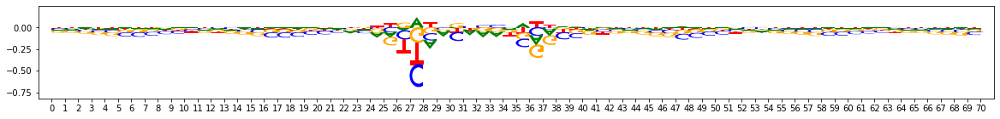

Task 0 actual importance scores:


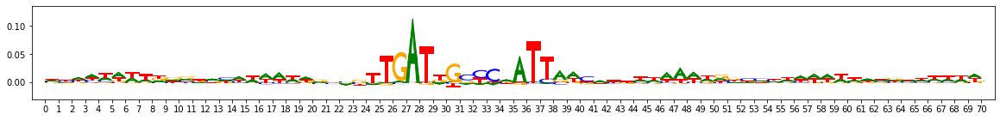

onehot, fwd and rev:


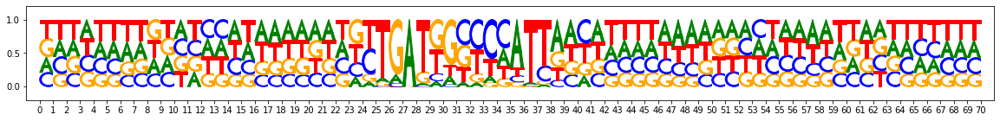

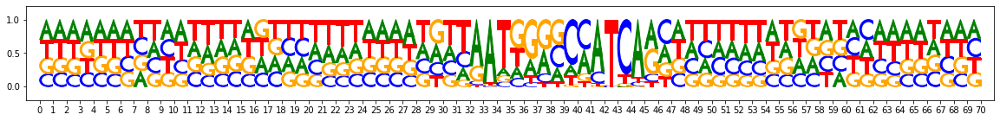

metacluster_0 pattern_13
total seqlets: 415
Task 0 hypothetical scores:


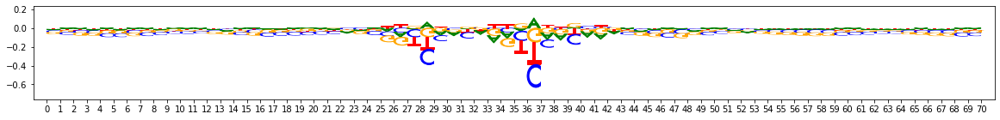

Task 0 actual importance scores:


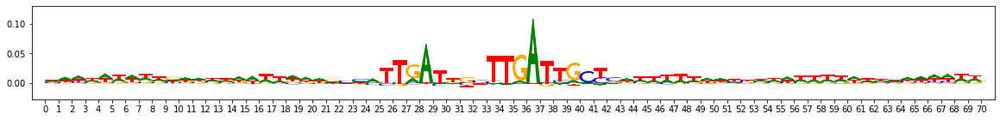

onehot, fwd and rev:


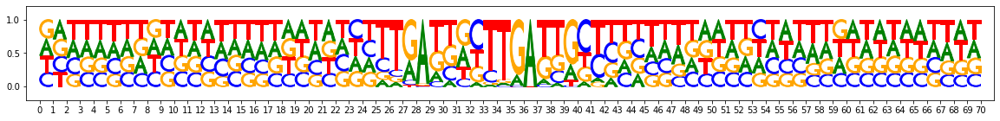

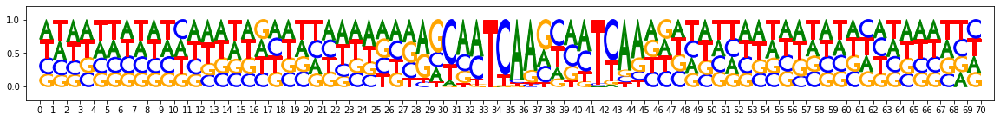

metacluster_0 pattern_14
total seqlets: 390
Task 0 hypothetical scores:


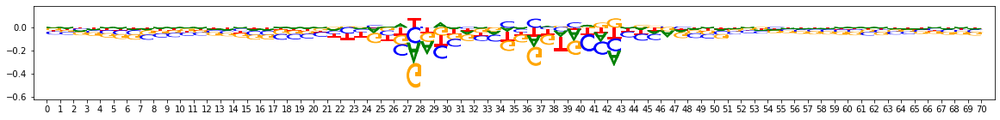

Task 0 actual importance scores:


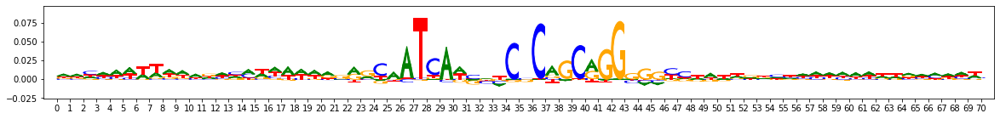

onehot, fwd and rev:


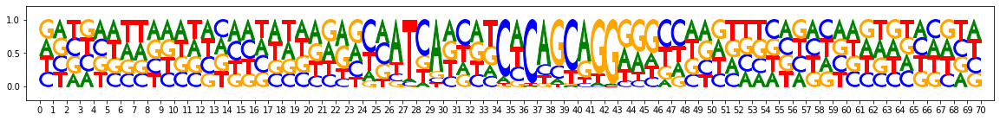

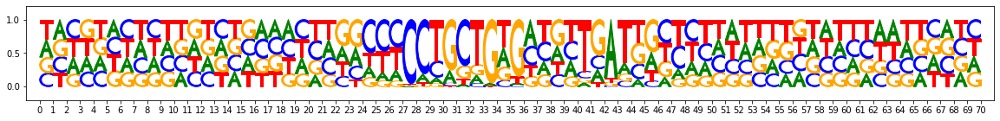

metacluster_0 pattern_15
total seqlets: 325
Task 0 hypothetical scores:


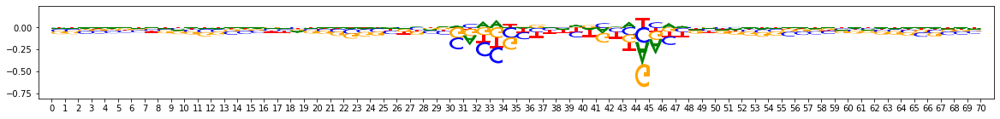

Task 0 actual importance scores:


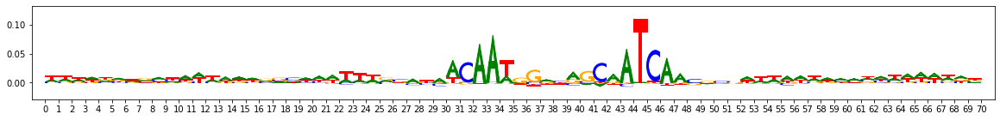

onehot, fwd and rev:


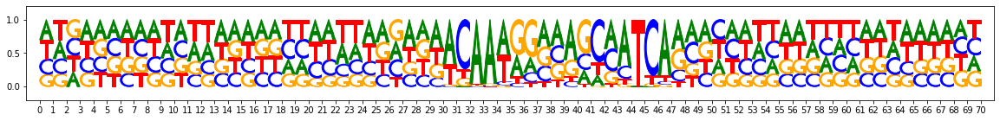

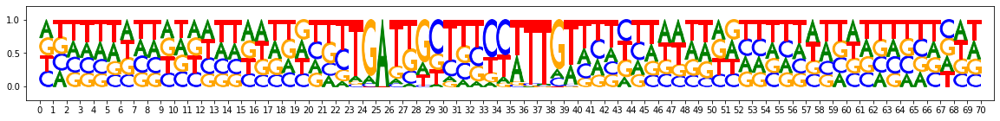

metacluster_0 pattern_16
total seqlets: 308
Task 0 hypothetical scores:


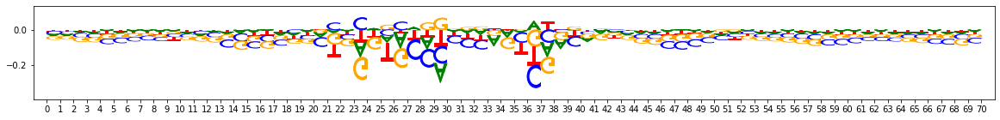

Task 0 actual importance scores:


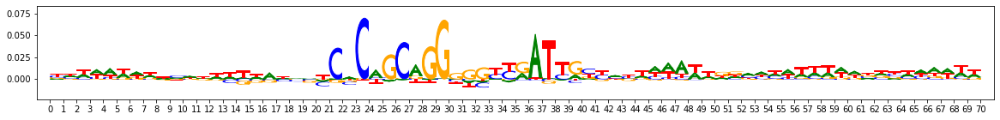

onehot, fwd and rev:


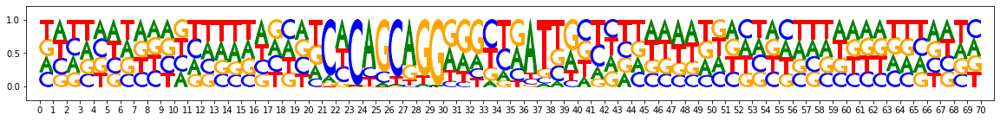

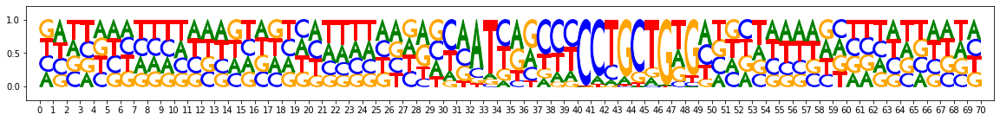

metacluster_0 pattern_17
total seqlets: 342
Task 0 hypothetical scores:


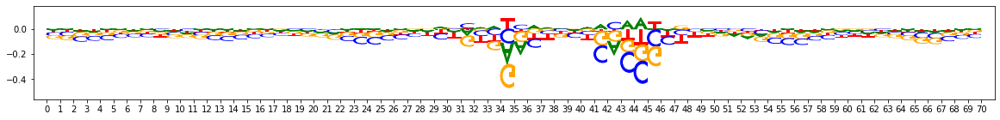

Task 0 actual importance scores:


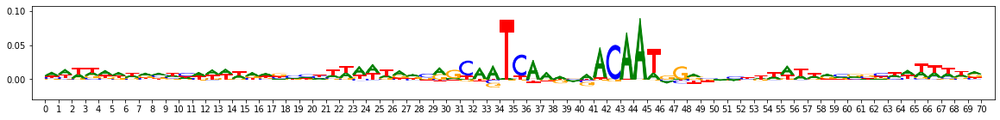

onehot, fwd and rev:


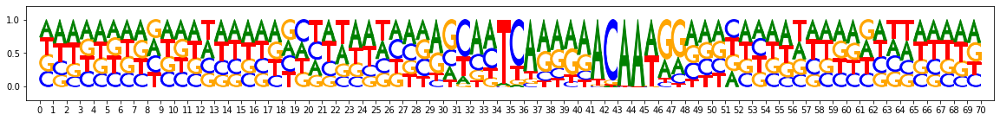

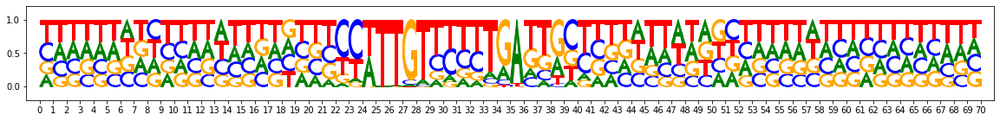

metacluster_0 pattern_18
total seqlets: 276
Task 0 hypothetical scores:


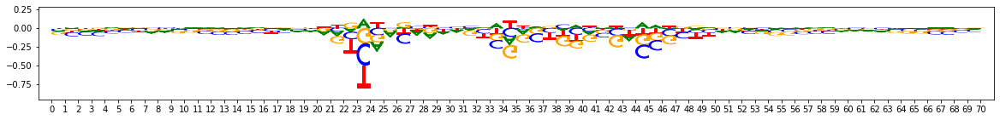

Task 0 actual importance scores:


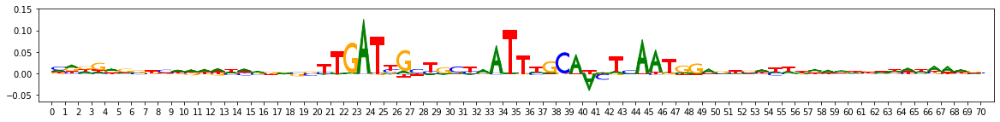

onehot, fwd and rev:


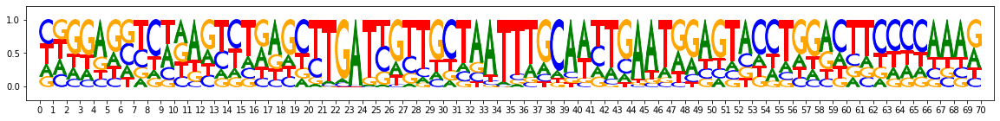

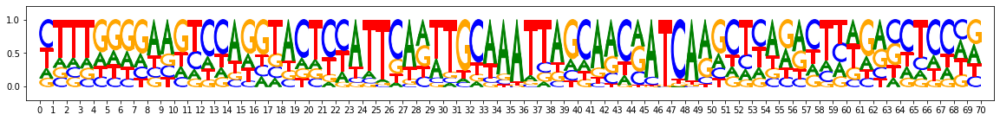

metacluster_0 pattern_19
total seqlets: 258
Task 0 hypothetical scores:


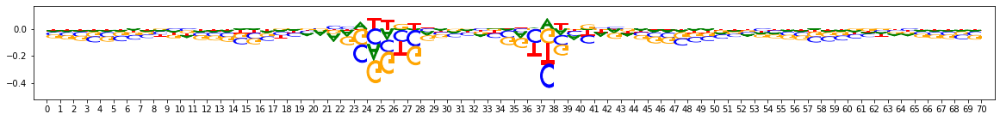

Task 0 actual importance scores:


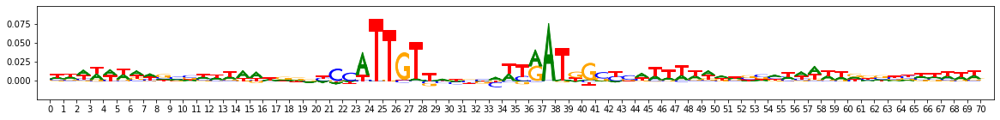

onehot, fwd and rev:


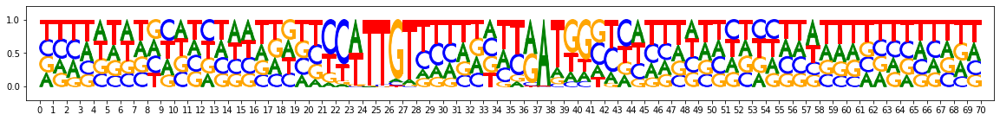

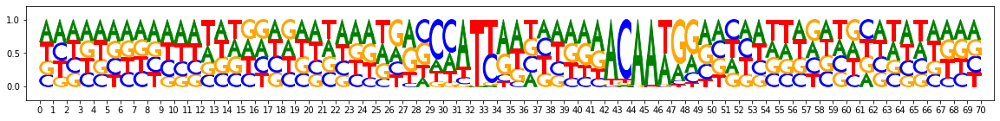

metacluster_0 pattern_20
total seqlets: 231
Task 0 hypothetical scores:


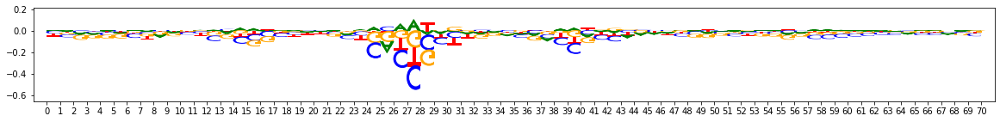

Task 0 actual importance scores:


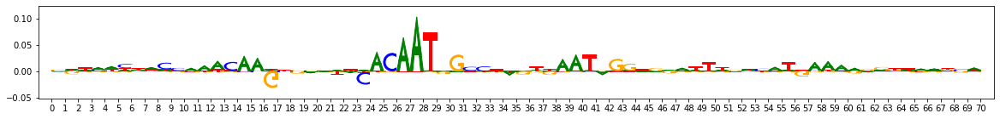

onehot, fwd and rev:


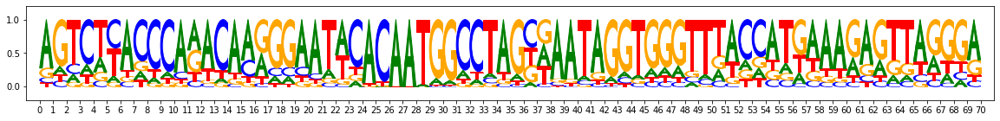

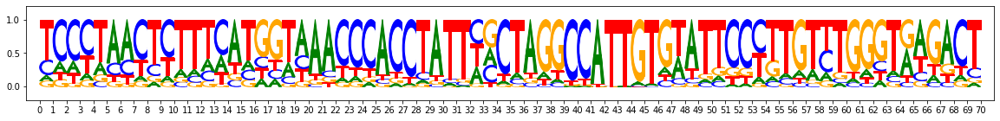

metacluster_0 pattern_21
total seqlets: 237
Task 0 hypothetical scores:


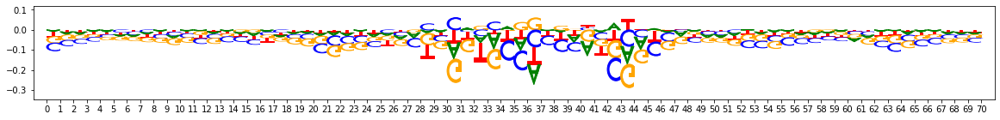

Task 0 actual importance scores:


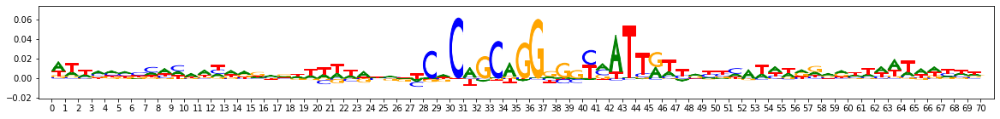

onehot, fwd and rev:


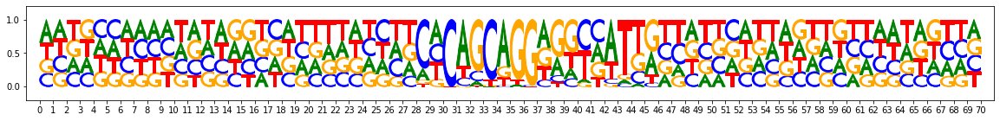

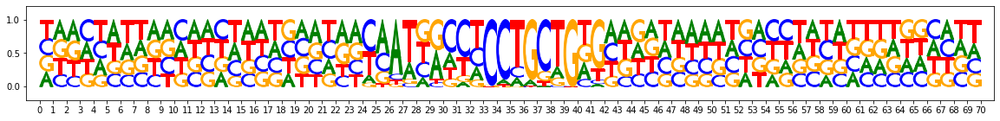

metacluster_0 pattern_22
total seqlets: 275
Task 0 hypothetical scores:


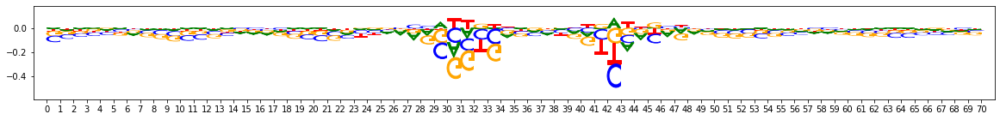

Task 0 actual importance scores:


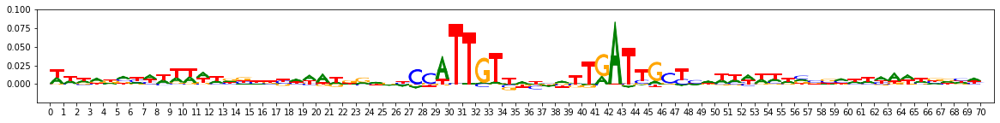

onehot, fwd and rev:


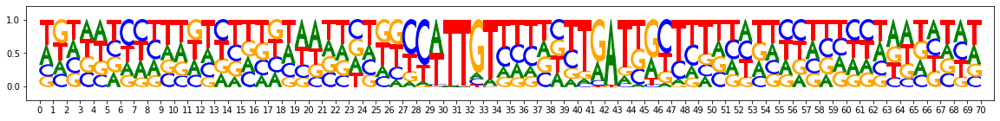

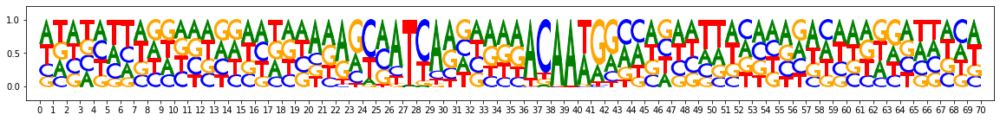

metacluster_0 pattern_23
total seqlets: 224
Task 0 hypothetical scores:


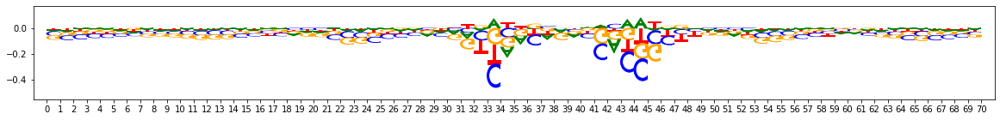

Task 0 actual importance scores:


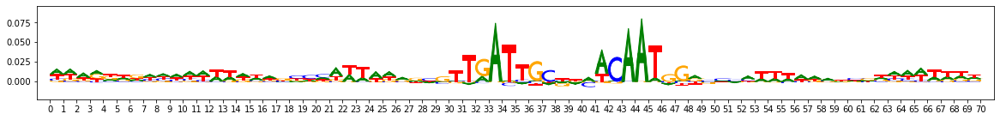

onehot, fwd and rev:


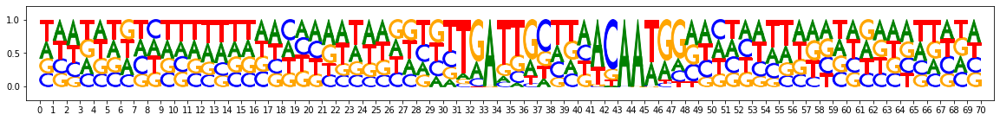

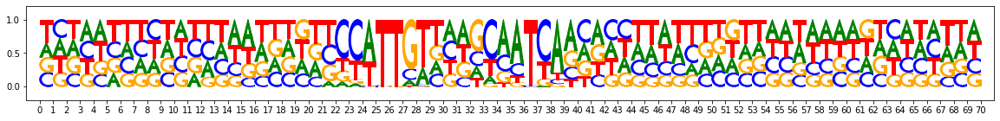

metacluster_0 pattern_24
total seqlets: 190
Task 0 hypothetical scores:


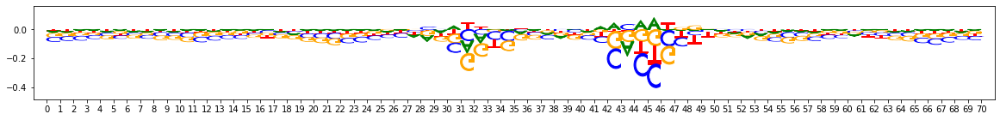

Task 0 actual importance scores:


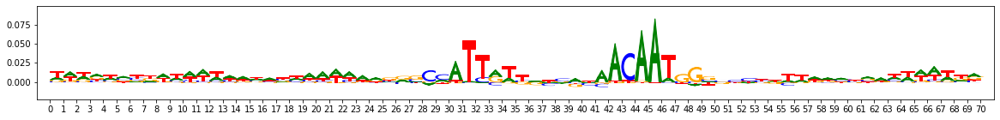

onehot, fwd and rev:


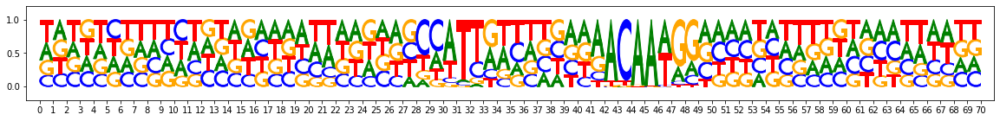

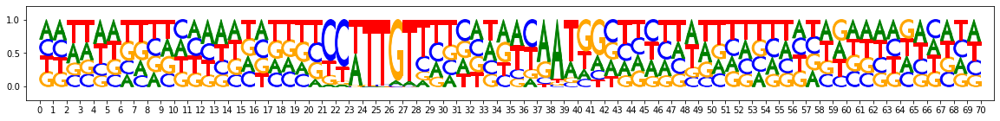

metacluster_0 pattern_25
total seqlets: 159
Task 0 hypothetical scores:


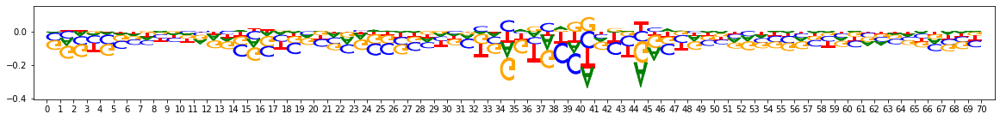

Task 0 actual importance scores:


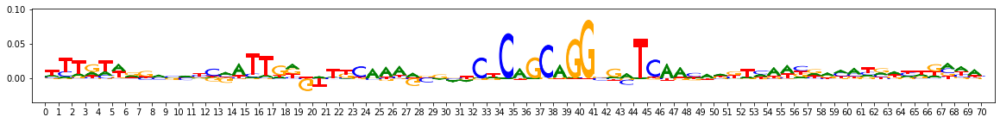

onehot, fwd and rev:


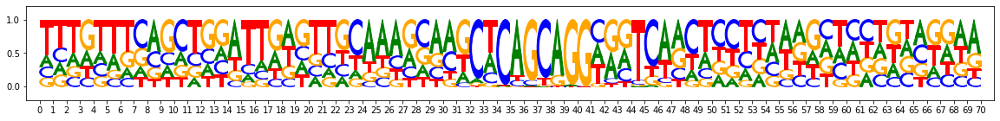

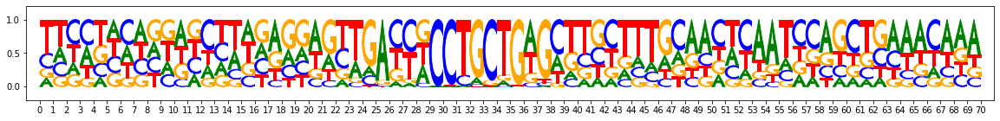

metacluster_0 pattern_26
total seqlets: 205
Task 0 hypothetical scores:


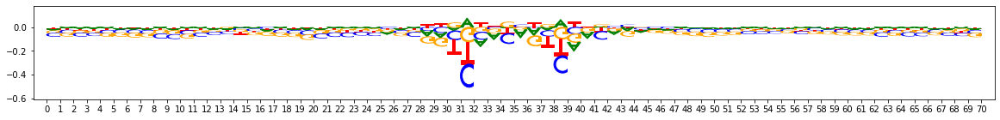

Task 0 actual importance scores:


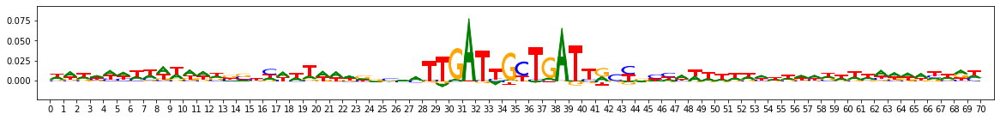

onehot, fwd and rev:


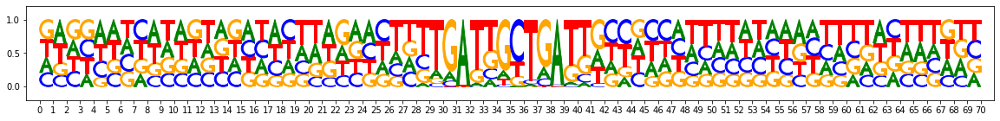

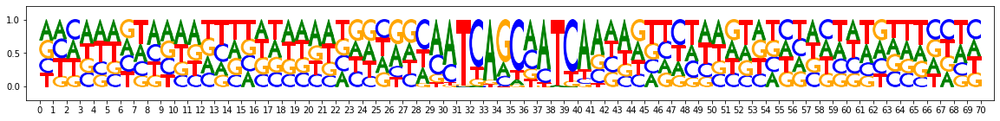

metacluster_0 pattern_27
total seqlets: 159
Task 0 hypothetical scores:


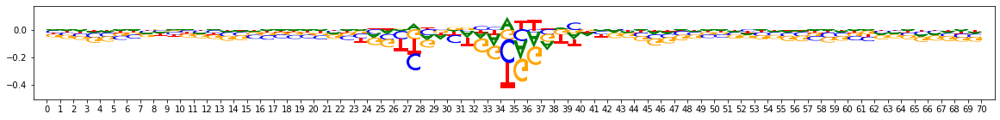

Task 0 actual importance scores:


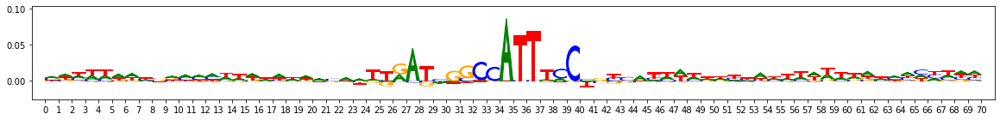

onehot, fwd and rev:


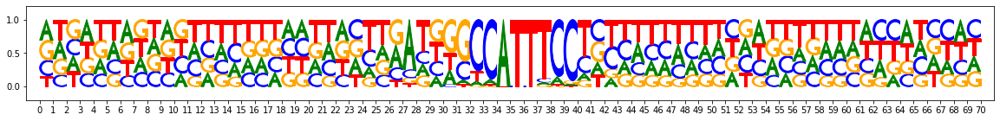

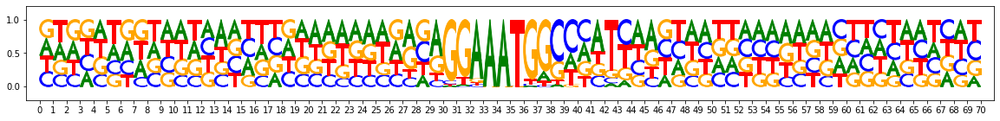

metacluster_0 pattern_28
total seqlets: 164
Task 0 hypothetical scores:


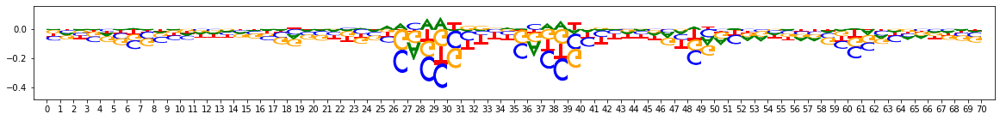

Task 0 actual importance scores:


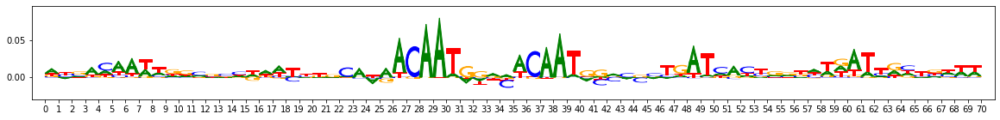

onehot, fwd and rev:


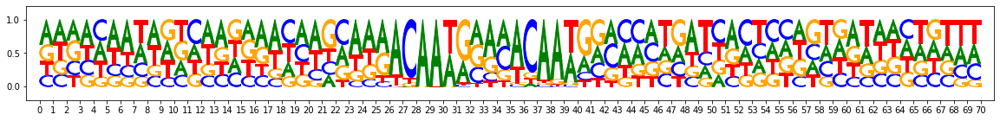

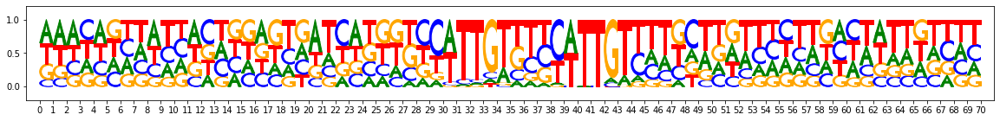

metacluster_0 pattern_29
total seqlets: 142
Task 0 hypothetical scores:


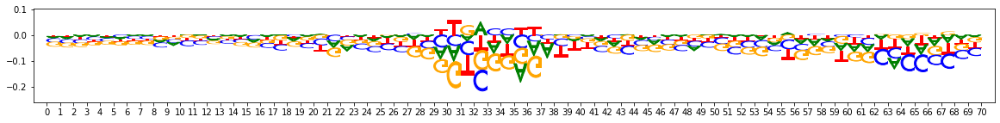

Task 0 actual importance scores:


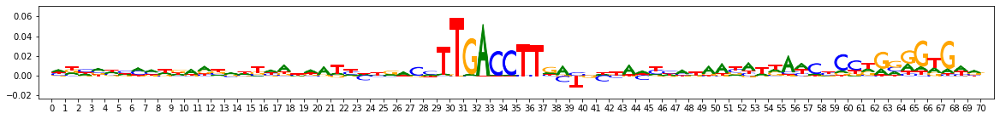

onehot, fwd and rev:


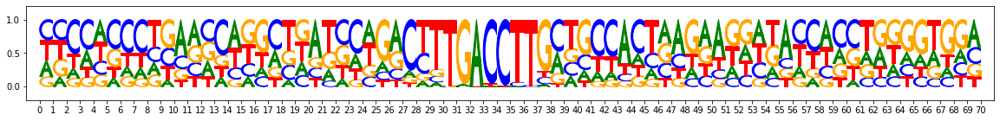

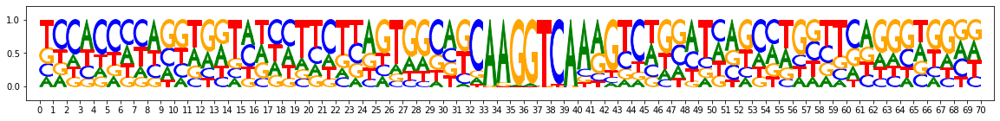

metacluster_0 pattern_30
total seqlets: 132
Task 0 hypothetical scores:


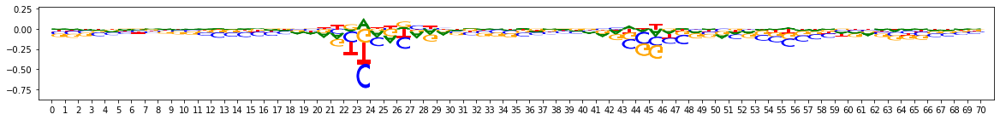

Task 0 actual importance scores:


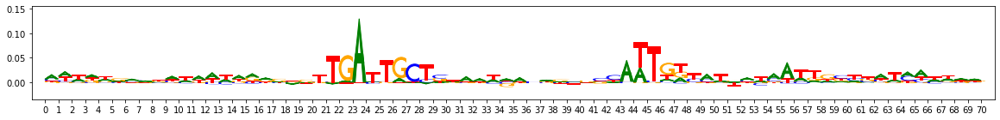

onehot, fwd and rev:


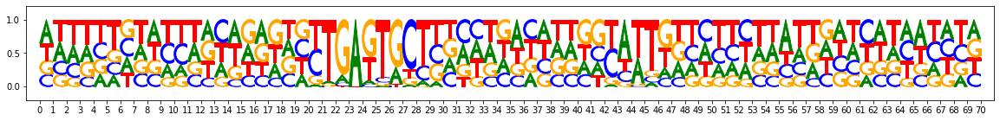

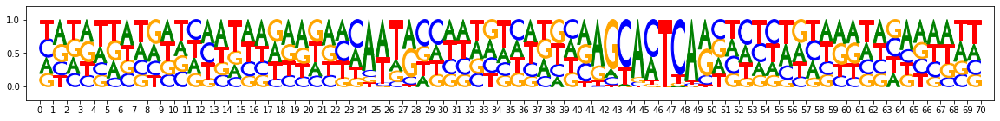

metacluster_0 pattern_31
total seqlets: 119
Task 0 hypothetical scores:


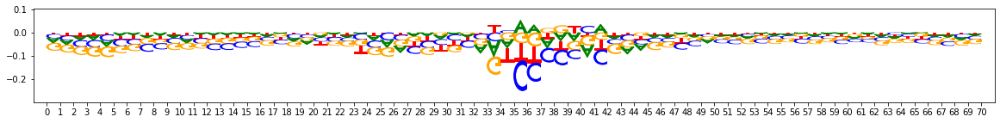

Task 0 actual importance scores:


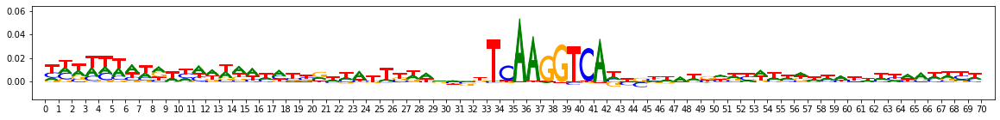

onehot, fwd and rev:


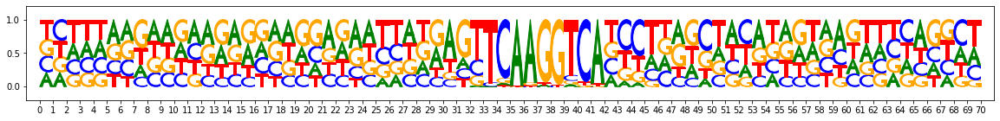

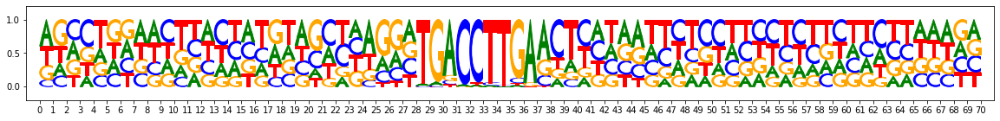

metacluster_0 pattern_32
total seqlets: 113
Task 0 hypothetical scores:


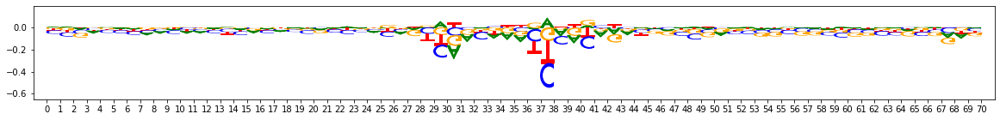

Task 0 actual importance scores:


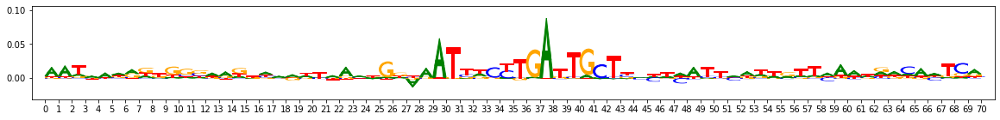

onehot, fwd and rev:


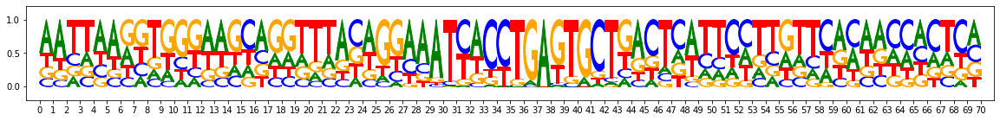

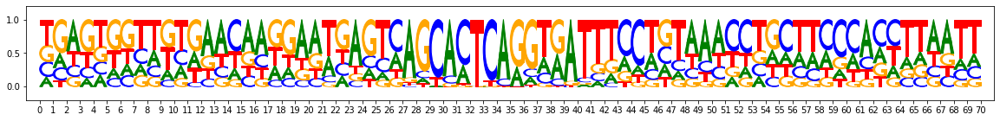

metacluster_0 pattern_33
total seqlets: 109
Task 0 hypothetical scores:


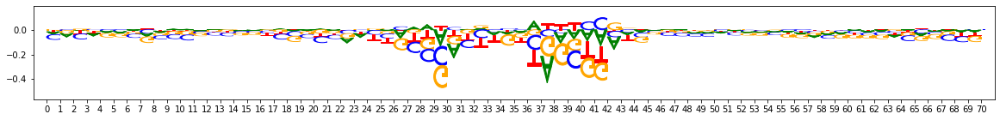

Task 0 actual importance scores:


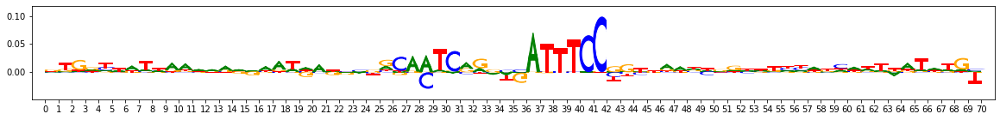

onehot, fwd and rev:


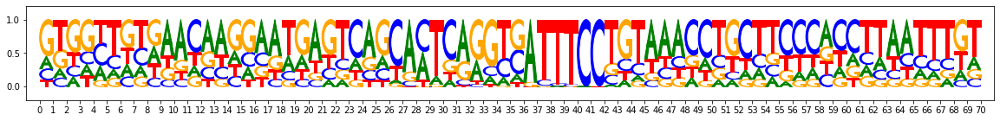

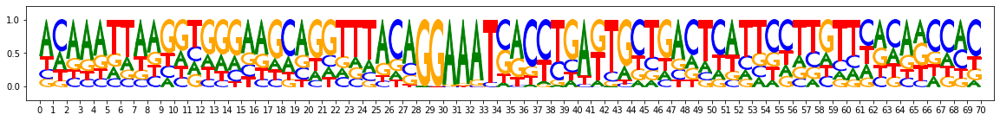

metacluster_0 pattern_34
total seqlets: 118
Task 0 hypothetical scores:


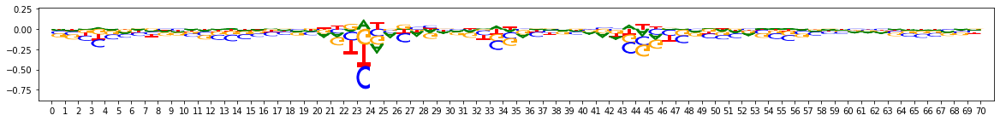

Task 0 actual importance scores:


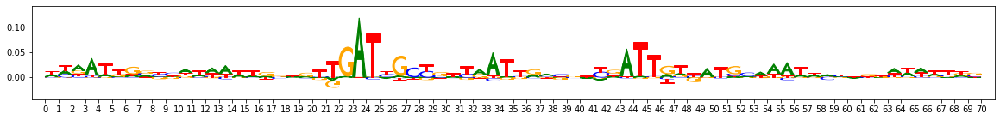

onehot, fwd and rev:


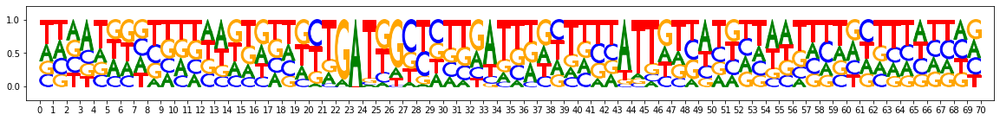

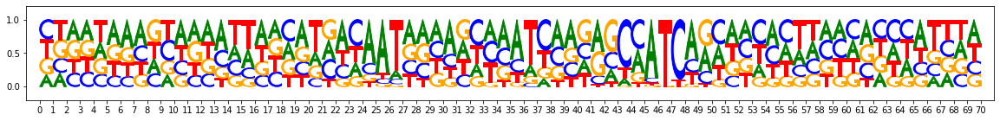

metacluster_0 pattern_35
total seqlets: 129
Task 0 hypothetical scores:


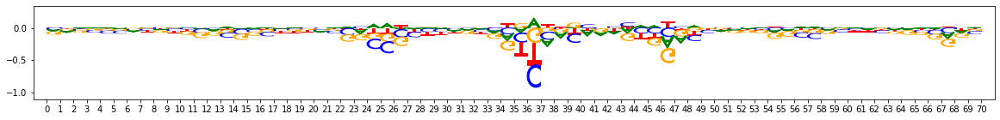

Task 0 actual importance scores:


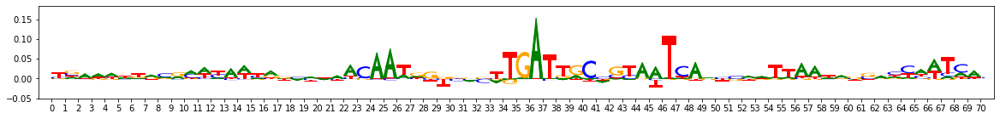

onehot, fwd and rev:


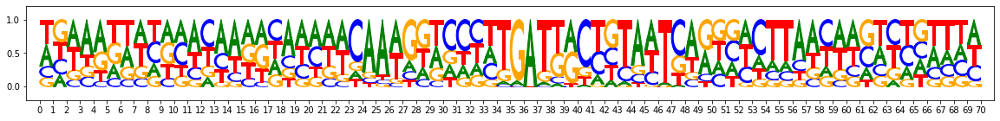

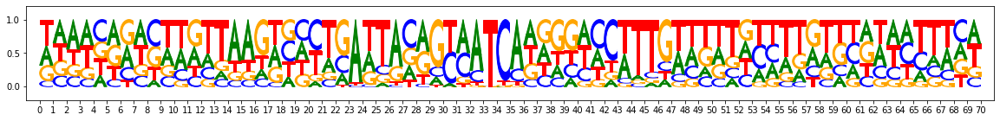

metacluster_0 pattern_36
total seqlets: 117
Task 0 hypothetical scores:


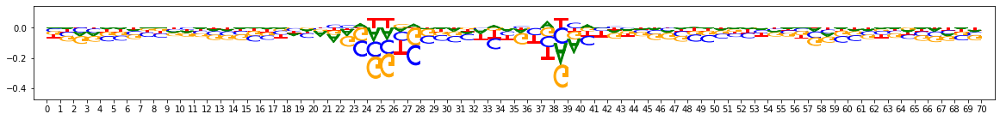

Task 0 actual importance scores:


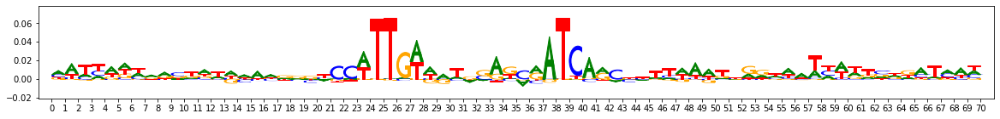

onehot, fwd and rev:


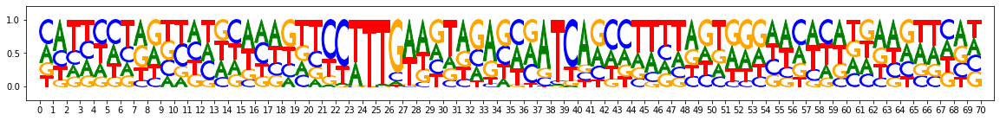

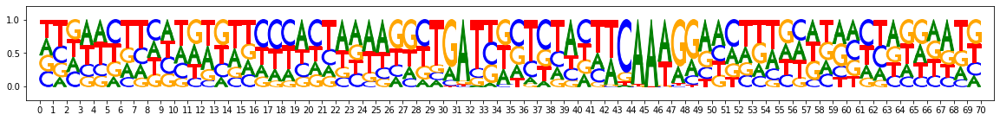

metacluster_0 pattern_37
total seqlets: 123
Task 0 hypothetical scores:


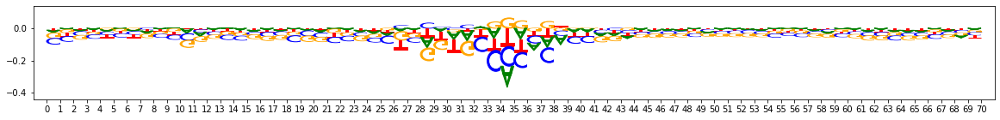

Task 0 actual importance scores:


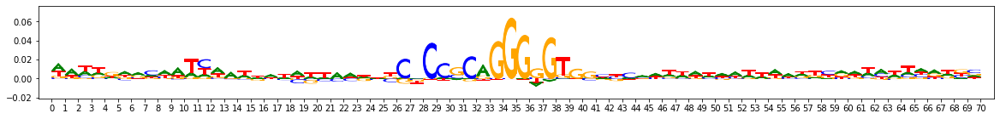

onehot, fwd and rev:


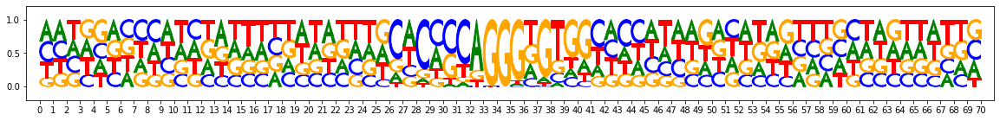

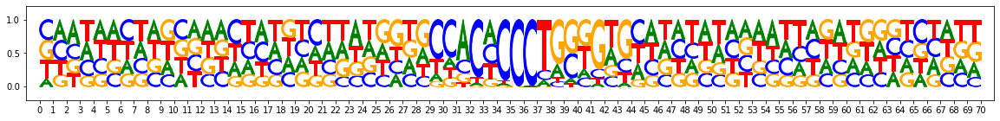

metacluster_0 pattern_38
total seqlets: 116
Task 0 hypothetical scores:


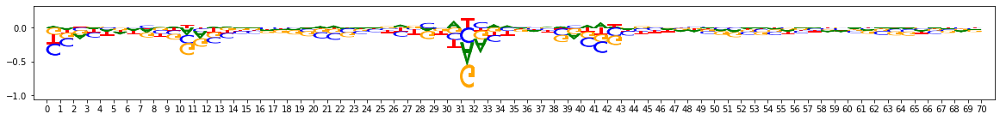

Task 0 actual importance scores:


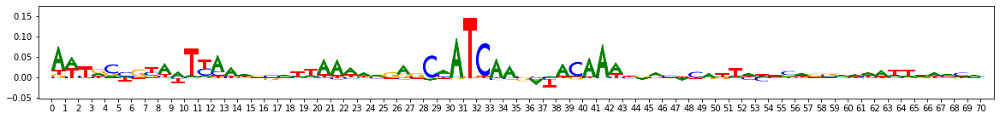

onehot, fwd and rev:


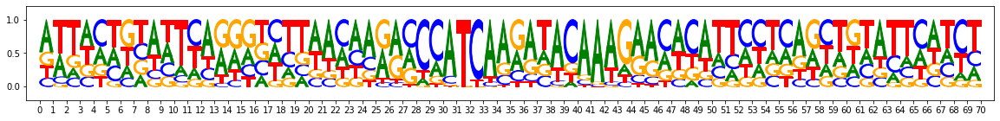

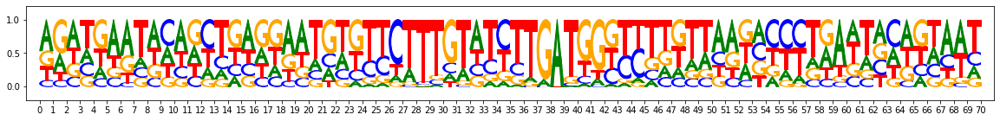

metacluster_0 pattern_39
total seqlets: 111
Task 0 hypothetical scores:


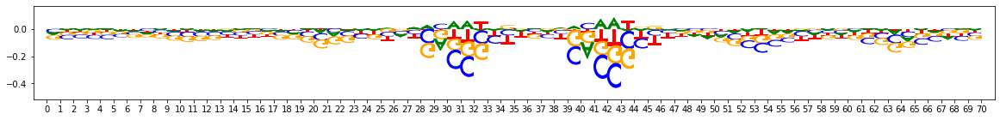

Task 0 actual importance scores:


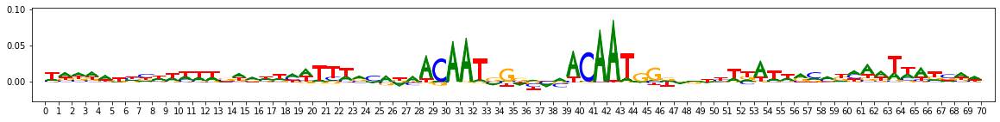

onehot, fwd and rev:


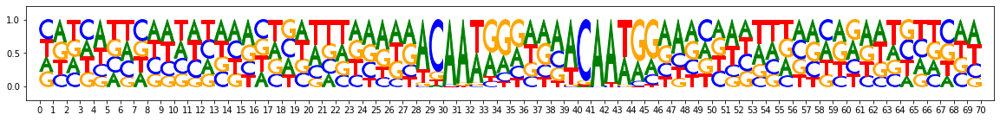

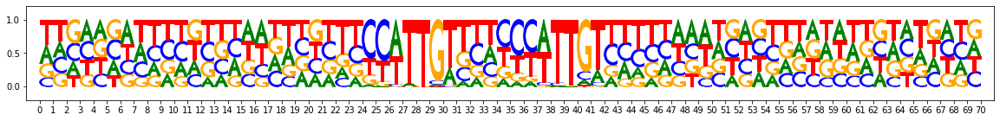

metacluster_0 pattern_40
total seqlets: 115
Task 0 hypothetical scores:


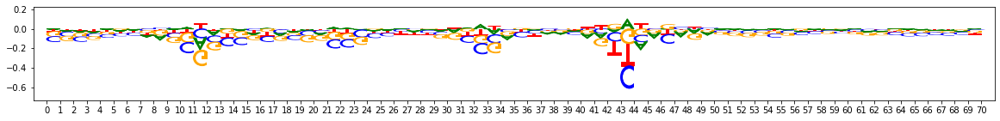

Task 0 actual importance scores:


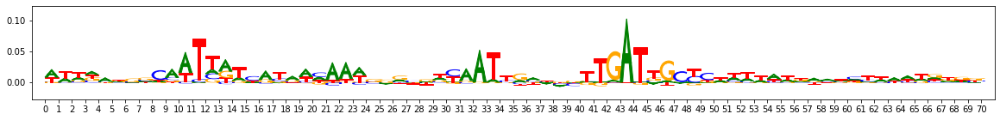

onehot, fwd and rev:


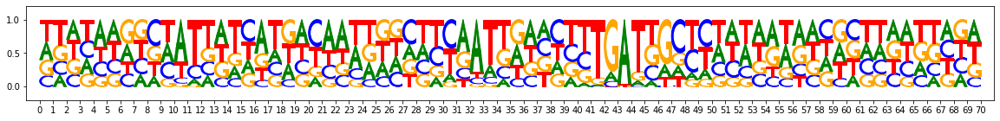

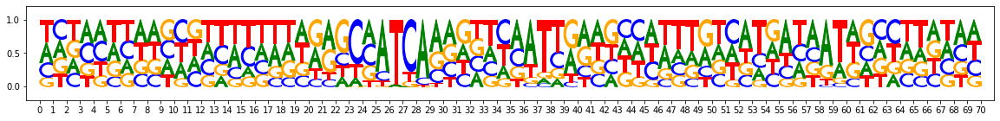

metacluster_0 pattern_41
total seqlets: 123
Task 0 hypothetical scores:


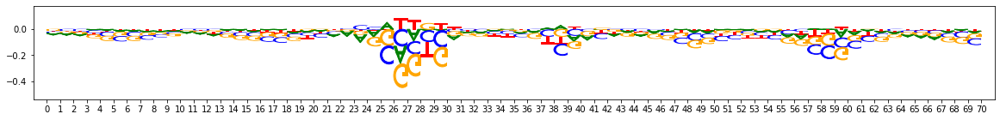

Task 0 actual importance scores:


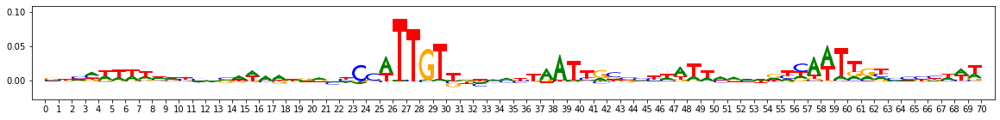

onehot, fwd and rev:


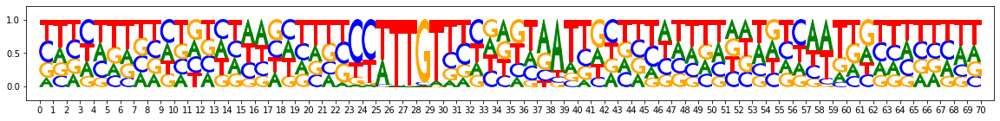

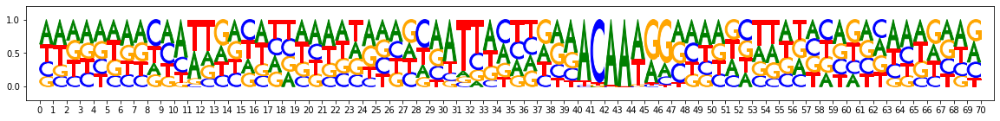

metacluster_0 pattern_42
total seqlets: 122
Task 0 hypothetical scores:


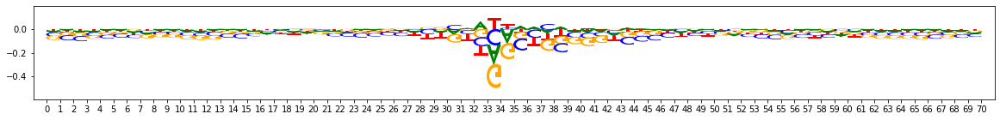

Task 0 actual importance scores:


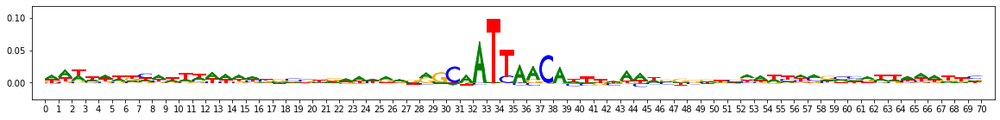

onehot, fwd and rev:


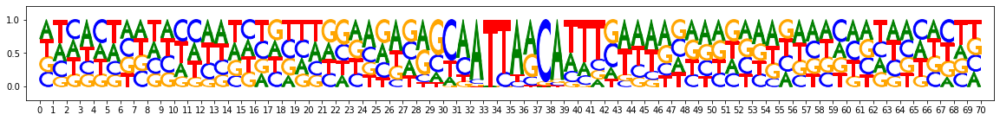

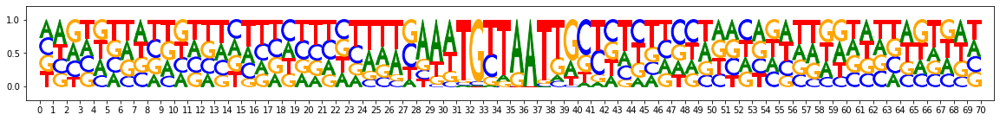

metacluster_0 pattern_43
total seqlets: 99
Task 0 hypothetical scores:


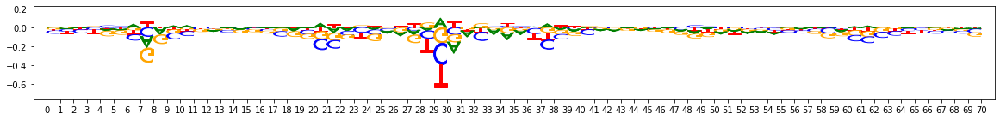

Task 0 actual importance scores:


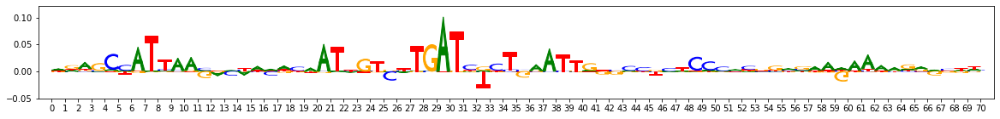

onehot, fwd and rev:


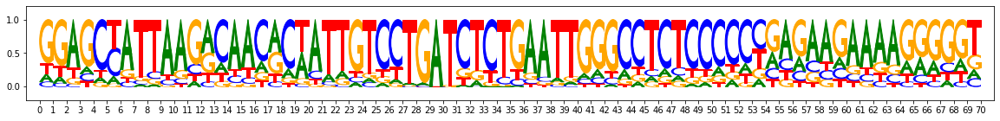

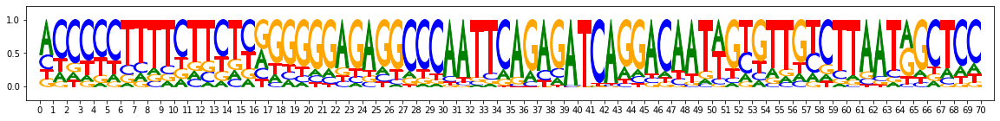

metacluster_0 pattern_44
total seqlets: 100
Task 0 hypothetical scores:


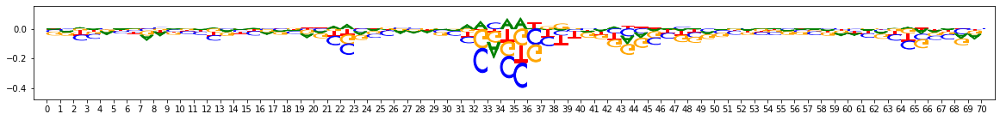

Task 0 actual importance scores:


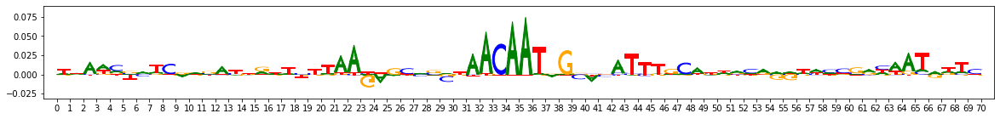

onehot, fwd and rev:


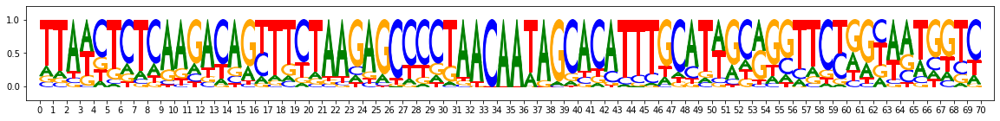

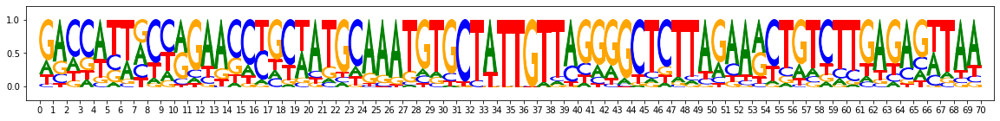

metacluster_0 pattern_45
total seqlets: 83
Task 0 hypothetical scores:


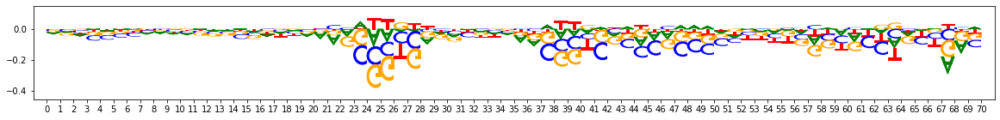

Task 0 actual importance scores:


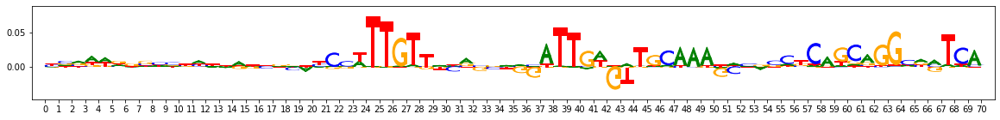

onehot, fwd and rev:


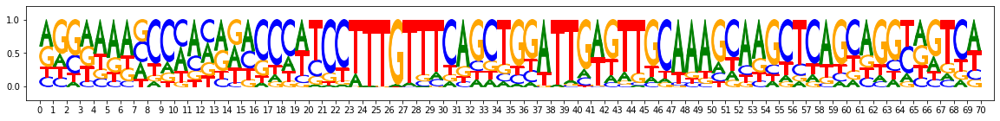

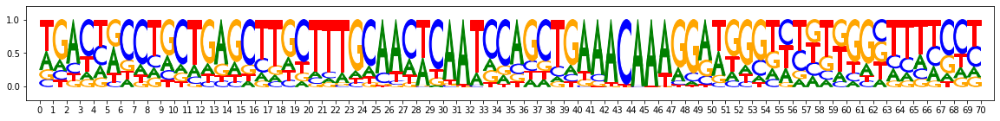

metacluster_0 pattern_46
total seqlets: 86
Task 0 hypothetical scores:


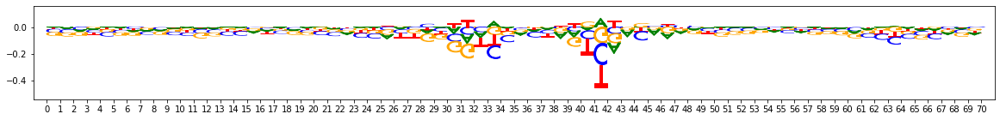

Task 0 actual importance scores:


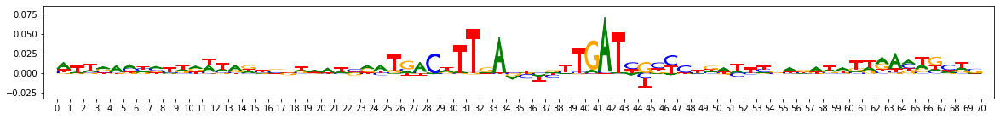

onehot, fwd and rev:


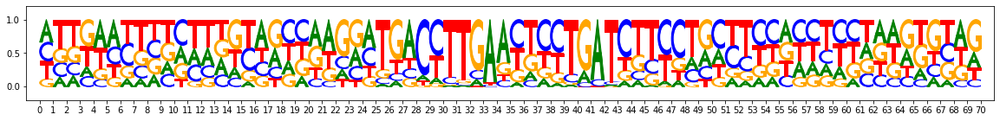

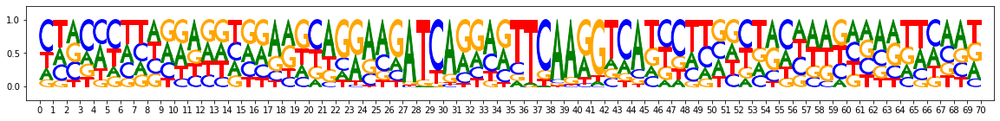

metacluster_0 pattern_47
total seqlets: 87
Task 0 hypothetical scores:


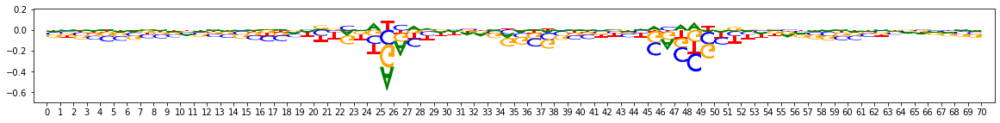

Task 0 actual importance scores:


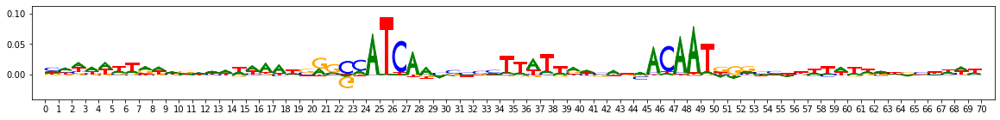

onehot, fwd and rev:


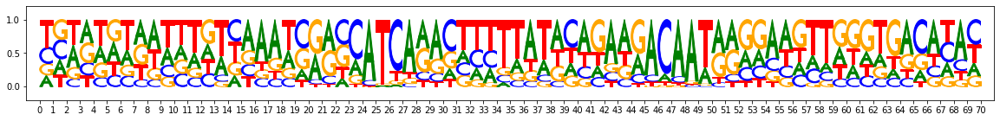

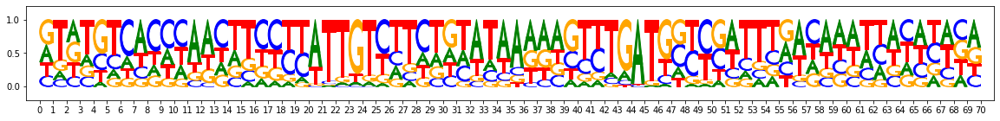

metacluster_0 pattern_48
total seqlets: 79
Task 0 hypothetical scores:


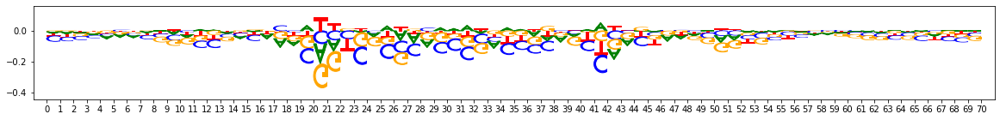

Task 0 actual importance scores:


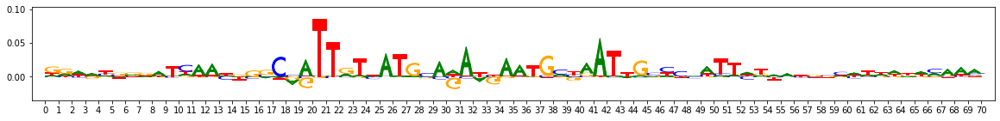

onehot, fwd and rev:


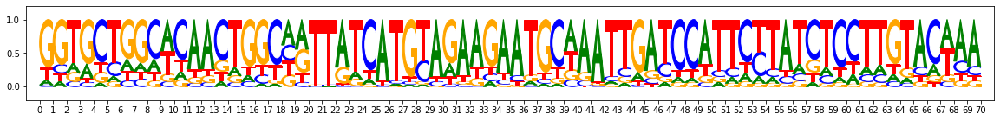

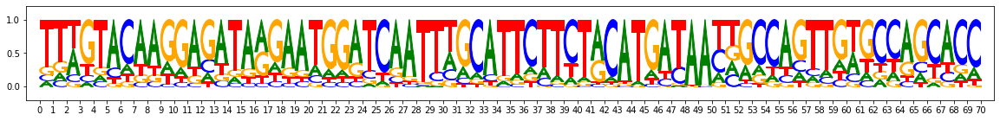

metacluster_0 pattern_49
total seqlets: 80
Task 0 hypothetical scores:


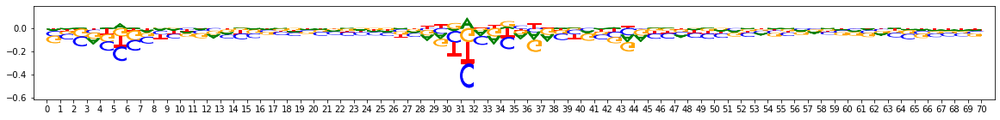

Task 0 actual importance scores:


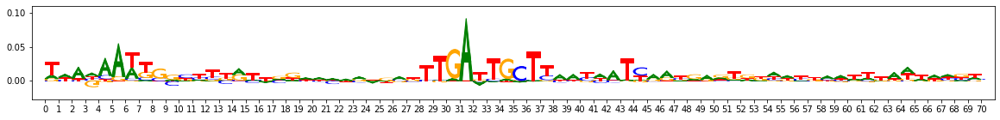

onehot, fwd and rev:


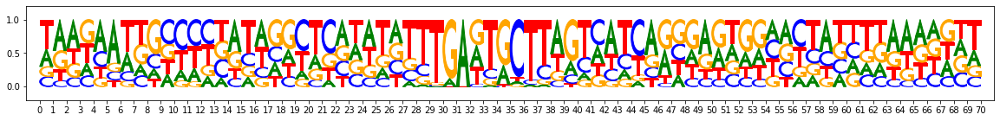

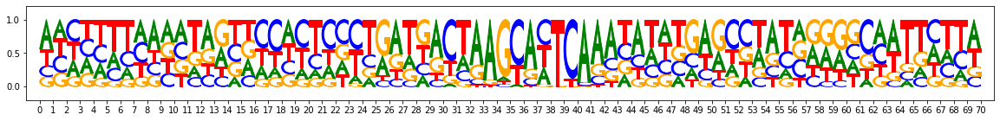

metacluster_0 pattern_50
total seqlets: 72
Task 0 hypothetical scores:


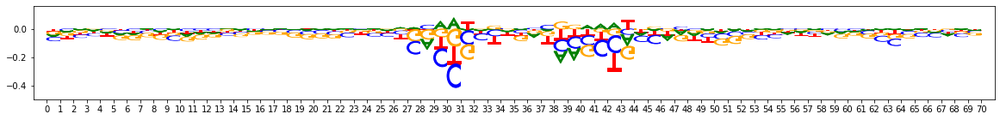

Task 0 actual importance scores:


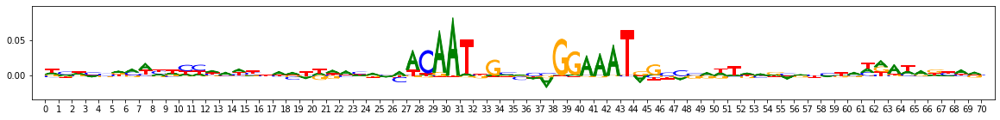

onehot, fwd and rev:


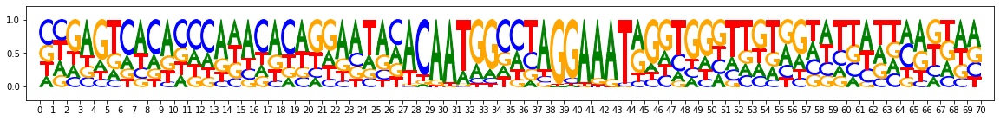

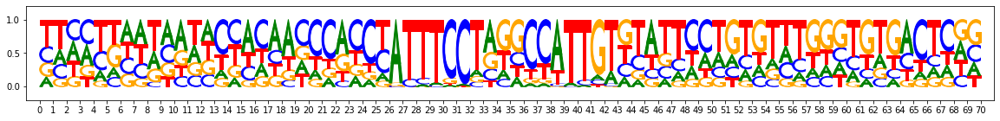

metacluster_0 pattern_51
total seqlets: 81
Task 0 hypothetical scores:


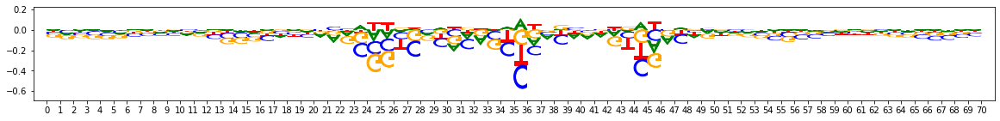

Task 0 actual importance scores:


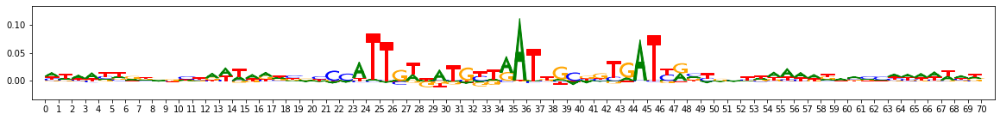

onehot, fwd and rev:


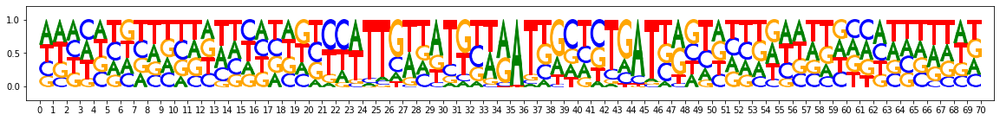

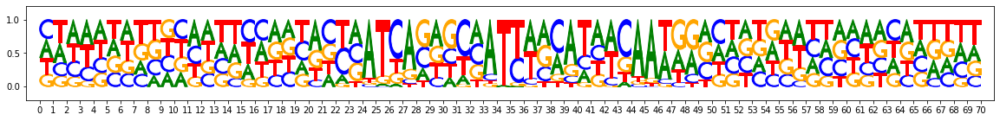

metacluster_0 pattern_52
total seqlets: 107
Task 0 hypothetical scores:


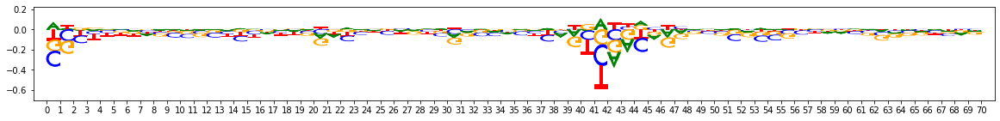

Task 0 actual importance scores:


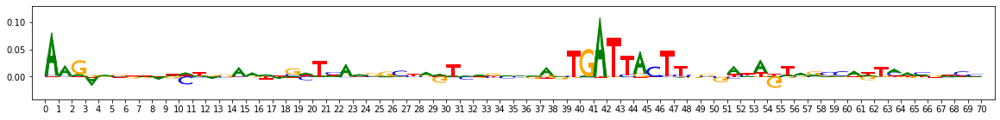

onehot, fwd and rev:


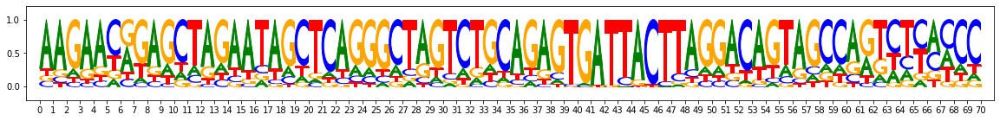

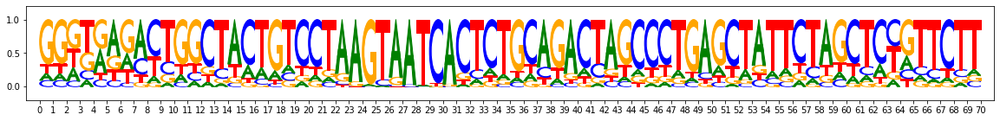

metacluster_0 pattern_53
total seqlets: 84
Task 0 hypothetical scores:


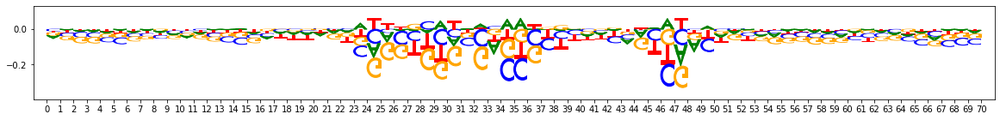

Task 0 actual importance scores:


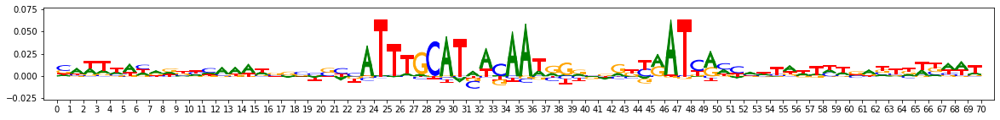

onehot, fwd and rev:


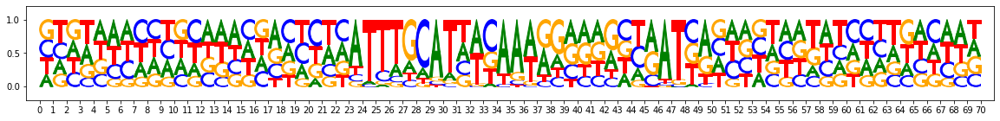

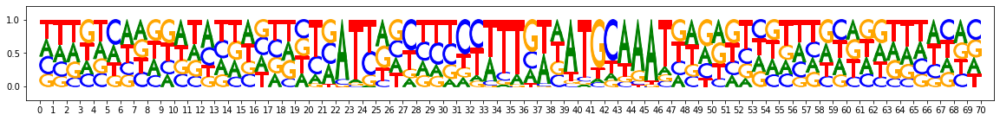

metacluster_0 pattern_54
total seqlets: 66
Task 0 hypothetical scores:


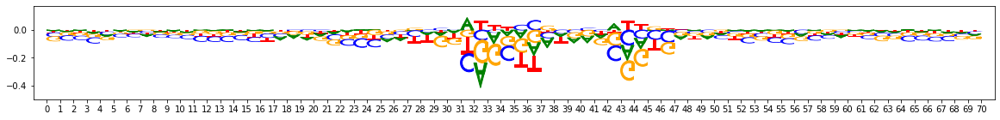

Task 0 actual importance scores:


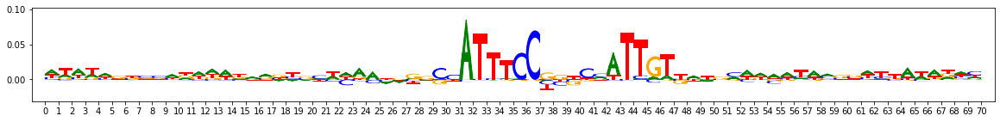

onehot, fwd and rev:


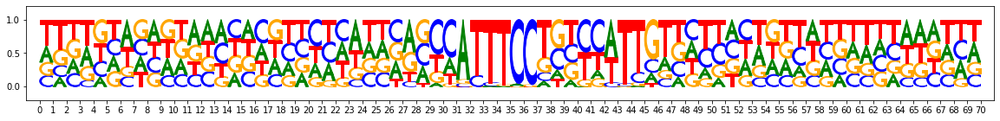

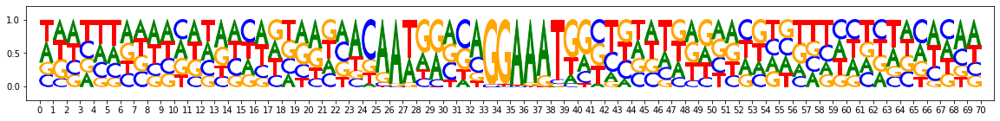

In [21]:
from modisco.visualization import viz_sequence
%matplotlib inline

hdf5_results = h5py.File(file_path,"r")

metacluster_names = [
    x.decode("utf-8") for x in 
    list(hdf5_results["metaclustering_results"]
         ["all_metacluster_names"][:])]

all_patterns = []
background = np.array([0.27, 0.23, 0.23, 0.27])

for metacluster_name in metacluster_names:
    print(metacluster_name)
    metacluster_grp = (hdf5_results["metacluster_idx_to_submetacluster_results"]
                                   [metacluster_name])
    print("activity pattern:",metacluster_grp["activity_pattern"][:])
    all_pattern_names = [x.decode("utf-8") for x in 
                         list(metacluster_grp["seqlets_to_patterns_result"]
                                             ["patterns"]["all_pattern_names"][:])]
    if (len(all_pattern_names)==0):
        print("No motifs found for this activity pattern")
    for pattern_name in all_pattern_names:
        print(metacluster_name, pattern_name)
        all_patterns.append((metacluster_name, pattern_name))
        pattern = metacluster_grp["seqlets_to_patterns_result"]["patterns"][pattern_name]
        print("total seqlets:",len(pattern["seqlets_and_alnmts"]["seqlets"]))
        print("Task 0 hypothetical scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"]["fwd"])
        print("Task 0 actual importance scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"]["fwd"])
        print("onehot, fwd and rev:")
        viz_sequence.plot_weights(np.array(pattern["sequence"]["fwd"])) 
        viz_sequence.plot_weights(np.array(pattern["sequence"]["rev"])) 
        
hdf5_results.close()

In [29]:
import h5py
import numpy as np
from importlib import reload
import modisco
reload(modisco.util)
reload(modisco.core)
reload(modisco.tfmodisco_workflow)
from modisco.tfmodisco_workflow import workflow

track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
    task_names=["Nanog_profile_wn"],
    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
    one_hot=onehot_seq)

grp = h5py.File(file_path,"r")
loaded_tfmodisco_results =\
    workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
grp.close()

Pattern idx 0
overall - num seqlets: 9456


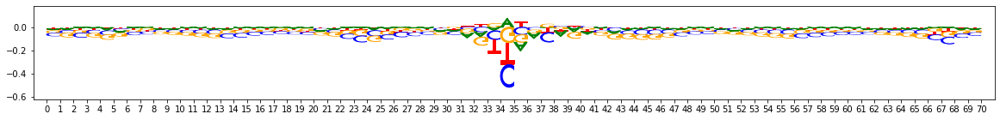

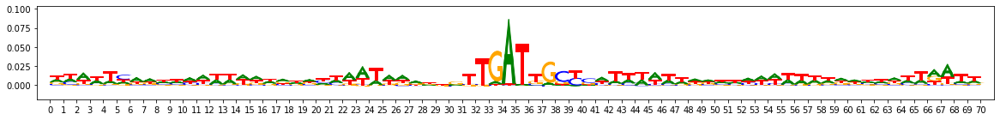

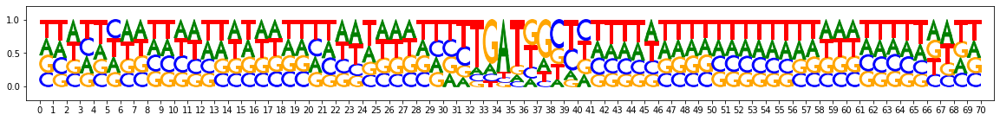

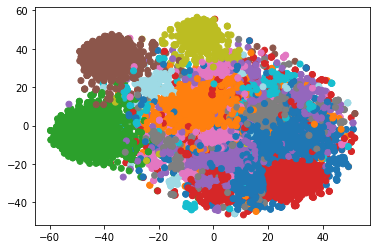

Subcluster: 0 size: 1676


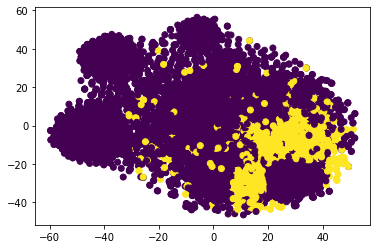

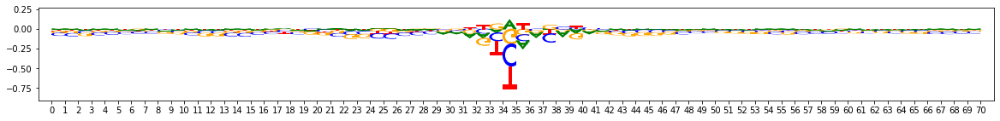

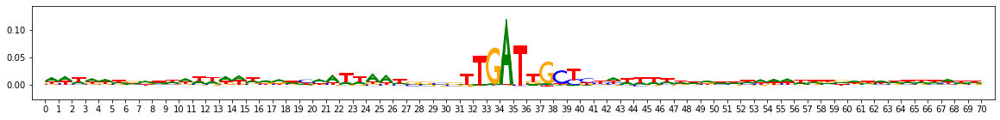

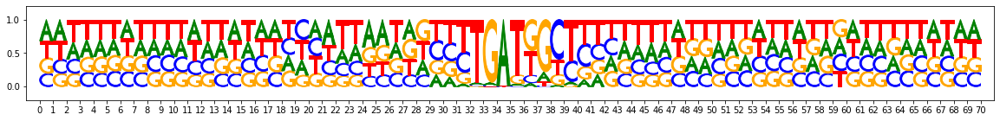

Subcluster: 1 size: 1327


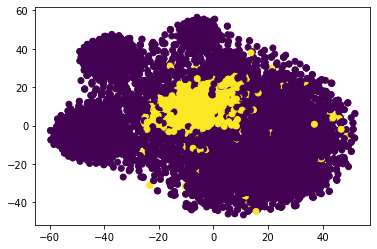

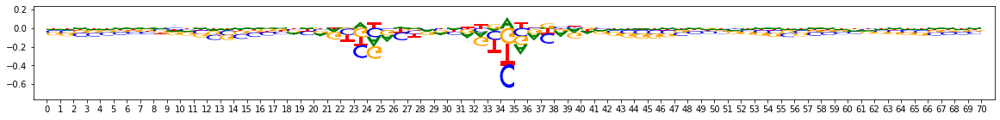

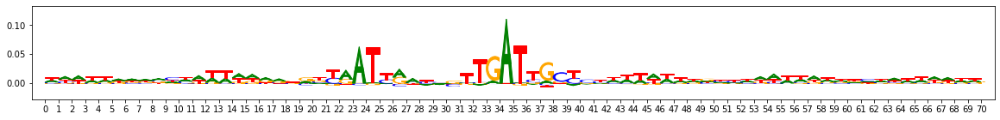

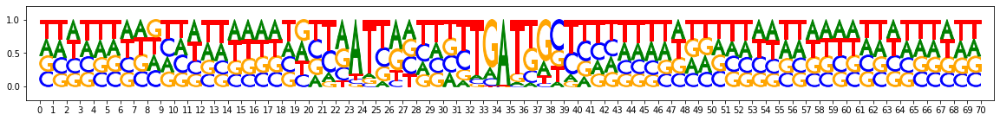

Subcluster: 2 size: 1242


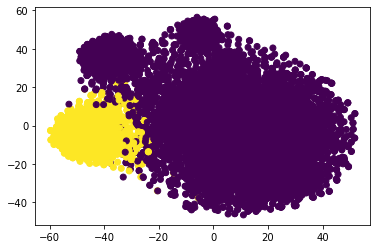

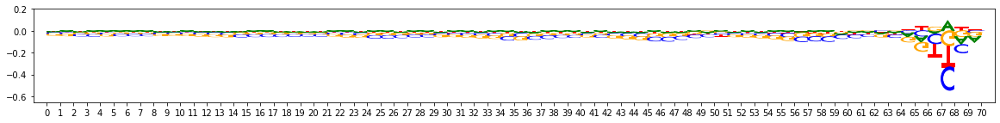

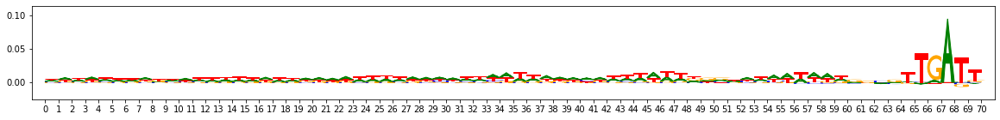

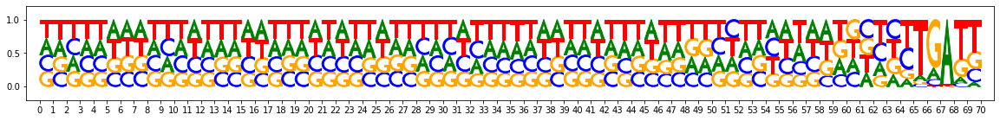

Subcluster: 3 size: 1109


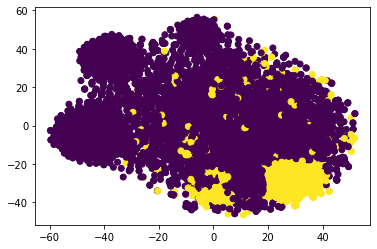

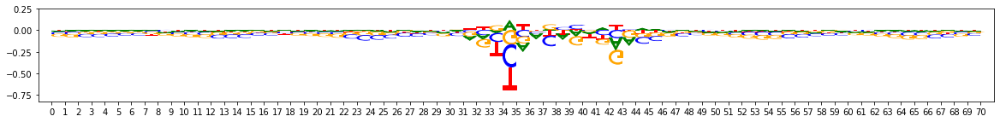

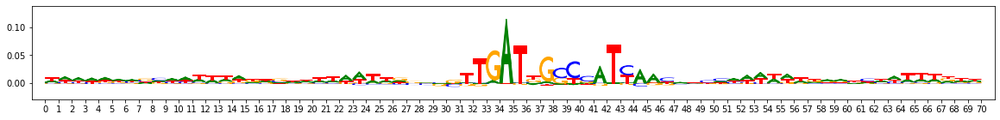

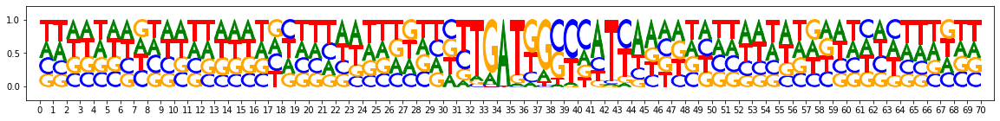

Subcluster: 4 size: 1014


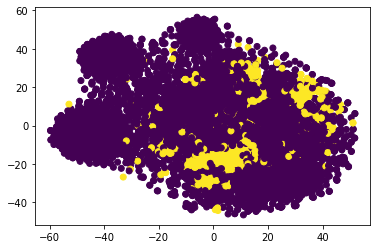

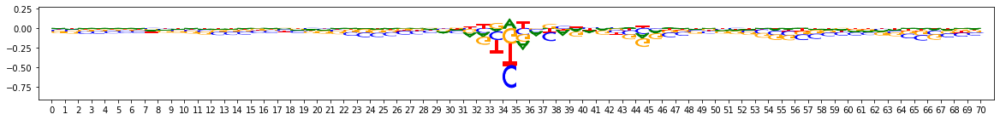

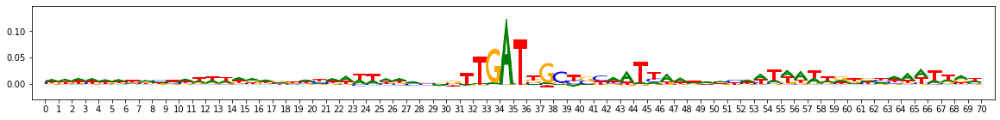

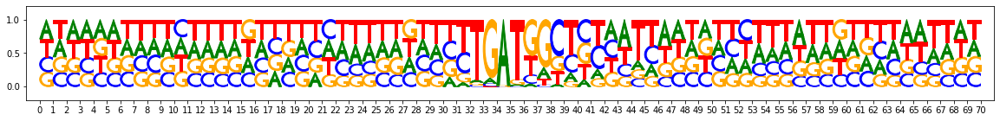

Subcluster: 5 size: 847


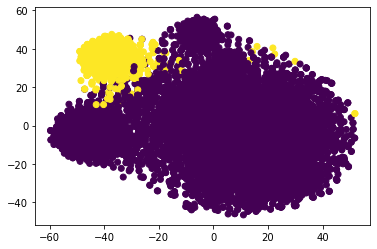

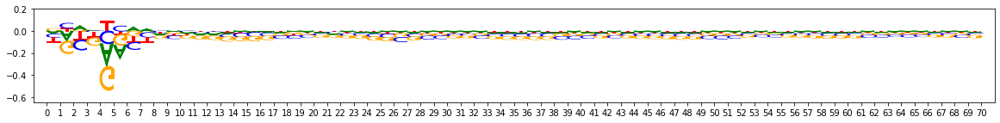

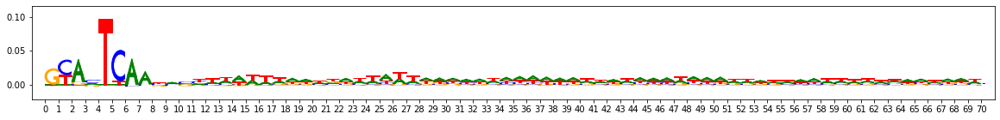

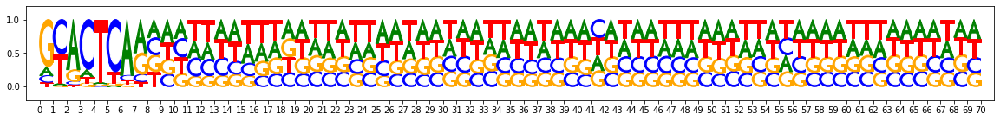

Subcluster: 6 size: 602


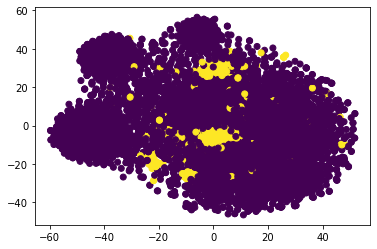

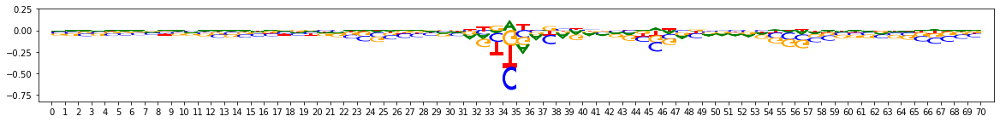

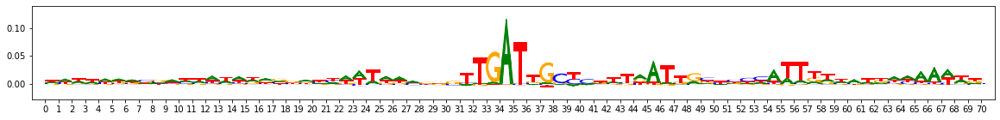

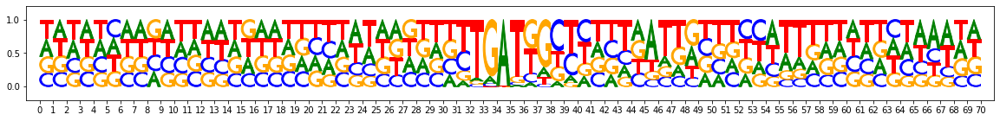

Subcluster: 7 size: 578


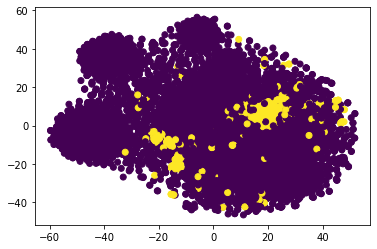

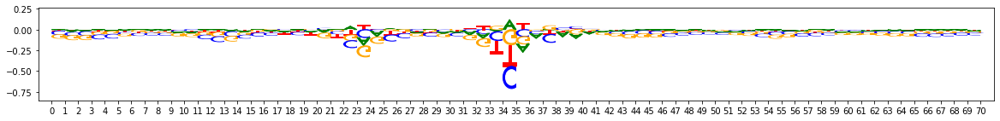

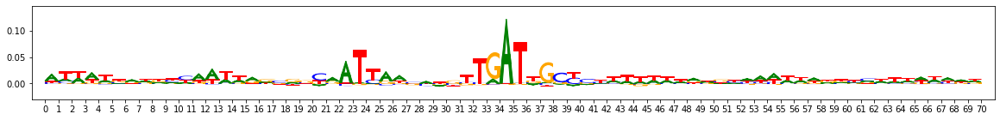

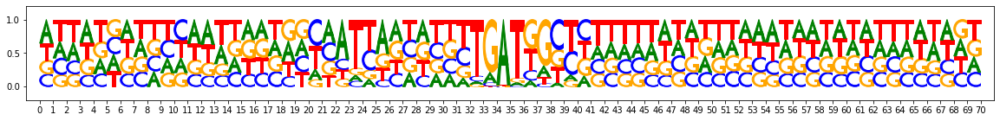

Subcluster: 8 size: 523


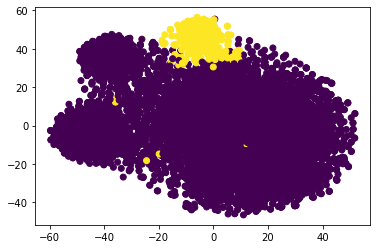

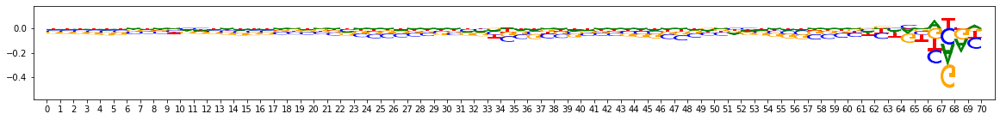

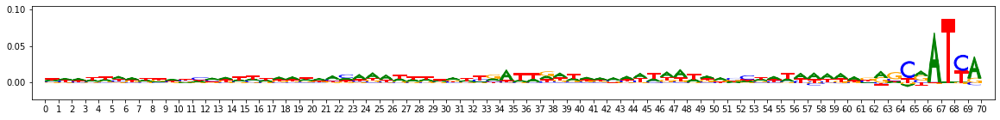

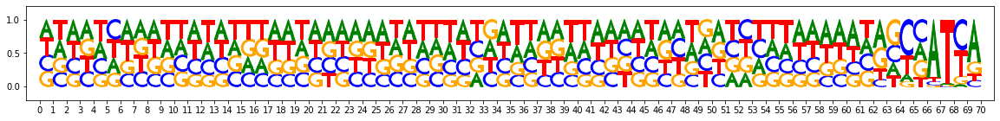

Subcluster: 9 size: 311


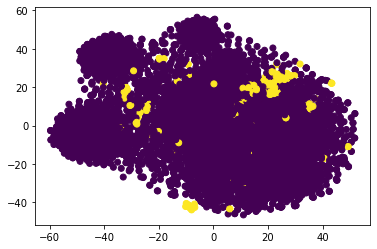

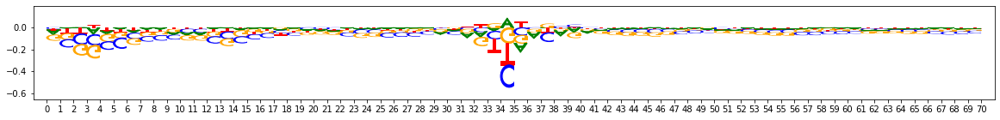

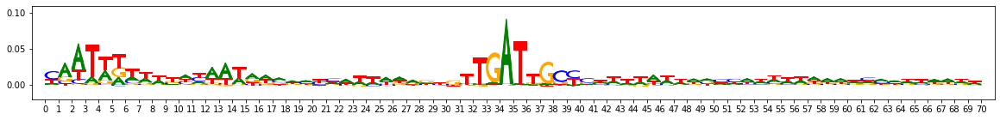

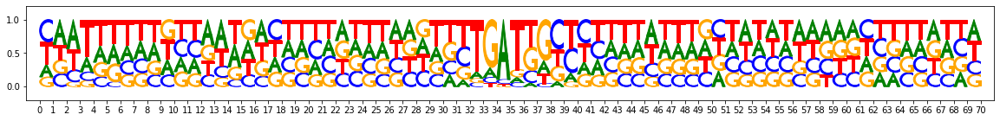

Subcluster: 10 size: 227


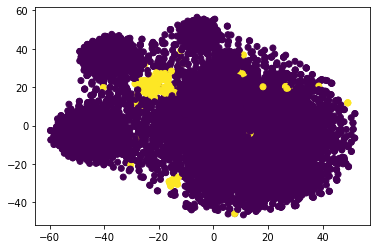

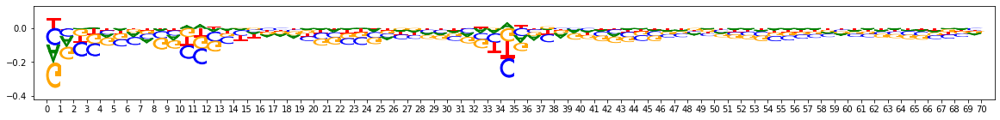

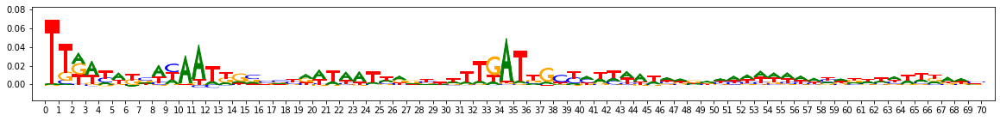

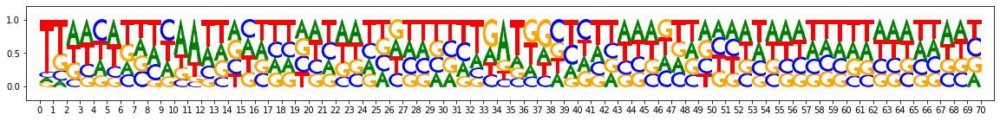

Pattern idx 1
overall - num seqlets: 6683


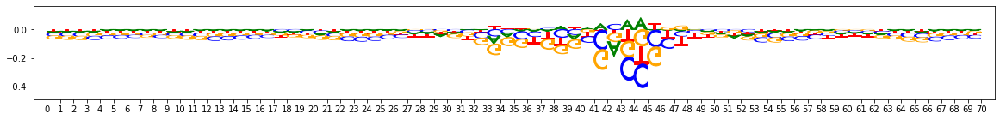

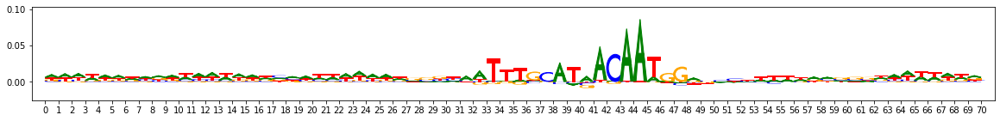

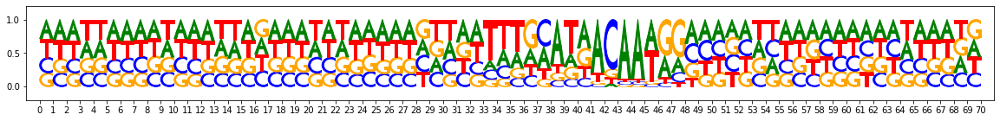

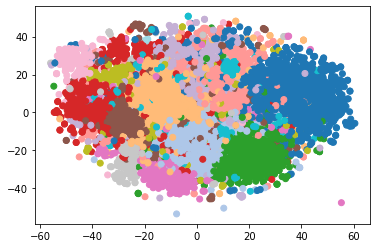

Subcluster: 0 size: 1110


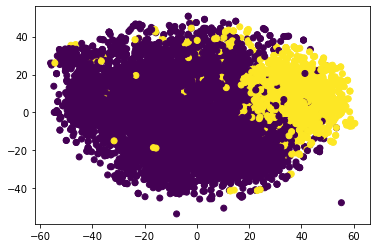

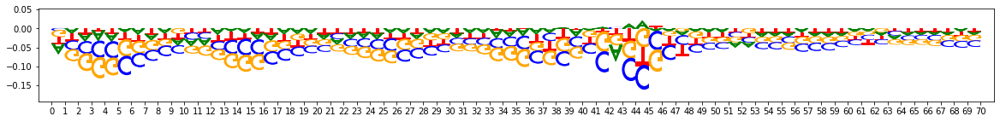

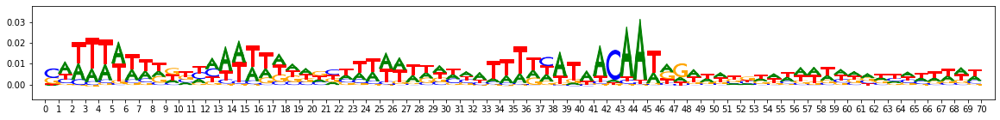

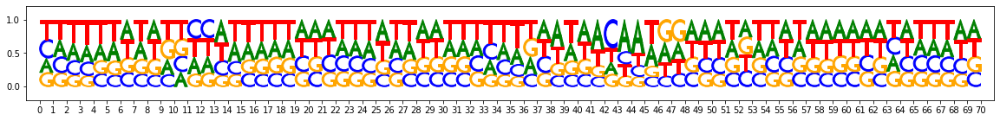

Subcluster: 1 size: 851


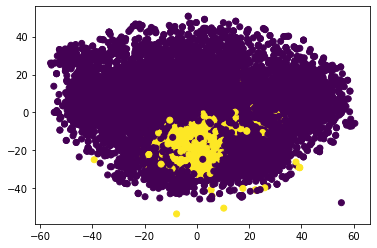

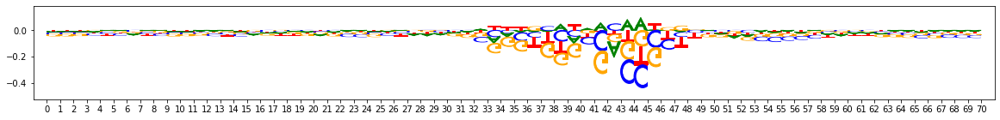

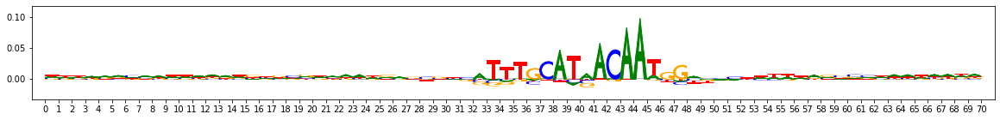

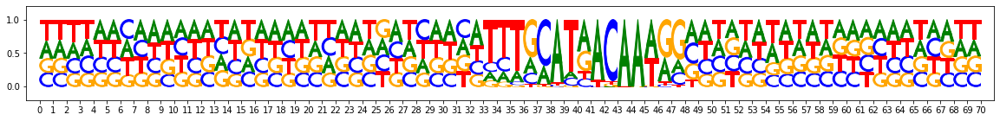

Subcluster: 2 size: 825


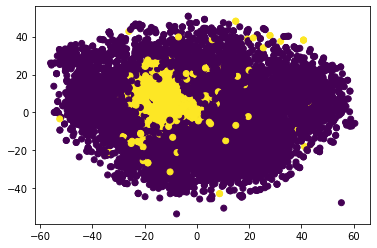

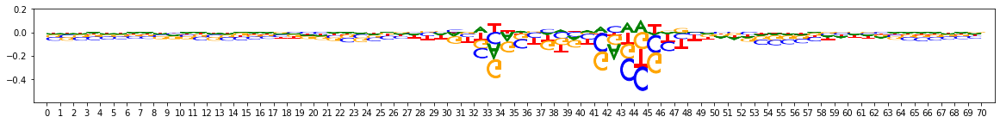

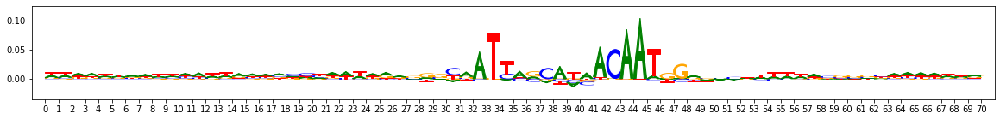

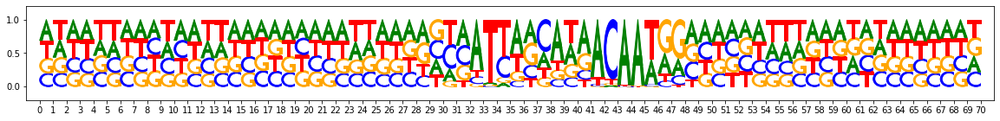

Subcluster: 3 size: 692


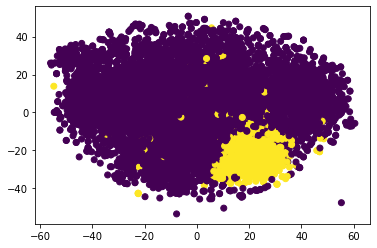

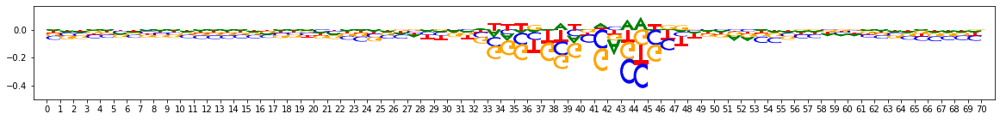

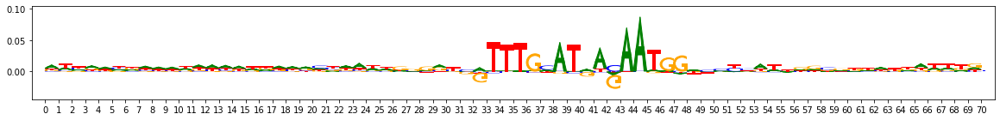

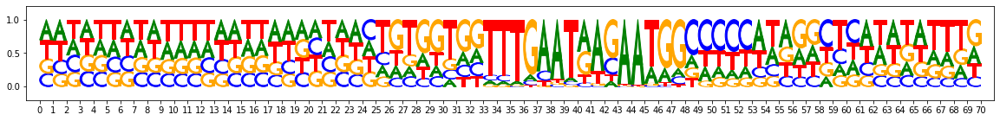

Subcluster: 4 size: 605


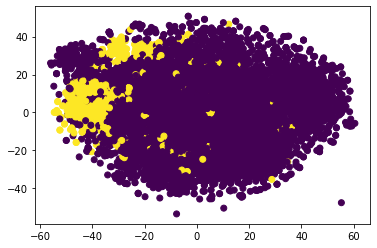

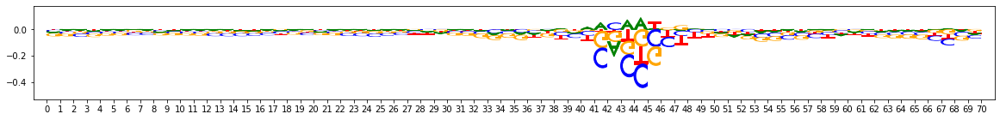

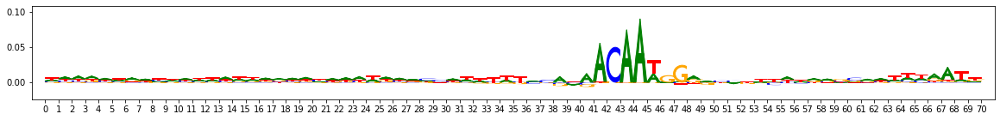

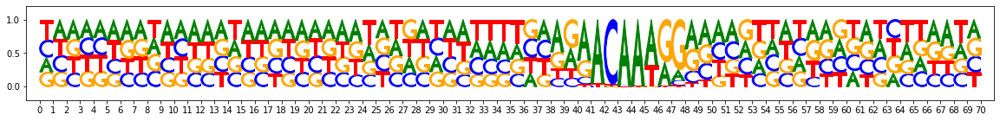

Subcluster: 5 size: 523


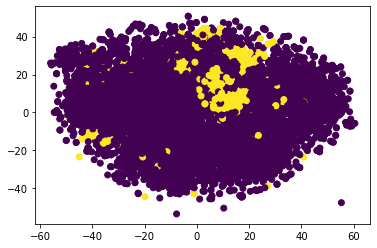

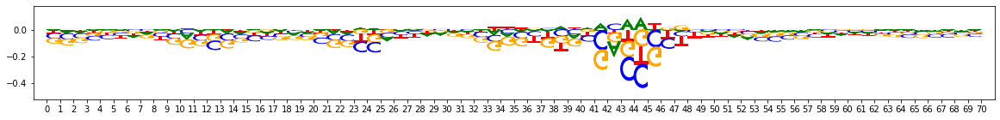

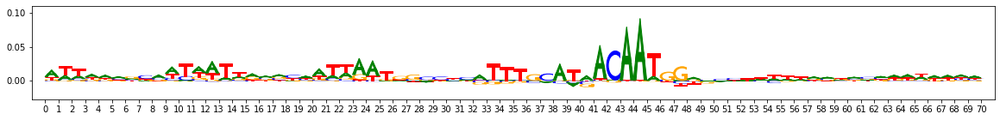

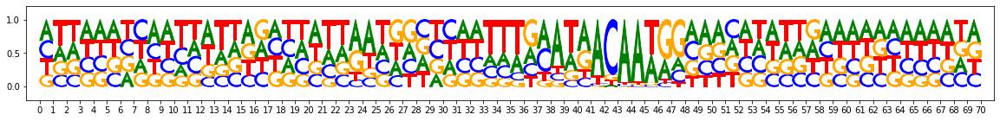

Subcluster: 6 size: 420


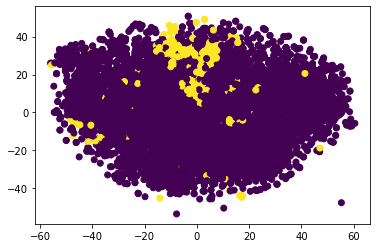

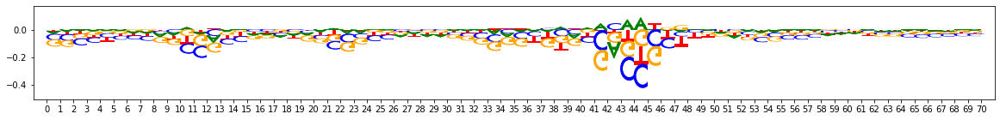

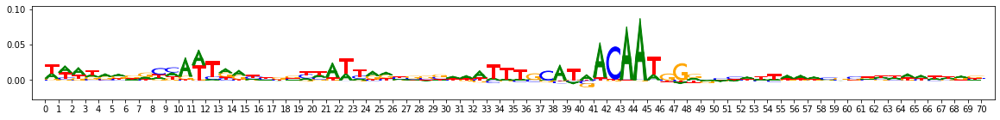

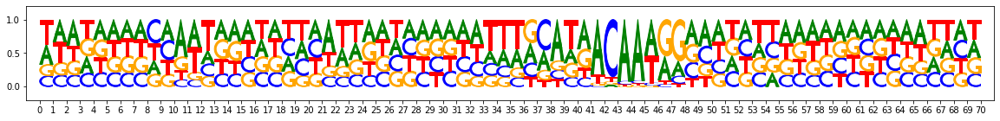

Subcluster: 7 size: 400


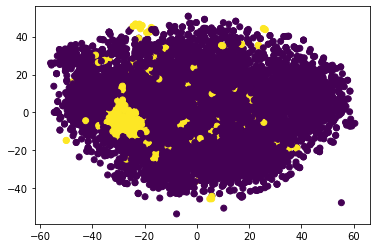

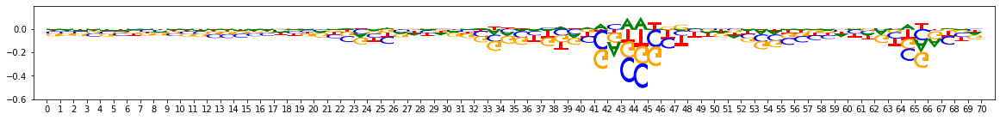

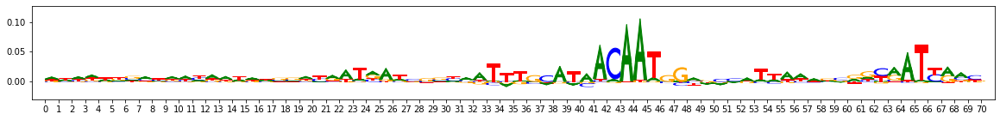

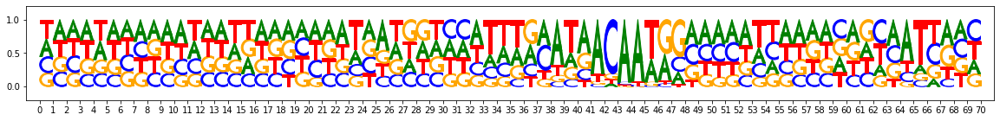

Subcluster: 8 size: 389


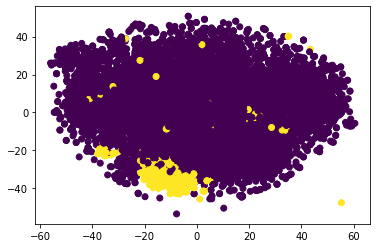

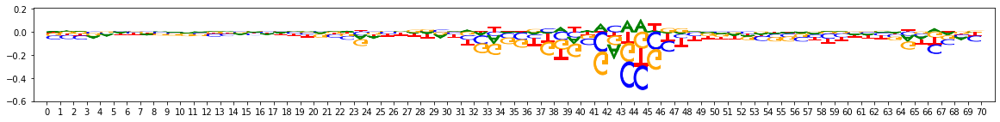

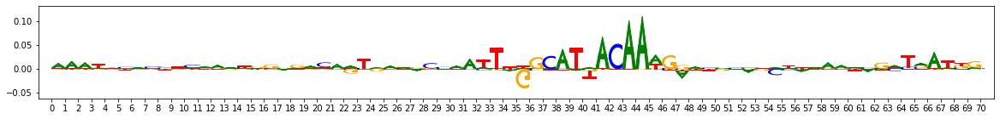

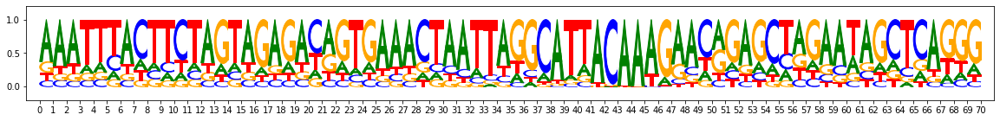

Subcluster: 9 size: 238


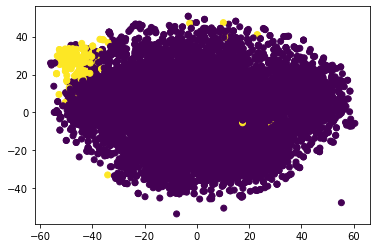

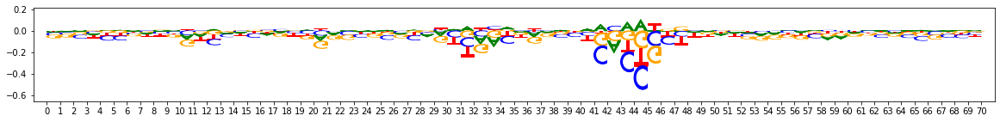

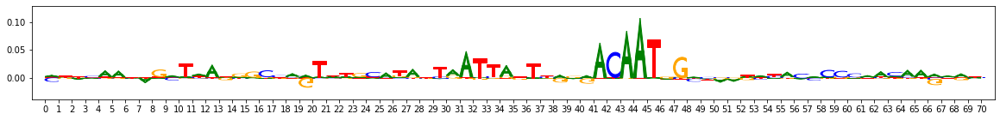

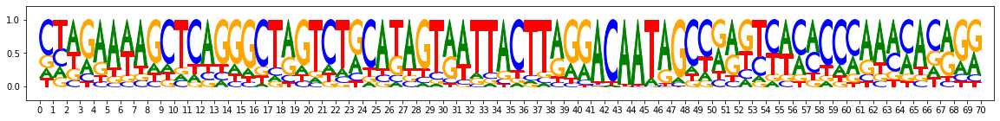

Subcluster: 10 size: 221


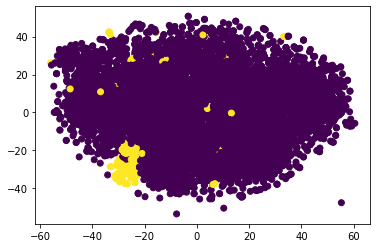

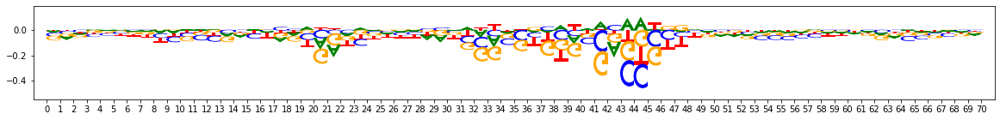

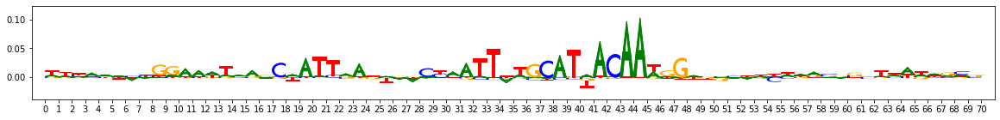

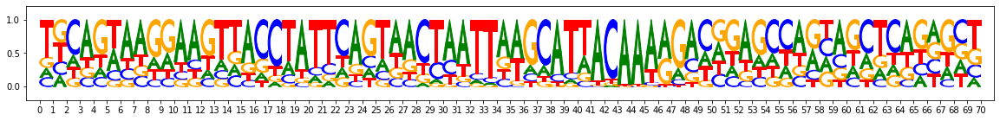

Subcluster: 11 size: 216


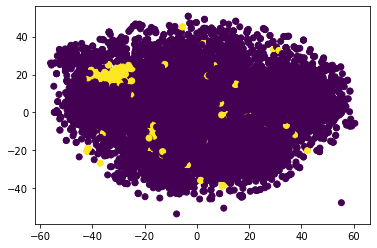

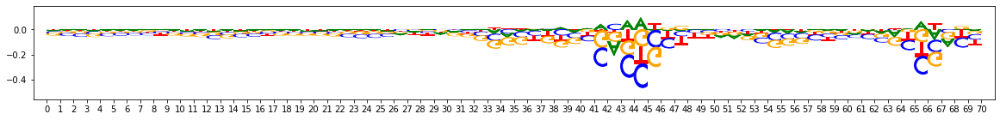

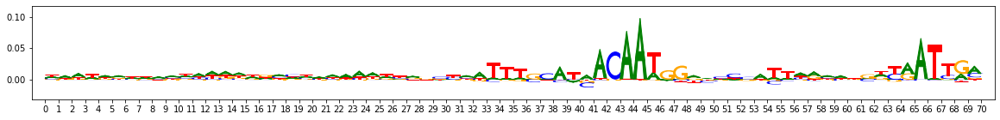

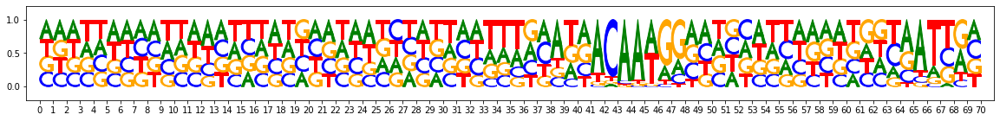

Subcluster: 12 size: 183


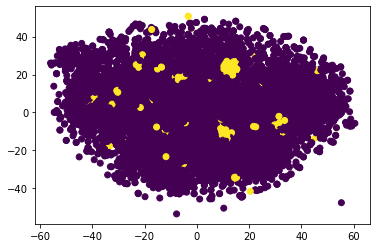

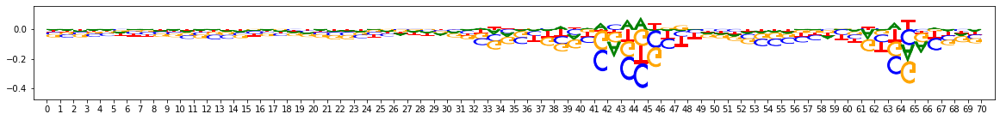

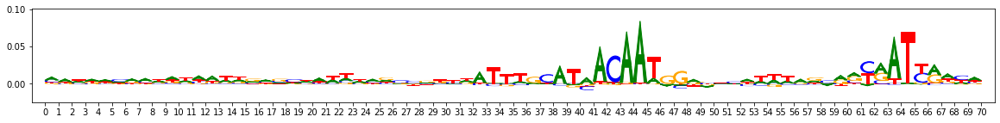

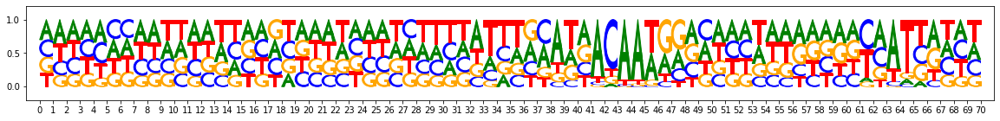

Subcluster: 13 size: 10


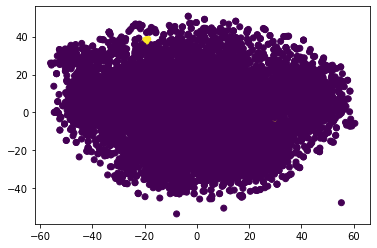

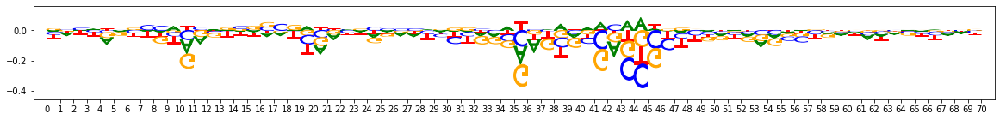

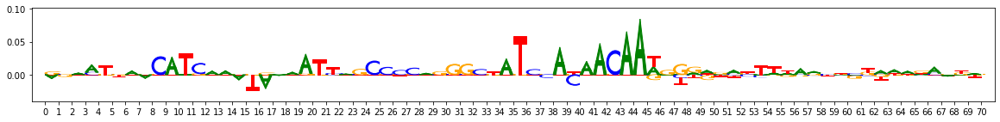

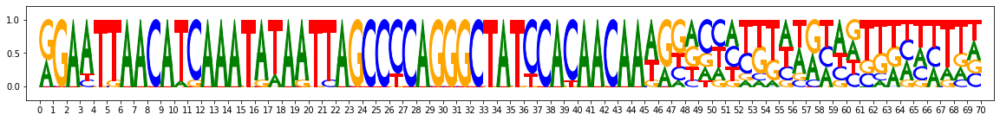

In [31]:
from matplotlib import pyplot as plt

patterns = (loaded_tfmodisco_results
            .metacluster_idx_to_submetacluster_results["metacluster_0"]
            .seqlets_to_patterns_result.patterns)
for patternidx,pattern in enumerate(patterns[:2]):
    print("Pattern idx",patternidx)
    print("overall - num seqlets:",len(pattern.seqlets))
    viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
    viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(pattern["sequence"].fwd)
    subclusters = np.array(pattern.subclusters)
    twod_embedding = np.array(pattern.twod_embedding)
    plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=subclusters, cmap="tab20")
    plt.show()
    for subcluster, subpattern in pattern.subcluster_to_subpattern.items():
        print("Subcluster:",subcluster,"size:",len(subpattern.seqlets))
        plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=(subclusters==subcluster))
        plt.show()
        viz_sequence.plot_weights(subpattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
        viz_sequence.plot_weights(subpattern["Nanog_profile_wn_contrib_scores"].fwd)
        viz_sequence.plot_weights(subpattern["sequence"].fwd)

In [ ]:
def recursive_plot_hierarchy_motifs(nodes, path):
    for i in range(len(nodes)):
        nodepath = path+"/"+str(i)
        print("Path to node:",nodepath)
        print("Number of seqlets",len(nodes[i].pattern.seqlets))
        if (nodes[i].indices_merged is not None):
            #indices_merged, submat_crosscontam and submat_alignersim can
            # be used to inspect the steps in the merging
            print("indices merged:",nodes[i].indices_merged)
            print("submat crosscontam:\n",nodes[i].submat_crosscontam)
            print("submat alignersim:\n",nodes[i].submat_alignersim)
            pass
        
        #For plotting figures to a png, this code can be used...
        #fig = plt.figure(figsize=(20,5))                                           
        #ax = fig.add_subplot(111)
        #viz_sequence.plot_weights_given_ax(ax, nodes[i].pattern["sequence"].fwd)
        #plt.savefig(nodepath+".png")
        
        viz_sequence.plot_weights(nodes[i].pattern["sequence"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern["Nanog_profile_wn_contrib_scores"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
        recursive_plot_hierarchy_motifs(nodes[i].child_nodes, path=nodepath)

print("For metacluster 0")
recursive_plot_hierarchy_motifs(loaded_tfmodisco_results
    .metacluster_idx_to_submetacluster_results["metacluster_0"]
    .seqlets_to_patterns_result.pattern_merge_hierarchy.root_nodes,
    path="root")

In [ ]:
from modisco.visualization import viz_sequence
%matplotlib inline

#before adding merge right after splitting, before merging by min crosscontam
# rather than avg
file_path = "v0.5.14.0.hdf5"
hdf5_results = h5py.File(file_path,"r")

metacluster_names = [
    x.decode("utf-8") for x in 
    list(hdf5_results["metaclustering_results"]
         ["all_metacluster_names"][:])]

all_patterns = []
background = np.array([0.27, 0.23, 0.23, 0.27])

for metacluster_name in metacluster_names:
    print(metacluster_name)
    metacluster_grp = (hdf5_results["metacluster_idx_to_submetacluster_results"]
                                   [metacluster_name])
    print("activity pattern:",metacluster_grp["activity_pattern"][:])
    all_pattern_names = [x.decode("utf-8") for x in 
                         list(metacluster_grp["seqlets_to_patterns_result"]
                                             ["patterns"]["all_pattern_names"][:])]
    if (len(all_pattern_names)==0):
        print("No motifs found for this activity pattern")
    for pattern_name in all_pattern_names:
        print(metacluster_name, pattern_name)
        all_patterns.append((metacluster_name, pattern_name))
        pattern = metacluster_grp["seqlets_to_patterns_result"]["patterns"][pattern_name]
        print("total seqlets:",len(pattern["seqlets_and_alnmts"]["seqlets"]))
        print("Task 0 hypothetical scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"]["fwd"])
        print("Task 0 actual importance scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"]["fwd"])
        print("onehot, fwd and rev:")
        viz_sequence.plot_weights(np.array(pattern["sequence"]["fwd"])) 
        viz_sequence.plot_weights(np.array(pattern["sequence"]["rev"])) 
        
hdf5_results.close()

In [ ]:
import h5py
import numpy as np
from importlib import reload
import modisco
reload(modisco.util)
reload(modisco.core)
reload(modisco.tfmodisco_workflow)
from modisco.tfmodisco_workflow import workflow

track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
    task_names=["Nanog_profile_wn"],
    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
    one_hot=onehot_seq)

grp = h5py.File(file_path,"r")
loaded_tfmodisco_results =\
    workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
grp.close()

In [ ]:
def recursive_plot_hierarchy_motifs(nodes, path):
    for i in range(len(nodes)):
        nodepath = path+"/"+str(i)
        print("Path to node:",nodepath)
        print("Number of seqlets",len(nodes[i].pattern.seqlets))
        if (nodes[i].indices_merged is not None):
            #indices_merged, submat_crosscontam and submat_alignersim can
            # be used to inspect the steps in the merging
            print("indices merged:",nodes[i].indices_merged)
            print("submat crosscontam:\n",nodes[i].submat_crosscontam)
            print("submat alignersim:\n",nodes[i].submat_alignersim)
            pass
        
        #For plotting figures to a png, this code can be used...
        #fig = plt.figure(figsize=(20,5))                                           
        #ax = fig.add_subplot(111)
        #viz_sequence.plot_weights_given_ax(ax, nodes[i].pattern["sequence"].fwd)
        #plt.savefig(nodepath+".png")
        
        viz_sequence.plot_weights(nodes[i].pattern["sequence"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern["Nanog_profile_wn_contrib_scores"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
        recursive_plot_hierarchy_motifs(nodes[i].child_nodes, path=nodepath)

print("For metacluster 0")
recursive_plot_hierarchy_motifs(loaded_tfmodisco_results
    .metacluster_idx_to_submetacluster_results["metacluster_0"]
    .seqlets_to_patterns_result.pattern_merge_hierarchy.root_nodes,
    path="root/0")